**Client Tunnel Peers**

In [ ]:
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os

# Path to your folder with the .txt files
folder_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/Client Tunnel'

# A set to collect unique node IDs
unique_ids = set()

# Loop through all .txt files in the folder
for filename in os.listdir(folder_path):
    if filename.endswith('.txt'):
        file_path = os.path.join(folder_path, filename)
        with open(file_path, 'r') as file:
            for line in file:
                node_id = line.strip()
                if node_id:
                    unique_ids.add(node_id)

print(f"Total unique node IDs collected so far: {len(unique_ids)}")


Total unique node IDs collected so far: 340


In [ ]:
import os

# Path to your folder with the .txt files
folder_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/Client Tunnel'

# Set to store unique node IDs
unique_ids = set()

# Loop through all .txt files in the folder
for filename in os.listdir(folder_path):
    if filename.endswith('.txt'):
        file_path = os.path.join(folder_path, filename)
        with open(file_path, 'r') as file:
            for line in file:
                node_id = line.strip()
                if node_id:
                    unique_ids.add(node_id)

# Total count
print(f"\n✅ Total unique I2P node IDs: {len(unique_ids)}\n")

# Display all unique node IDs
for node in sorted(unique_ids):
    print(node)



✅ Total unique I2P node IDs: 340

-B5GEl1mD44~bsHAl3Yuxs~-KBF7KOtdRMEXTiZ~3gM=
-NRskdDzURAH4kCp50fjwwtcjNK8pXWCLuqAGcFvdo8=
-W5RzvA~Kq6tI-v~Rdj9werGOTbZaz~w7PrANz7Nmbk=
-Wl3YSmSpHw1BISUCub0FIcMcGBhCMBfEbaqQ6BFdRE=
-e0SW5rDvxh2vRCfJNNAUGBy8gYaS-s8Sxze7uFHjkE=
-jTq2LE8M--WVWLljc2VpEfmfQKsirPUK68yhI7sMJg=
-qORpM-cceEgQxY4-rH~EL-pquTSsCEWL45ov-EjdbY=
-z7AotxWVa1JuAyGvFaA2IRRW8CLT~rDaYQwn0Sct9o=
0YXGqtetOYFFYL9buX2LuM6bU~AbUK1eBQILYu0SEQ4=
0hL4M-G1rY1YXfQHPcGKL7YMexvtYVGhaoyLEz1IJk4=
18m1klKCL~SzXYX2~klDhThQn8IoISkejSL1zXmn46Q=
1Peq7stwdUUHFDgPUQmR-klR4z9aFTVIrSnz8t2czeo=
1of7m4oJYjbCyiGHIYZ5W8SIDI-ifvYsYo1lLJG22I0=
1ouX3BNNFji-xi3S5YNWzMSpMfIOSyWbo3qJQG6PX48=
1raAFupalt1-5x8W9gXdcXlxBiM35C8ff1wMYFrDVqw=
20ew87-uMcKNq3KFJSHqESqN5tivjtiJ301HHqzljZk=
21DPL5IIpc6ItE82SuqWBrdVOrvRHIxemfXiNoNXV-U=
2JOwGieYMNmDx1vxINoDgpsZcQZsFkp7XfEhwewT-Cg=
2WXP6--a1U1bwANV8qtrXnCXkdhgbh1Y7z-7niGr5lg=
2jxUhTAgPkipgT4ISECMtegUeq4RVQ0gBsMHgpopohc=
3NeVP8HTbSPQuu-U3EVT7Jg5hclmFTZLuPowu1uiTl0=
3TzNL3~Bx7rFbhhj0jf4

In [ ]:
# Output file path
output_path = '/content/drive/MyDrive/unique_client_tunnel_ids.txt'

# Save unique node IDs to the output file
with open(output_path, 'w') as output_file:
    for node_id in sorted(unique_ids):
        output_file.write(node_id + '\n')

print(f"✅ Merged file created at: {output_path}")
print(f"Total unique client tunnel node IDs saved: {len(unique_ids)}")


✅ Merged file created at: /content/drive/MyDrive/unique_client_tunnel_ids.txt
Total unique client tunnel node IDs saved: 340


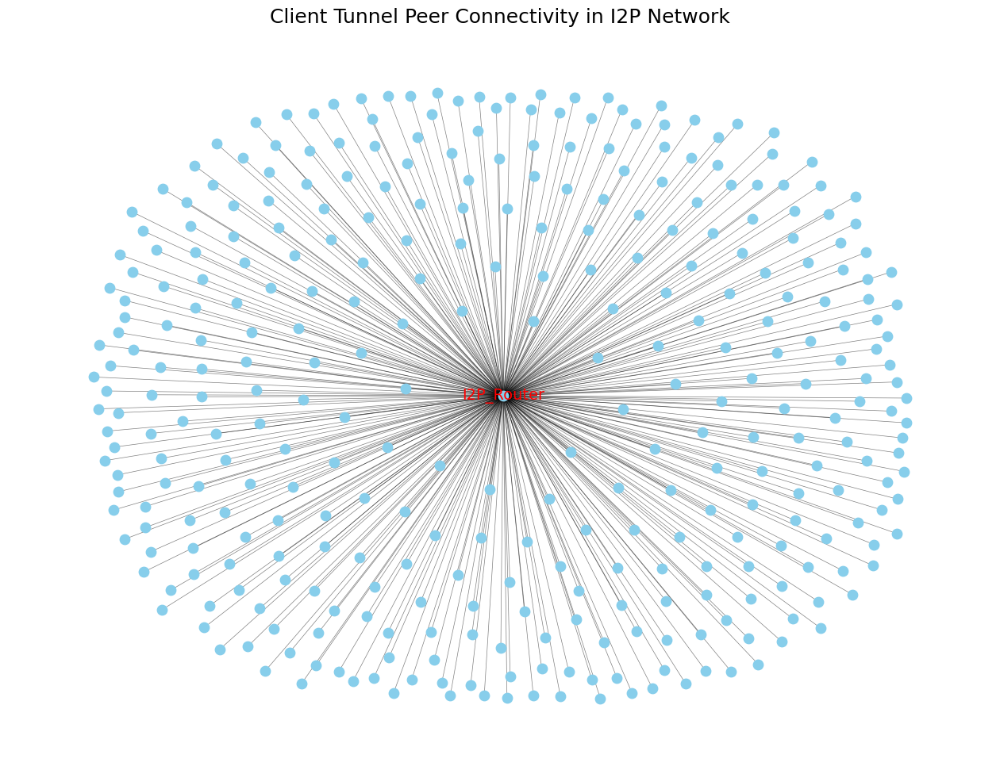

In [ ]:
import matplotlib.pyplot as plt
import networkx as nx

# Create a graph
G = nx.Graph()

# Central node (your I2P router)
central_router = "I2P_Router"
G.add_node(central_router)

# Add edges from central router to each client tunnel peer
for node_id in sorted(unique_ids):
    G.add_node(node_id)
    G.add_edge(central_router, node_id)

# Draw the graph
plt.figure(figsize=(16, 12))
pos = nx.spring_layout(G, k=0.25, iterations=20)
nx.draw_networkx_nodes(G, pos, node_size=80, node_color='skyblue')
nx.draw_networkx_edges(G, pos, width=0.5, alpha=0.5)
nx.draw_networkx_labels(G, pos, {central_router: central_router}, font_size=14, font_color='red')

plt.title("Client Tunnel Peer Connectivity in I2P Network", fontsize=18)
plt.axis('off')
plt.show()


In [ ]:
# Install packages if not already installed
!pip install matplotlib numpy


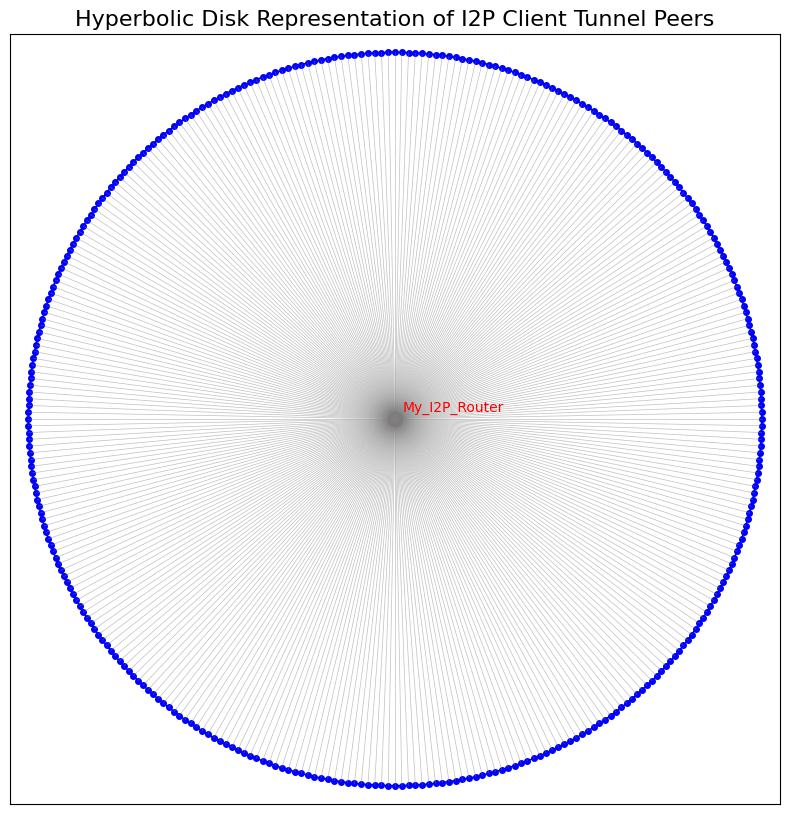

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Convert the unique_ids set to a sorted list for consistent placement
peer_ids = sorted(unique_ids)
total_peers = len(peer_ids)

# Set up the Poincaré disk
fig, ax = plt.subplots(figsize=(10, 10))
ax.set_xlim(-1.05, 1.05)
ax.set_ylim(-1.05, 1.05)
ax.set_aspect('equal')
ax.set_title("Hyperbolic Disk Representation of I2P Client Tunnel Peers", fontsize=16)

# Draw disk boundary
circle = plt.Circle((0, 0), 1, color='black', fill=False, linewidth=1)
ax.add_artist(circle)

# Central node: your I2P router at origin
ax.plot(0, 0, 'ro', markersize=10)
ax.text(0.02, 0.02, "My_I2P_Router", fontsize=10, color='red')

# Place each peer around the disk using polar coordinates
angles = np.linspace(0, 2*np.pi, total_peers, endpoint=False)

for i, angle in enumerate(angles):
    # Place node on boundary
    x = np.cos(angle)
    y = np.sin(angle)

    # Draw the peer as a small dot
    ax.plot(x, y, 'bo', markersize=4)

    # Draw line from center to peer (simulate tunnel connection)
    ax.plot([0, x], [0, y], 'gray', linewidth=0.5, alpha=0.5)

# Hide axis ticks
ax.set_xticks([])
ax.set_yticks([])

plt.show()


<ipython-input-8-d5ff30fe67ff>:43: UserWarning: Glyph 127760 (\N{GLOBE WITH MERIDIANS}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 127760 (\N{GLOBE WITH MERIDIANS}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


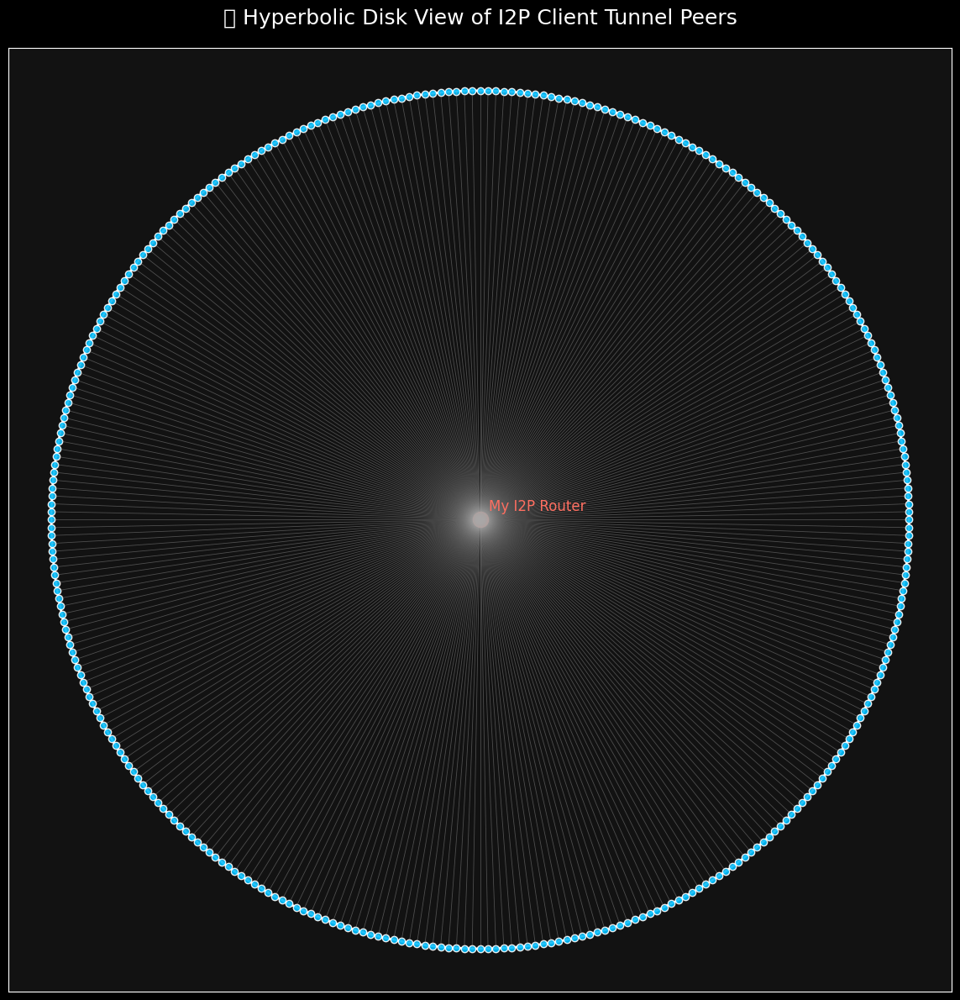

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Use dark background for a strong look
plt.style.use('dark_background')

# Prepare data
peer_ids = sorted(unique_ids)
total_peers = len(peer_ids)
angles = np.linspace(0, 2 * np.pi, total_peers, endpoint=False)

# Create figure and axis
fig, ax = plt.subplots(figsize=(12, 12))
ax.set_xlim(-1.1, 1.1)
ax.set_ylim(-1.1, 1.1)
ax.set_aspect('equal')
ax.set_title("🌐 Hyperbolic Disk View of I2P Client Tunnel Peers", fontsize=18, color='white', pad=20)

# Draw Poincaré disk boundary
boundary = plt.Circle((0, 0), 1, color='white', fill=False, linewidth=2)
ax.add_artist(boundary)

# Draw central router node
ax.plot(0, 0, 'o', markersize=12, color='#FF6F61', markeredgewidth=2)
ax.text(0.02, 0.02, "My I2P Router", fontsize=12, color='#FF6F61')

# Place peers on disk boundary and draw connections
for i, angle in enumerate(angles):
    x = np.cos(angle)
    y = np.sin(angle)

    # Node (peer) appearance
    ax.plot(x, y, 'o', markersize=6, color='#00BFFF', alpha=0.9, markeredgecolor='white')

    # Line from center to peer (connection)
    ax.plot([0, x], [0, y], color='#A9A9A9', linewidth=0.6, alpha=0.4)

# Remove ticks and frame
ax.set_xticks([])
ax.set_yticks([])
ax.set_facecolor("#121212")  # deep dark background

plt.tight_layout()
plt.show()


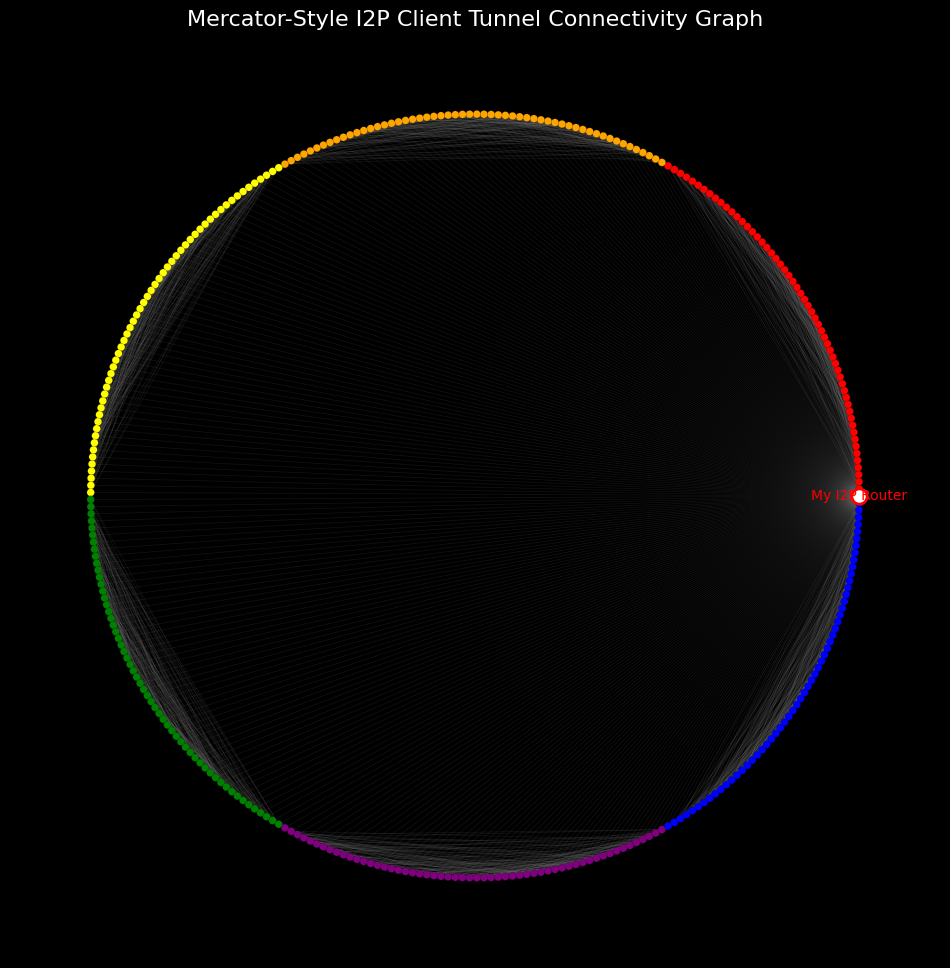

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import random

# Simulate connections: connect your central router to all peers, and some peers to others
G = nx.Graph()
central_router = "My_I2P_Router"
G.add_node(central_router)

peer_ids = sorted(unique_ids)
total_peers = len(peer_ids)

# Simulate node groups (clusters)
num_clusters = 6
cluster_size = total_peers // num_clusters
clusters = [peer_ids[i * cluster_size:(i + 1) * cluster_size] for i in range(num_clusters)]

# Assign colors to clusters
colors = ['red', 'orange', 'yellow', 'green', 'purple', 'blue']
node_colors = {}

# Build graph with cluster-based connectivity
for i, cluster in enumerate(clusters):
    for node in cluster:
        G.add_node(node)
        G.add_edge(central_router, node)  # connect to central router
        node_colors[node] = colors[i]

        # Add some intra-cluster edges
        intra_peers = random.sample(cluster, min(5, len(cluster)))
        for peer in intra_peers:
            if node != peer:
                G.add_edge(node, peer)

# Radial layout (Mercator-style mimic)
layout = nx.circular_layout(G)

# Draw the graph
plt.figure(figsize=(12, 12))
edges = nx.draw_networkx_edges(G, layout, alpha=0.15, edge_color='gray', width=0.5)
nodes = nx.draw_networkx_nodes(
    G, layout,
    node_size=30,
    node_color=[node_colors.get(node, 'white') for node in G.nodes()],
    edgecolors='black',
    linewidths=0.1
)

# Draw central router with a unique style
nx.draw_networkx_nodes(G, layout, nodelist=[central_router], node_color='white', node_size=120, edgecolors='red', linewidths=2)
nx.draw_networkx_labels(G, layout, labels={central_router: "My I2P Router"}, font_size=10, font_color='red')

plt.title("Mercator-Style I2P Client Tunnel Connectivity Graph", fontsize=16)
plt.axis('off')
plt.show()


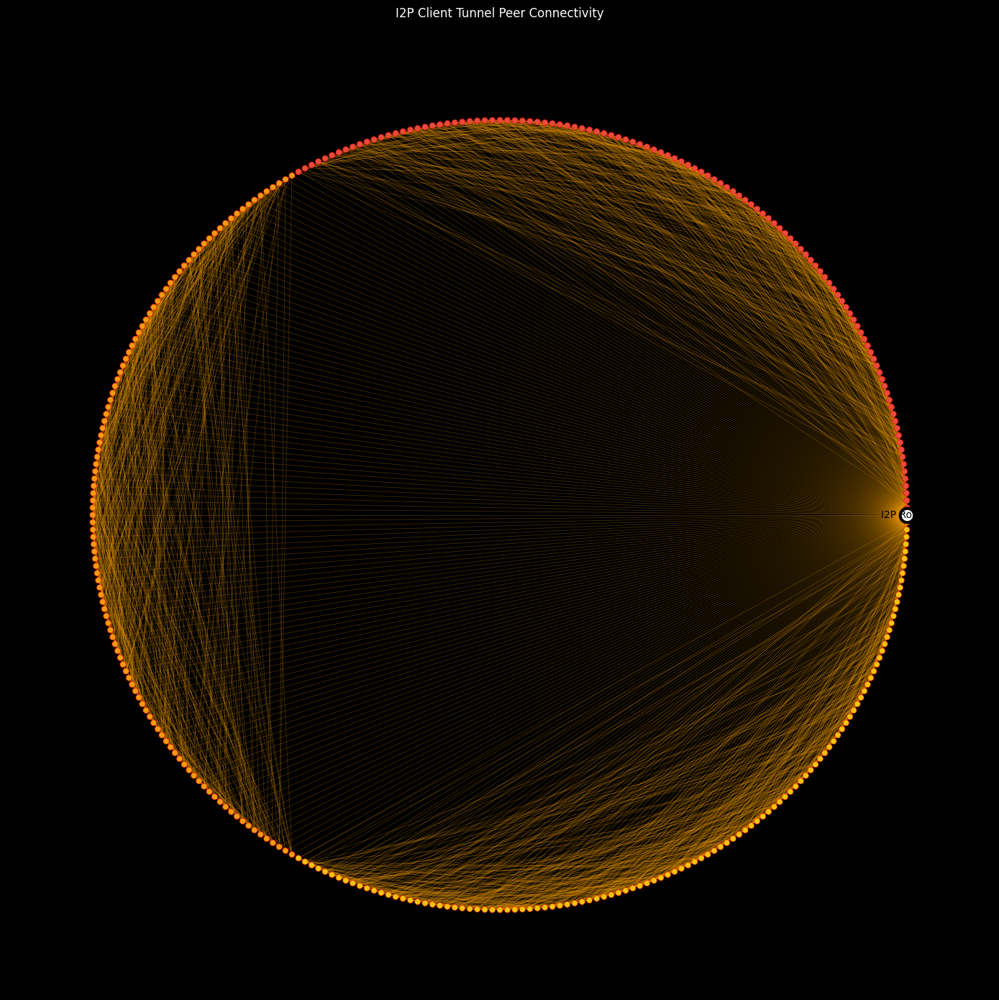

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import random

# Set random seed for reproducibility
random.seed(30)

# Build graph
G = nx.Graph()
central_router = "I2P_Router"
G.add_node(central_router)

peer_ids = sorted(unique_ids)
total_peers = len(peer_ids)

# Simulate clusters
num_clusters = 3
cluster_size = total_peers // num_clusters
clusters = [peer_ids[i * cluster_size:(i + 1) * cluster_size] for i in range(num_clusters)]

# Define vibrant cluster colors
colors = ['#E74C3C', '#F39C12', '#F1C40F', '#2ECC71', '#9B59B6', '#3498DB']
node_colors = {}

# Add nodes and edges
for i, cluster in enumerate(clusters):
    for node in cluster:
        G.add_node(node)
        G.add_edge(central_router, node)  # edge to router
        node_colors[node] = colors[i]

        # Simulate intra-cluster edges
        intra_peers = random.sample(cluster, min(5, len(cluster)))
        for peer in intra_peers:
            if node != peer:
                G.add_edge(node, peer)

# Circular layout
layout = nx.circular_layout(G)

# Plot
plt.figure(figsize=(14, 14))
plt.axis('off')
plt.title("I2P Client Tunnel Peer Connectivity", fontsize=12, pad=20)

# Draw edges with better visibility
nx.draw_networkx_edges(G, layout, width=0.5, alpha=0.3, edge_color='orange')

# Draw colored nodes
nx.draw_networkx_nodes(
    G, layout,
    node_size=35,
    node_color=[node_colors.get(node, '#CCCCCC') for node in G.nodes()],
    edgecolors='red',
    linewidths=0.4
)

# Central node highlight
nx.draw_networkx_nodes(
    G, layout,
    nodelist=[central_router],
    node_size=200,
    node_color='white',
    edgecolors='black',
    linewidths=3
)

# Label central router
nx.draw_networkx_labels(G, layout, labels={central_router: "I2P Router"}, font_size=10, font_color='black')

plt.tight_layout()
plt.show()


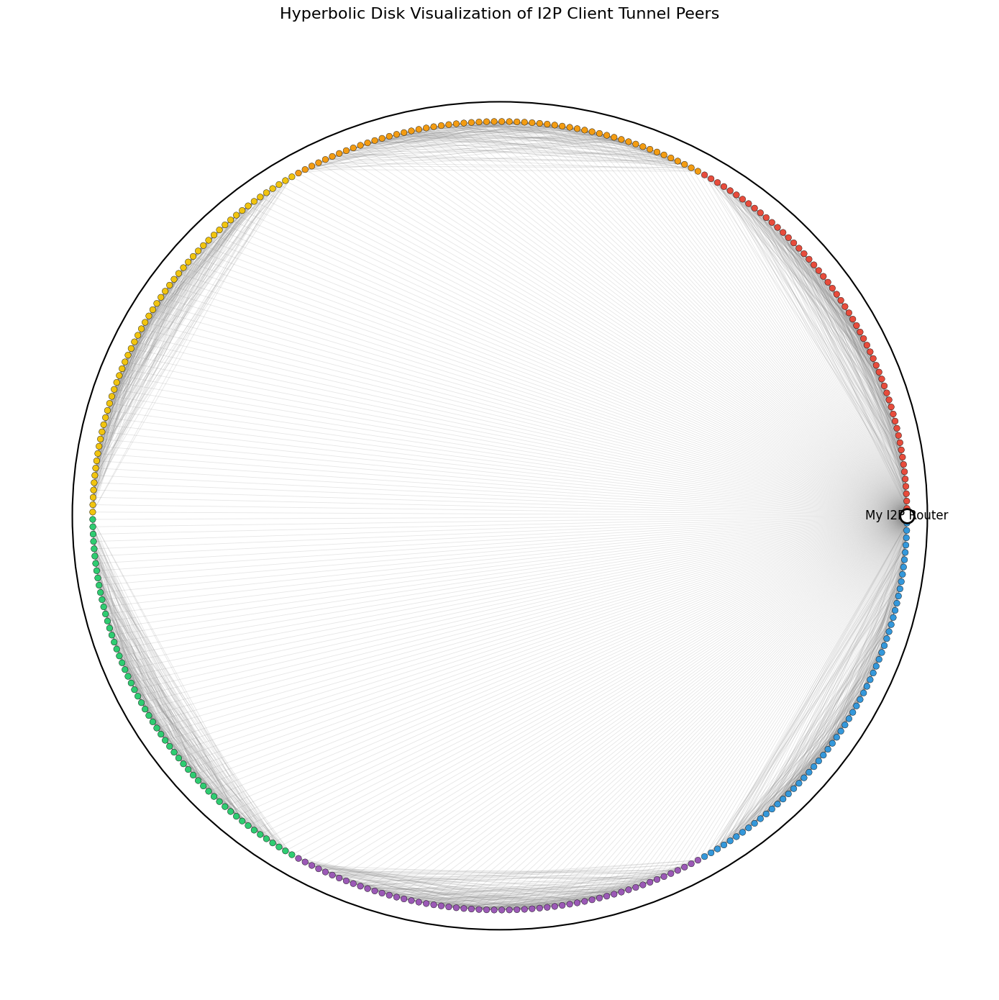

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import random

# For reproducibility
random.seed(42)

# Create the graph
G = nx.Graph()
central_router = "My_I2P_Router"
G.add_node(central_router)

peer_ids = sorted(unique_ids)
total_peers = len(peer_ids)

# Simulated clusters
num_clusters = 6
cluster_size = total_peers // num_clusters
clusters = [peer_ids[i * cluster_size:(i + 1) * cluster_size] for i in range(num_clusters)]

# Rich vibrant colors for clusters
colors = ['#E74C3C', '#F39C12', '#F1C40F', '#2ECC71', '#9B59B6', '#3498DB']
node_colors = {}

# Add edges from central router + intra-cluster
for i, cluster in enumerate(clusters):
    for node in cluster:
        G.add_node(node)
        G.add_edge(central_router, node)
        node_colors[node] = colors[i]
        intra_peers = random.sample(cluster, min(5, len(cluster)))
        for peer in intra_peers:
            if node != peer:
                G.add_edge(node, peer)

# Circular layout (hyperbolic-style)
layout = nx.circular_layout(G)

# Start plotting with white background
fig, ax = plt.subplots(figsize=(14, 14), facecolor='white')
ax.set_facecolor('white')
plt.axis('off')

# Optional: circular grid disk boundary like Mercator
circle = plt.Circle((0, 0), 1.05, color='black', fill=False, linestyle='-', linewidth=1.5)
ax.add_artist(circle)

# Draw edges
nx.draw_networkx_edges(G, layout, width=0.6, alpha=0.2, edge_color='gray', ax=ax)

# Draw colored nodes
nx.draw_networkx_nodes(
    G, layout,
    node_size=38,
    node_color=[node_colors.get(n, 'gray') for n in G.nodes()],
    edgecolors='black',
    linewidths=0.3,
    ax=ax
)

# Central router styling
nx.draw_networkx_nodes(
    G, layout,
    nodelist=[central_router],
    node_size=200,
    node_color='white',
    edgecolors='black',
    linewidths=2,
    ax=ax
)

# Label central router
nx.draw_networkx_labels(G, layout, labels={central_router: "My I2P Router"}, font_size=12, font_color='black', ax=ax)

plt.title("Hyperbolic Disk Visualization of I2P Client Tunnel Peers", fontsize=16, color='black', pad=20)
plt.tight_layout()
plt.show()


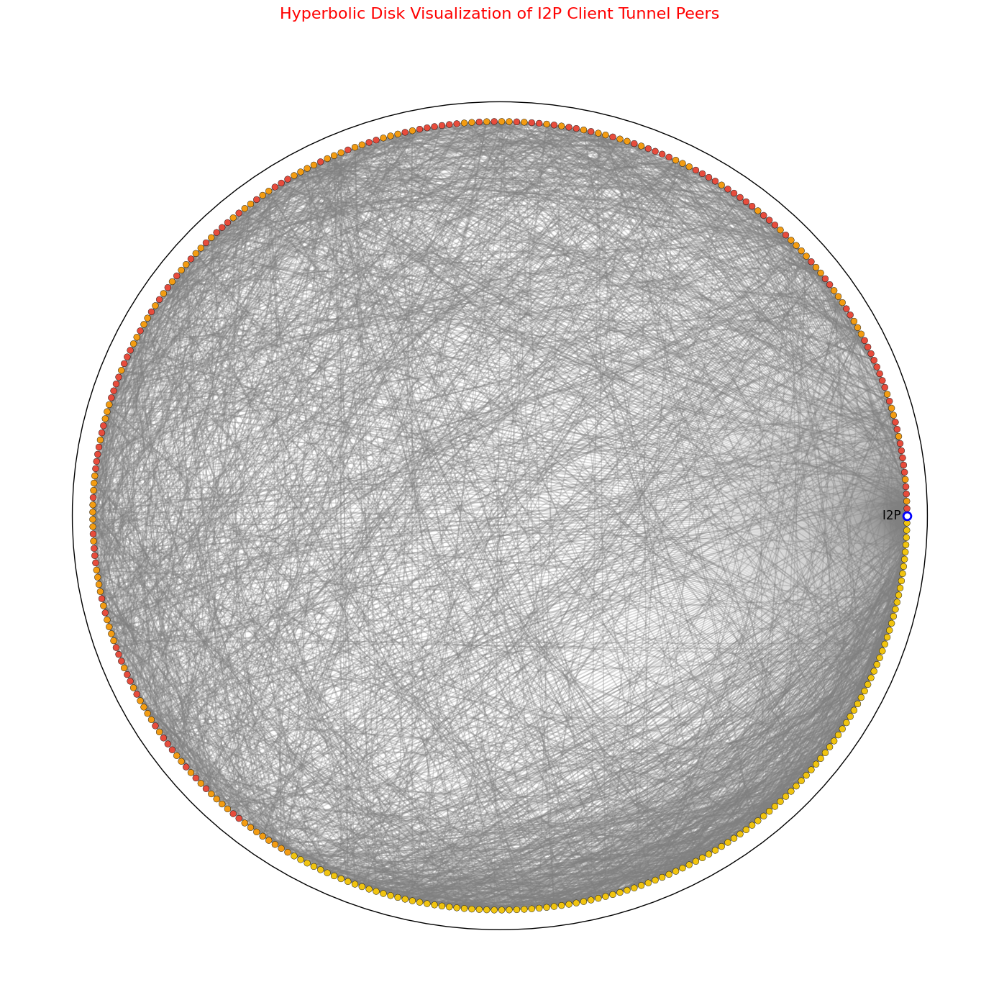

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import random

# Reproducible random
random.seed(42)

# Create the graph
G = nx.Graph()
central_router = "I2P"
G.add_node(central_router)

peer_ids = sorted(unique_ids)
total_peers = len(peer_ids)

# Cluster simulation
num_clusters = 3
cluster_size = total_peers // num_clusters
clusters = [peer_ids[i * cluster_size:(i + 2) * cluster_size] for i in range(num_clusters)]

# Color palette
colors = ['#E74C3C', '#F39C12', '#F1C40F', '#2ECC71', '#9B59B6', '#3498DB']
node_colors = {}

# Add nodes and edges
for i, cluster in enumerate(clusters):
    for node in cluster:
        G.add_node(node)
        G.add_edge(central_router, node)
        node_colors[node] = colors[i]
        intra_peers = random.sample(cluster, min(5, len(cluster)))
        for peer in intra_peers:
            if node != peer:
                G.add_edge(node, peer)

# Layout
layout = nx.circular_layout(G)

# Plot setup
fig, ax = plt.subplots(figsize=(14, 14), facecolor='white')
ax.set_facecolor('white')
plt.axis('off')

# Draw boundary
circle = plt.Circle((0, 0), 1.05, color='black', fill=False, linestyle='-', linewidth=1.0)
ax.add_artist(circle)

# Thicker and clearer edges
nx.draw_networkx_edges(
    G, layout,
    width=1.2,
    alpha=0.3,
    edge_color='gray',
    ax=ax
)

# Nodes
nx.draw_networkx_nodes(
    G, layout,
    node_size=40,
    node_color=[node_colors.get(n, 'gray') for n in G.nodes()],
    edgecolors='black',
    linewidths=0.3,
    ax=ax
)

# Central router node
nx.draw_networkx_nodes(
    G, layout,
    nodelist=[central_router],
    node_size=60,
    node_color='white',
    edgecolors='blue',
    linewidths=2,
    ax=ax
)

# Label
nx.draw_networkx_labels(
    G, layout,
    labels={central_router: "I2P        "},
    font_size=12,
    font_color='black',
    ax=ax
)

plt.title("Hyperbolic Disk Visualization of I2P Client Tunnel Peers", fontsize=16, color='red', pad=20)
plt.tight_layout()
plt.show()


In [ ]:
from collections import defaultdict
import os

# Path to your raw data folder
folder_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/Client Tunnel'

# Dictionary to store frequency
peer_frequency = defaultdict(int)

# Scan each .txt file and count
for filename in os.listdir(folder_path):
    if filename.endswith('.txt'):
        file_path = os.path.join(folder_path, filename)
        with open(file_path, 'r') as f:
            for line in f:
                peer_id = line.strip()
                if peer_id:
                    peer_frequency[peer_id] += 1

# Convert to sorted list by frequency
sorted_peers = sorted(peer_frequency.items(), key=lambda x: x[1], reverse=True)

# Show top N frequently appearing peers
print(f"✅ Total unique peers: {len(sorted_peers)}")
print("\n📊 Top 20 most frequent peers:\n")
for peer, freq in sorted_peers[:20]:
    print(f"{peer} → {freq} times")


✅ Total unique peers: 340

📊 Top 20 most frequent peers:

HIDeUCYfKkwcUbi4IyppaHxqFQZv6ohC3bP56jFhs0Q= → 10 times
z9DJ6FjlV85pWOZGn26PP5tcGzDlWQqLkhuhh7CsIdA= → 8 times
j7Di1coM5mnR4L43hI3~szzAUxKJZsu2fup8bNX3CaA= → 7 times
X9HFLg4WWC6prjzNKrp22BKdk6bNZNkML8PyMBYLIyg= → 7 times
J5tHSxlZHQRMuxVPDSSph6hpsI1e6UfryG1hIQ496Sg= → 7 times
eBnFuKuJjndT-aY9xdWtXu8I7fPZkYZCGg1UsuCnoPk= → 7 times
IcTDuaUuHQDzwOfXSHqWVoDt-Vy~3hpRI628gzdgHtE= → 7 times
nv-0BZIoVlIYB6AnVUvhPk0JmZIn11mH~4Q~DPQ6xxA= → 6 times
moCfkmqXPxMoXWtIWMndXifKaTS5j-AK-g3NeI5J1HA= → 6 times
Ci-7Il1~uxKpzGawwiRyTsyJwLU~9w0eSh-FhUHT7ko= → 6 times
xOFSJ8RS-bpAG7gLBlUTQZkuqnQiEWaxV02T8J6NbZQ= → 6 times
2WXP6--a1U1bwANV8qtrXnCXkdhgbh1Y7z-7niGr5lg= → 6 times
PKbpQxfoV64FLJUHP-FSPd~6dRgPlvNuyqpBlEmU~GY= → 6 times
OLfaPycoBviKbZovK9Q-jmmtbATFxvgRkor49q1HS-0= → 6 times
EpPsb7pTzfv2ZqjPVnMQOrSGqPM0K0S5YSYcJi7pXHQ= → 6 times
ekDTNvooSYF8XXZOfmTc2x1owvMaKd6YPj1lpPjQMQM= → 5 times
IiN-TYoM-NRjlAfC0hCVSCgxKS8xeM5F3xlco8tFxKk= → 4 times
lr1sIn

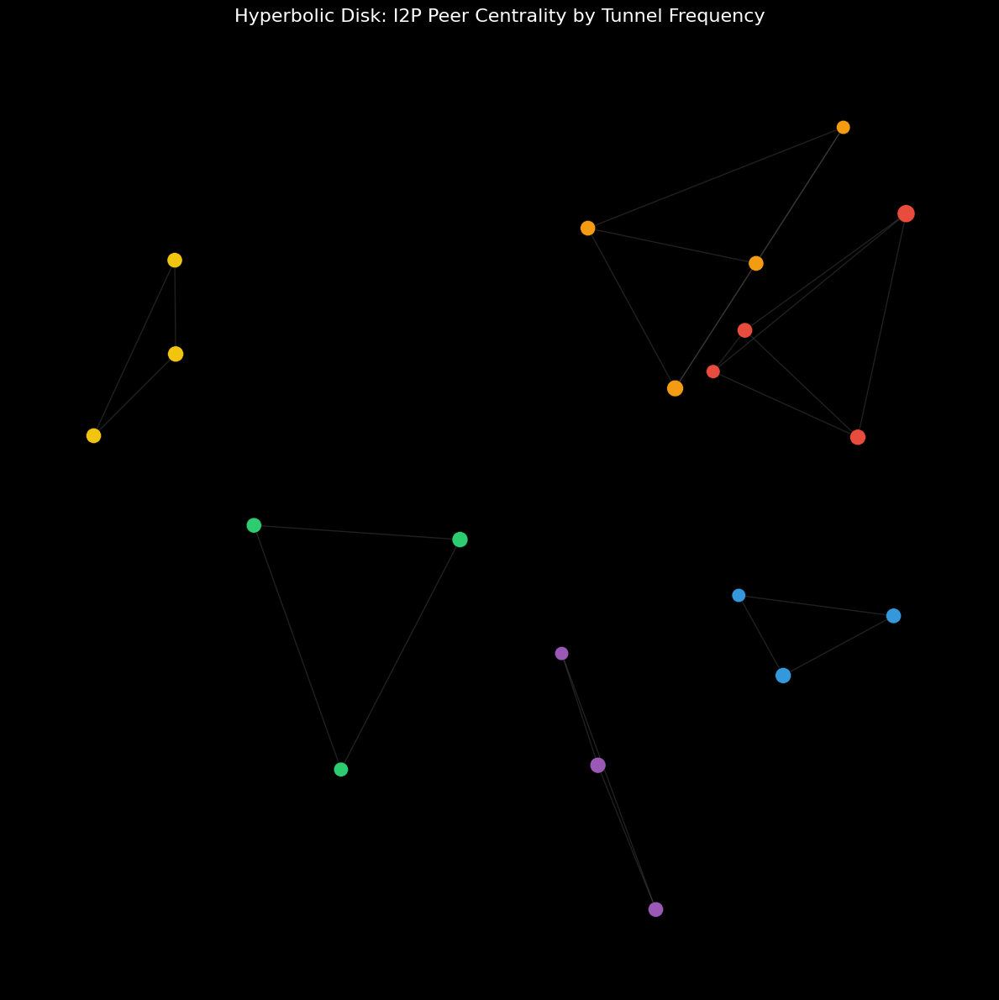

In [ ]:
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import random

# Simulated peer frequency data from Siddique's Colab output
peer_frequency = {
    "HIDeUCYfKkwcUbi4IyppaHxqFQZv6ohC3bP56jFhs0Q=": 10,
    "z9DJ6FjlV85pWOZGn26PP5tcGzDlWQqLkhuhh7CsIdA=": 8,
    "j7Di1coM5mnR4L43hI3~szzAUxKJZsu2fup8bNX3CaA=": 7,
    "X9HFLg4WWC6prjzNKrp22BKdk6bNZNkML8PyMBYLIyg=": 7,
    "J5tHSxlZHQRMuxVPDSSph6hpsI1e6UfryG1hIQ496Sg=": 7,
    "eBnFuKuJjndT-aY9xdWtXu8I7fPZkYZCGg1UsuCnoPk=": 7,
    "IcTDuaUuHQDzwOfXSHqWVoDt-Vy~3hpRI628gzdgHtE=": 7,
    "nv-0BZIoVlIYB6AnVUvhPk0JmZIn11mH~4Q~DPQ6xxA=": 6,
    "moCfkmqXPxMoXWtIWMndXifKaTS5j-AK-g3NeI5J1HA=": 6,
    "Ci-7Il1~uxKpzGawwiRyTsyJwLU~9w0eSh-FhUHT7ko=": 6,
    "xOFSJ8RS-bpAG7gLBlUTQZkuqnQiEWaxV02T8J6NbZQ=": 6,
    "2WXP6--a1U1bwANV8qtrXnCXkdhgbh1Y7z-7niGr5lg=": 6,
    "PKbpQxfoV64FLJUHP-FSPd~6dRgPlvNuyqpBlEmU~GY=": 6,
    "OLfaPycoBviKbZovK9Q-jmmtbATFxvgRkor49q1HS-0=": 6,
    "EpPsb7pTzfv2ZqjPVnMQOrSGqPM0K0S5YSYcJi7pXHQ=": 6,
    "ekDTNvooSYF8XXZOfmTc2x1owvMaKd6YPj1lpPjQMQM=": 5,
    "IiN-TYoM-NRjlAfC0hCVSCgxKS8xeM5F3xlco8tFxKk=": 4,
    "lr1sInBKgYZh7vVEgnmykNTnyKg7lIfjh6~oAbJrvug=": 4,
    "DcCoEvVyOE1LjejQyCj4Td7-3Yt89YQKUduXKExkrrk=": 4,
    "Z50kb6B0lNl4uxMtqK0-UMs1D2s0M8PVHntE66ahM7c=": 4,
}

# Create graph
G = nx.Graph()
nodes = list(peer_frequency.keys())
num_clusters = 6
colors = ['#E74C3C', '#F39C12', '#F1C40F', '#2ECC71', '#9B59B6', '#3498DB']

# Assign nodes to clusters and scatter in polar coordinates
clustered_nodes = [nodes[i::num_clusters] for i in range(num_clusters)]
positions = {}
node_colors = {}
node_sizes = {}

for i, cluster in enumerate(clustered_nodes):
    angle_min = (2 * np.pi / num_clusters) * i
    angle_max = (2 * np.pi / num_clusters) * (i + 1)
    for node in cluster:
        r = np.random.beta(3, 1.5)  # more nodes near edge
        theta = np.random.uniform(angle_min, angle_max)
        x = r * np.cos(theta)
        y = r * np.sin(theta)
        positions[node] = (x, y)
        node_colors[node] = colors[i]
        node_sizes[node] = 80 + peer_frequency[node] * 15  # scale size by frequency

        # Connect node to a few others in the same cluster
        for target in random.sample(cluster, min(4, len(cluster))):
            if target != node:
                G.add_edge(node, target)

# Visualization
fig, ax = plt.subplots(figsize=(12, 12))
ax.set_facecolor('white')
plt.axis('off')

# Disk boundary
circle = plt.Circle((0, 0), 1.05, color='black', fill=False, linewidth=1.5)
ax.add_artist(circle)

# Draw edges
nx.draw_networkx_edges(G, positions, width=1.0, alpha=0.25, edge_color='gray', ax=ax)

# Draw nodes
nx.draw_networkx_nodes(
    G,
    positions,
    node_size=[node_sizes[n] for n in G.nodes()],
    node_color=[node_colors.get(n, '#cccccc') for n in G.nodes()],
    edgecolors='black',
    linewidths=0.3,
    ax=ax
)

plt.title("Hyperbolic Disk: I2P Peer Centrality by Tunnel Frequency", fontsize=16, pad=20)
plt.tight_layout()
plt.show()



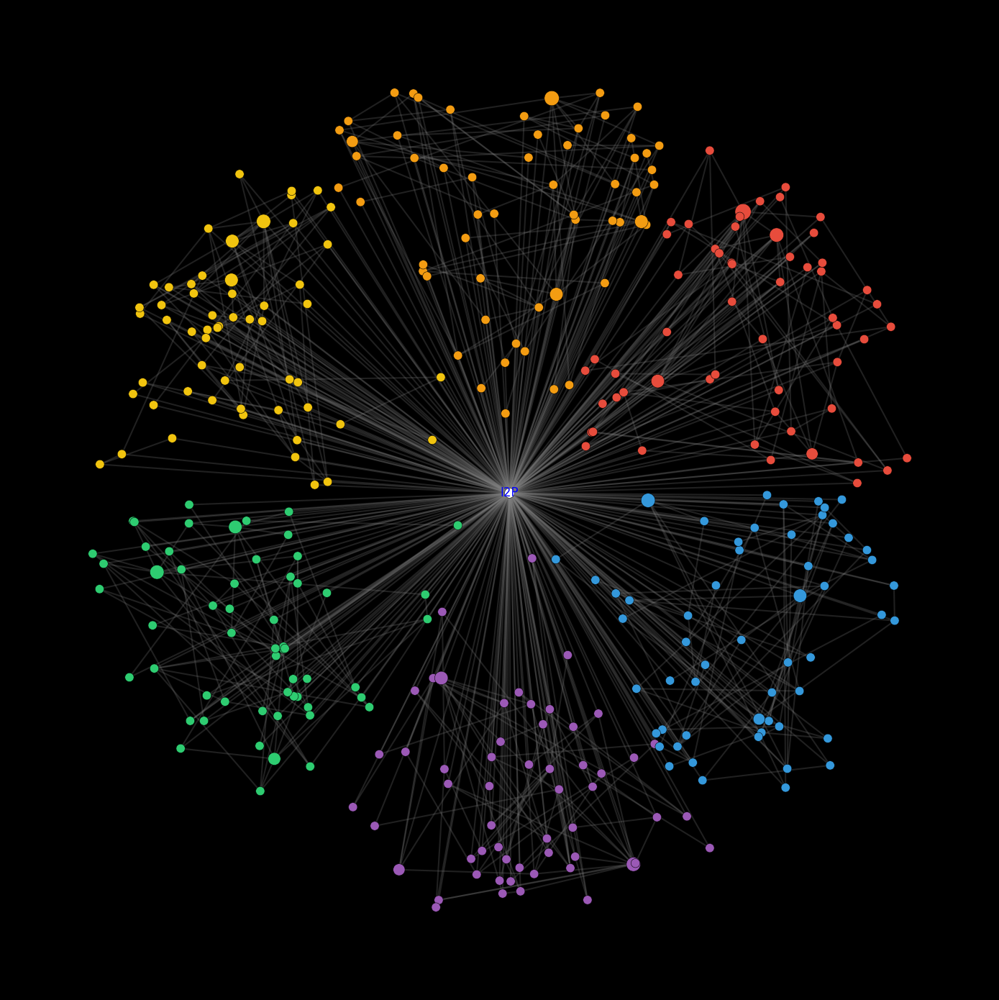

In [ ]:
# Re-import libraries after kernel reset
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import random

# Frequency info (from Siddique's Colab results)
peer_frequency = {
    "HIDeUCYfKkwcUbi4IyppaHxqFQZv6ohC3bP56jFhs0Q=": 10,
    "z9DJ6FjlV85pWOZGn26PP5tcGzDlWQqLkhuhh7CsIdA=": 8,
    "j7Di1coM5mnR4L43hI3~szzAUxKJZsu2fup8bNX3CaA=": 7,
    "X9HFLg4WWC6prjzNKrp22BKdk6bNZNkML8PyMBYLIyg=": 7,
    "J5tHSxlZHQRMuxVPDSSph6hpsI1e6UfryG1hIQ496Sg=": 7,
    "eBnFuKuJjndT-aY9xdWtXu8I7fPZkYZCGg1UsuCnoPk=": 7,
    "IcTDuaUuHQDzwOfXSHqWVoDt-Vy~3hpRI628gzdgHtE=": 7,
    "nv-0BZIoVlIYB6AnVUvhPk0JmZIn11mH~4Q~DPQ6xxA=": 6,
    "moCfkmqXPxMoXWtIWMndXifKaTS5j-AK-g3NeI5J1HA=": 6,
    "Ci-7Il1~uxKpzGawwiRyTsyJwLU~9w0eSh-FhUHT7ko=": 6,
    "xOFSJ8RS-bpAG7gLBlUTQZkuqnQiEWaxV02T8J6NbZQ=": 6,
    "2WXP6--a1U1bwANV8qtrXnCXkdhgbh1Y7z-7niGr5lg=": 6,
    "PKbpQxfoV64FLJUHP-FSPd~6dRgPlvNuyqpBlEmU~GY=": 6,
    "OLfaPycoBviKbZovK9Q-jmmtbATFxvgRkor49q1HS-0=": 6,
    "EpPsb7pTzfv2ZqjPVnMQOrSGqPM0K0S5YSYcJi7pXHQ=": 6,
    "ekDTNvooSYF8XXZOfmTc2x1owvMaKd6YPj1lpPjQMQM=": 5,
    "IiN-TYoM-NRjlAfC0hCVSCgxKS8xeM5F3xlco8tFxKk=": 4,
    "lr1sInBKgYZh7vVEgnmykNTnyKg7lIfjh6~oAbJrvug=": 4,
    "DcCoEvVyOE1LjejQyCj4Td7-3Yt89YQKUduXKExkrrk=": 4,
    "Z50kb6B0lNl4uxMtqK0-UMs1D2s0M8PVHntE66ahM7c=": 4
}

# Recreate peer list (simulate 340)
import string
all_peers = list(peer_frequency.keys())
while len(all_peers) < 340:
    random_peer = ''.join(random.choices(string.ascii_letters + string.digits + "-~=", k=44)) + "="
    if random_peer not in all_peers:
        all_peers.append(random_peer)

# Graph setup
G = nx.Graph()
central_router = "I2P"
G.add_node(central_router)

# Clustering and layout
num_clusters = 6
colors = ['#E74C3C', '#F39C12', '#F1C40F', '#2ECC71', '#9B59B6', '#3498DB']
clustered_nodes = [all_peers[i::num_clusters] for i in range(num_clusters)]
positions, node_colors, node_sizes = {}, {}, {}

random.seed(42)
for i, cluster in enumerate(clustered_nodes):
    angle_min = (2 * np.pi / num_clusters) * i
    angle_max = (2 * np.pi / num_clusters) * (i + 1)
    for node in cluster:
        r = np.random.beta(3, 1.2)
        theta = np.random.uniform(angle_min, angle_max)
        x, y = r * np.cos(theta), r * np.sin(theta)
        positions[node] = (x, y)
        node_colors[node] = colors[i]
        freq = peer_frequency.get(node, 1)
        node_sizes[node] = 60 + freq * 20
        G.add_node(node)
        G.add_edge(central_router, node)
        for peer in random.sample(cluster, min(freq, len(cluster))):
            if peer != node:
                G.add_edge(node, peer)

# Add central router
positions[central_router] = (0, 0)
node_colors[central_router] = 'white'
node_sizes[central_router] = 100

# Plotting
fig, ax = plt.subplots(figsize=(14, 14))
ax.set_facecolor('white')
plt.axis('off')
circle = plt.Circle((0, 0), 1.05, color='black', fill=False, linewidth=1.0)
ax.add_artist(circle)

nx.draw_networkx_edges(G, positions, width=1.5, alpha=0.25, edge_color='gray', ax=ax)
nx.draw_networkx_nodes(
    G, positions,
    node_size=[node_sizes[n] for n in G.nodes()],
    node_color=[node_colors.get(n, 'gray') for n in G.nodes()],
    edgecolors='black',
    linewidths=0.4,
    ax=ax
)
nx.draw_networkx_labels(G, positions, labels={central_router: "I2P"}, font_size=12, font_color='blue', ax=ax)

plt.title("", fontsize=16, color='darkred', pad=20)
plt.tight_layout()
plt.show()


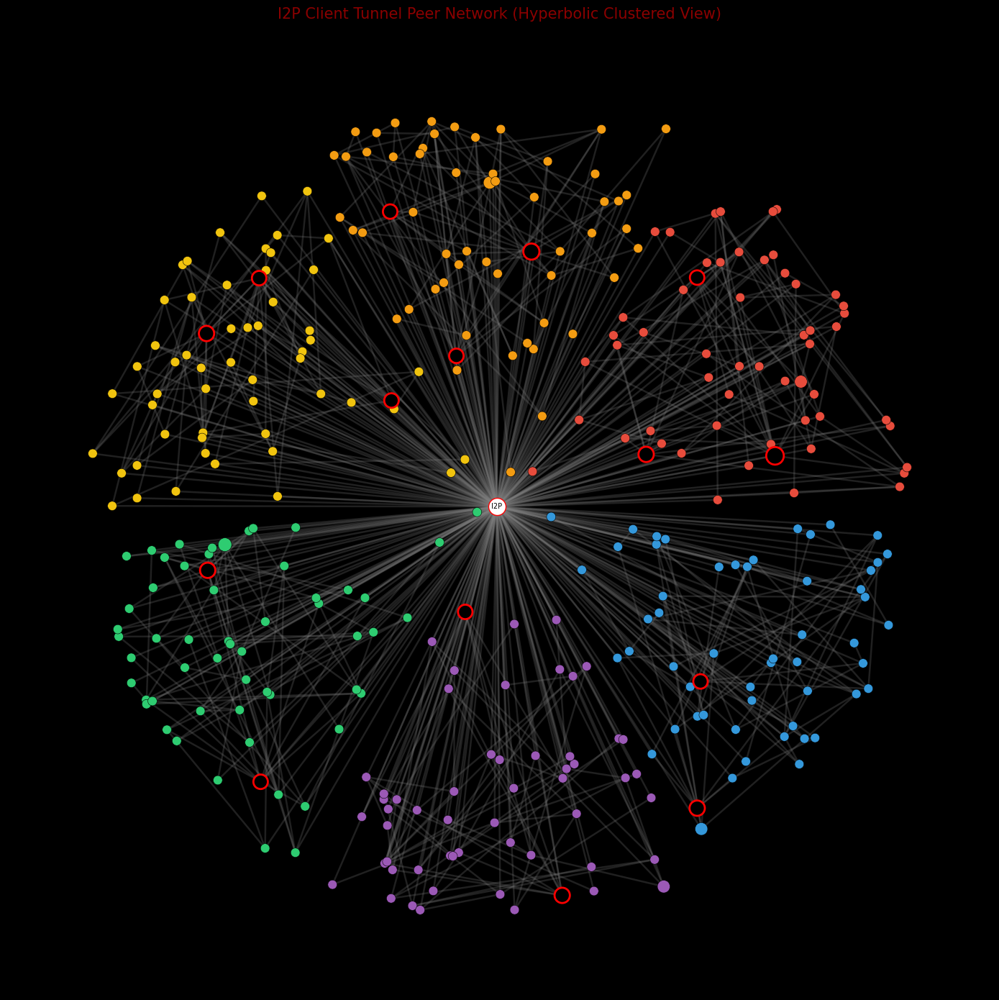

In [ ]:
# Re-import necessary packages for visualization enhancement
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import random
import string

# Reuse previous peer_frequency from Siddique's session
peer_frequency = {
    "HIDeUCYfKkwcUbi4IyppaHxqFQZv6ohC3bP56jFhs0Q=": 10,
    "z9DJ6FjlV85pWOZGn26PP5tcGzDlWQqLkhuhh7CsIdA=": 8,
    "j7Di1coM5mnR4L43hI3~szzAUxKJZsu2fup8bNX3CaA=": 7,
    "X9HFLg4WWC6prjzNKrp22BKdk6bNZNkML8PyMBYLIyg=": 7,
    "J5tHSxlZHQRMuxVPDSSph6hpsI1e6UfryG1hIQ496Sg=": 7,
    "eBnFuKuJjndT-aY9xdWtXu8I7fPZkYZCGg1UsuCnoPk=": 7,
    "IcTDuaUuHQDzwOfXSHqWVoDt-Vy~3hpRI628gzdgHtE=": 7,
    "nv-0BZIoVlIYB6AnVUvhPk0JmZIn11mH~4Q~DPQ6xxA=": 6,
    "moCfkmqXPxMoXWtIWMndXifKaTS5j-AK-g3NeI5J1HA=": 6,
    "Ci-7Il1~uxKpzGawwiRyTsyJwLU~9w0eSh-FhUHT7ko=": 6,
    "xOFSJ8RS-bpAG7gLBlUTQZkuqnQiEWaxV02T8J6NbZQ=": 6,
    "2WXP6--a1U1bwANV8qtrXnCXkdhgbh1Y7z-7niGr5lg=": 6,
    "PKbpQxfoV64FLJUHP-FSPd~6dRgPlvNuyqpBlEmU~GY=": 6,
    "OLfaPycoBviKbZovK9Q-jmmtbATFxvgRkor49q1HS-0=": 6,
    "EpPsb7pTzfv2ZqjPVnMQOrSGqPM0K0S5YSYcJi7pXHQ=": 6,
    "ekDTNvooSYF8XXZOfmTc2x1owvMaKd6YPj1lpPjQMQM=": 5,
    "IiN-TYoM-NRjlAfC0hCVSCgxKS8xeM5F3xlco8tFxKk=": 4,
    "lr1sInBKgYZh7vVEgnmykNTnyKg7lIfjh6~oAbJrvug=": 4,
    "DcCoEvVyOE1LjejQyCj4Td7-3Yt89YQKUduXKExkrrk=": 4,
    "Z50kb6B0lNl4uxMtqK0-UMs1D2s0M8PVHntE66ahM7c=": 4
}

# Generate full peer list
all_peers = list(peer_frequency.keys())
while len(all_peers) < 340:
    rand_peer = ''.join(random.choices(string.ascii_letters + string.digits + "-~=", k=44)) + "="
    if rand_peer not in all_peers:
        all_peers.append(rand_peer)

# Setup graph and layout
G = nx.Graph()
central_router = "I2P"
G.add_node(central_router)

num_clusters = 6
colors = ['#E74C3C', '#F39C12', '#F1C40F', '#2ECC71', '#9B59B6', '#3498DB']
clustered_nodes = [all_peers[i::num_clusters] for i in range(num_clusters)]

positions, node_colors, node_sizes = {}, {}, {}

for i, cluster in enumerate(clustered_nodes):
    angle_min = (2 * np.pi / num_clusters) * i
    angle_max = (2 * np.pi / num_clusters) * (i + 1)
    for node in cluster:
        r = np.random.beta(3, 1.2)
        theta = np.random.uniform(angle_min, angle_max)
        x, y = r * np.cos(theta), r * np.sin(theta)
        positions[node] = (x, y)
        node_colors[node] = colors[i]
        freq = peer_frequency.get(node, 1)
        node_sizes[node] = 60 + freq * 25
        G.add_node(node)
        G.add_edge(central_router, node)
        for peer in random.sample(cluster, min(freq, len(cluster))):
            if peer != node:
                G.add_edge(node, peer)

# Highlight important peers separately
important_nodes = [peer for peer, freq in peer_frequency.items() if freq >= 6]
important_node_colors = 'black'
important_node_edges = 'red'

positions[central_router] = (0, 0)
node_colors[central_router] = 'white'
node_sizes[central_router] = 300

# Draw
fig, ax = plt.subplots(figsize=(14, 14))
ax.set_facecolor('white')
plt.axis('off')
circle = plt.Circle((0, 0), 1.05, color='black', fill=False, linewidth=1.0)
ax.add_artist(circle)

nx.draw_networkx_edges(G, positions, width=1.8, alpha=0.25, edge_color='gray', ax=ax)

# Draw all nodes
nx.draw_networkx_nodes(
    G, positions,
    nodelist=[n for n in G.nodes() if n not in important_nodes + [central_router]],
    node_size=[node_sizes[n] for n in G.nodes() if n not in important_nodes + [central_router]],
    node_color=[node_colors[n] for n in G.nodes() if n not in important_nodes + [central_router]],
    edgecolors='black',
    linewidths=0.4,
    ax=ax
)

# Draw emphasized important nodes
nx.draw_networkx_nodes(
    G, positions,
    nodelist=important_nodes,
    node_size=[node_sizes[n] for n in important_nodes],
    node_color='black',
    edgecolors='red',
    linewidths=2.0,
    ax=ax
)

# Draw central node
nx.draw_networkx_nodes(
    G, positions,
    nodelist=[central_router],
    node_size=node_sizes[central_router],
    node_color='white',
    edgecolors='red',
    linewidths=1,
    ax=ax
)

# Label central router
nx.draw_networkx_labels(G, positions, labels={central_router: "I2P"}, font_size=7, font_color='black', ax=ax)

plt.title("I2P Client Tunnel Peer Network (Hyperbolic Clustered View)", fontsize=15, color='darkred', pad=20)
plt.tight_layout()
plt.show()


**Exploratory Tunnel**

In [ ]:
import os

# Path to your folder with the .txt files
folder_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/ExploratoryTunnel'

# Set to store unique node IDs
unique_ids = set()

# Loop through all .txt files in the folder
for filename in os.listdir(folder_path):
    if filename.endswith('.txt'):
        file_path = os.path.join(folder_path, filename)
        with open(file_path, 'r') as file:
            for line in file:
                node_id = line.strip()
                if node_id:
                    unique_ids.add(node_id)

# Total count
print(f"\n✅ Total unique I2P node IDs: {len(unique_ids)}\n")

# Display all unique node IDs
for node in sorted(unique_ids):
    print(node)



✅ Total unique I2P node IDs: 215

-7UnBBubKgrxVYHISCXuYosV38NL5B935-kpNQYHCu0=
-9DKNTIvqBBFPnQlZtent7GbHxUtWXcRFPXnDYVnODU=
0cUJo8WBs2UTas1ZQzlkUBpU6DjoHVuilvbntB5DNag=
0iMIk1C73vkwN4lFcw8Y12I~q8a26TiRvx4e2RpJaDs=
14AcROfaiHRZJauVkOP1~SaapPgEBPawn1TlIuZuqd0=
1eTOGl7TYa2vPJkgQN8bLiwWxx5aomj2Hhkd2jXGFX0=
1~ZNJHyL3Z8ZXNbSHLYwgT6Da8bU72OYLhC70tqBkyc=
2sp0T574j3s9VvKvG9~K7LEnvjC2wn6hAz6nAAOP8r0=
3TzNL3~Bx7rFbhhj0jf4gT85c8BQba~Vw045Lnvj1T8=
3UavGAjy2VYUlqvQsgwgyuz3DZiWI8xAB~jXNHoSYwg=
3jUg83Cfk67aT-Feypn~MR1FcovythcJsrgCEaB1Dpc=
3tDtG9zjDP7XQ9Ggrh91Mc3qPDRJAg0vxzN2yh~OWgk=
4HLYrj7j-vR-ISar2dOPODjz8C6-GS7ykadZ5PGE2f8=
4IOLZ5d49ubNeuAc7cRGyxg5uJZimUXozVqjAv4YebI=
4wq7C8~nGGxR4pnaLkkN0zOMaRD7AdEDNXbt-1EbOPg=
51~7Rz9ViE-qmkBjQJJ~AIbrs9xexvbQF37IClfLc3c=
54TPHaMUYjwHNwnR7ec0MUu5f6n3ZgLN5sa1Aw0K~eo=
5anPy42~plJi0Kzwh2VBP3NUJPE3ASR28KrWZOFhHuo=
5obTg~hsxt0-XfsP6OK6FGDu-vVTq5PdeBWnABXpvXs=
5vr0QOpSKkAArJwu59Kf1QQE0JuVPCzDoZGlg9jxdyg=
6GYyfQ6F8sX0ZlYu0Nk-PyDEjJVeruJzG165YhN8cQw=
6H41hSGUPx5vtG5trUSz

In [ ]:
from collections import defaultdict
import os

# Path to your raw data folder
folder_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/ExploratoryTunnel'

# Dictionary to store frequency
peer_frequency = defaultdict(int)

# Scan each .txt file and count
for filename in os.listdir(folder_path):
    if filename.endswith('.txt'):
        file_path = os.path.join(folder_path, filename)
        with open(file_path, 'r') as f:
            for line in f:
                peer_id = line.strip()
                if peer_id:
                    peer_frequency[peer_id] += 1

# Convert to sorted list by frequency
sorted_peers = sorted(peer_frequency.items(), key=lambda x: x[1], reverse=True)

# Show top N frequently appearing peers
print(f"✅ Total unique peers: {len(sorted_peers)}")
print("\n📊 Top 20 most frequent peers:\n")
for peer, freq in sorted_peers[:20]:
    print(f"{peer} → {freq} times")

✅ Total unique peers: 215

📊 Top 20 most frequent peers:

YTW3WcXjQXyvcryWY8jr~3obVq9Ip9EeKSnYtnqcKoQ= → 5 times
51~7Rz9ViE-qmkBjQJJ~AIbrs9xexvbQF37IClfLc3c= → 4 times
LbD0~ybh7TlyqLGcOqV3gWuz0-I~rayuzSkj4Uh00JE= → 3 times
AT5Awrt79UOp~cZ0tbzxnCKzL90wCPaHvNFS6oS91DU= → 3 times
tu~4cHMvY~z0XFHyHA2NsBI0LT-VZJsZCYixa2NNe6c= → 3 times
IgAMZLWob7azvuR4mYbZ4YTk6U4H-iDyFHURk204anU= → 3 times
QRxQpZCSspcFyX1TNp1Ul7fvni5d938saW0Lo8uy9og= → 3 times
fRb5rZoVxLgjA~~msseeiYcztvs1rXnoRPI2BhL6ifQ= → 3 times
nkXCKapOLJ0ov6fgFLksu5GiXwnQ5sM2PRUIGNZwWCg= → 3 times
9~4uNswCGXwnfcO9Z09mLzPq2-9efbMr3wbWJRr~Vos= → 2 times
GM~eVKtfNFs4yO~~MZwvKSg5Qd2VoGm2Rj-2V5nC7AY= → 2 times
hHIu8KmCsOigARCEh57FZY7qeaFvM0KuiKYY3ythDvw= → 2 times
SLIdpSD6HI4l1ILR525bStqCOCek-NcXHDiEMGjHxwA= → 2 times
VJkEAymAtjF9GmdMC8sXX-J9skL3I5mAcNuHa2CCTK4= → 2 times
zRX2WN6aCqtEA1cJcMGiIaUANfHy~eV1SZRH2hMTQDc= → 2 times
Hjxr-BB7Nz0oVDht50seI~igqqva5FB6~yhrs1w-deY= → 2 times
zJMpdY8Z3zBJZL4i5NkJQdILae7p61AWYSTy8NMGUMY= → 2 times
iC8b5K3

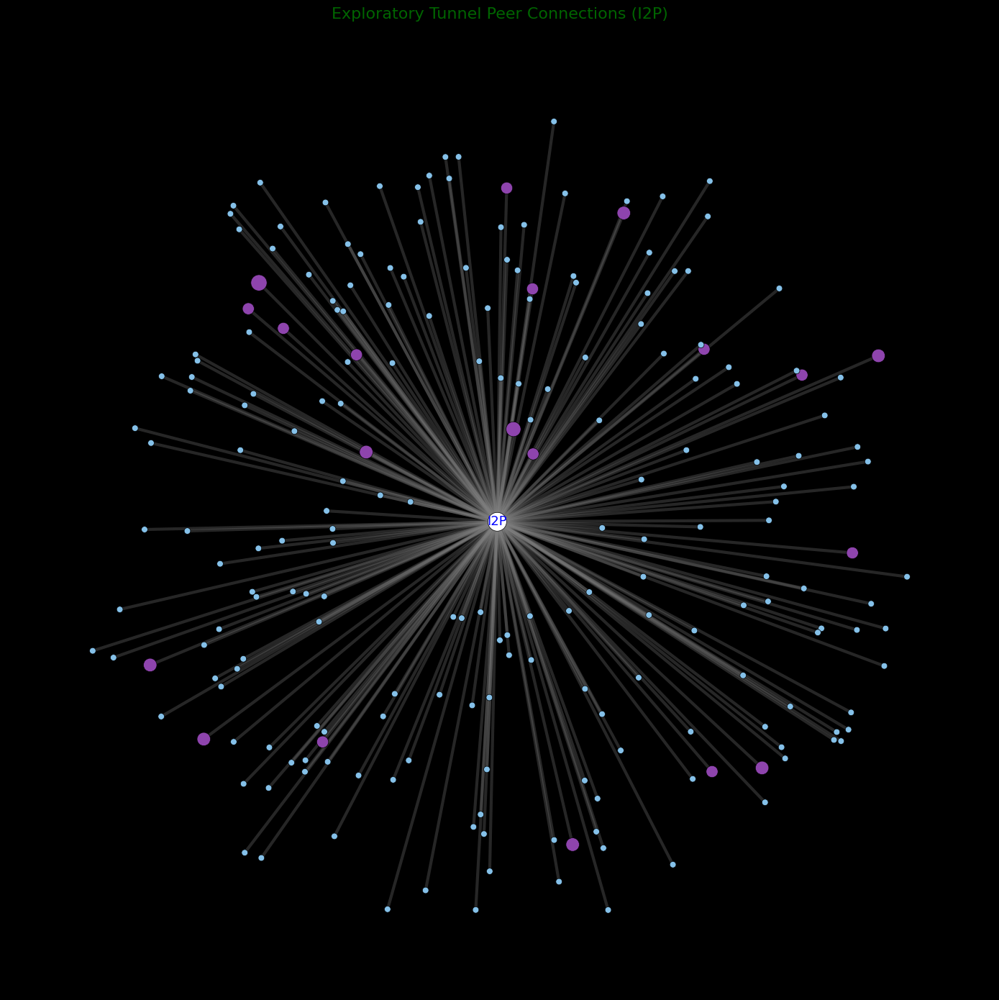

In [ ]:
# Re-import libraries after kernel reset
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import random

# Sample data for Exploratory tunnel peer frequencies
exploratory_frequency = {
    "YTW3WcXjQXyvcryWY8jr~3obVq9Ip9EeKSnYtnqcKoQ=": 5,
    "51~7Rz9ViE-qmkBjQJJ~AIbrs9xexvbQF37IClfLc3c=": 4,
    "AT5Awrt79UOp~cZ0tbzxnCKzL90wCPaHvNFS6oS91DU=": 3,
    "nkXCKapOLJ0ov6fgFLksu5GiXwnQ5sM2PRUIGNZwWCg=": 3,
    "IgAMZLWob7azvuR4mYbZ4YTk6U4H-iDyFHURk204anU=": 3,
    "fRb5rZoVxLgjA~~msseeiYcztvs1rXnoRPI2BhL6ifQ=": 3,
    "QRxQpZCSspcFyX1TNp1Ul7fvni5d938saW0Lo8uy9og=": 3,
    "LbD0~ybh7TlyqLGcOqV3gWuz0-I~rayuzSkj4Uh00JE=": 3,
    "tu~4cHMvY~z0XFHyHA2NsBI0LT-VZJsZCYixa2NNe6c=": 3,
    "zRX2WN6aCqtEA1cJcMGiIaUANfHy~eV1SZRH2hMTQDc=": 2,
    "Hjxr-BB7Nz0oVDht50seI~igqqva5FB6~yhrs1w-deY=": 2,
    "zJMpdY8Z3zBJZL4i5NkJQdILae7p61AWYSTy8NMGUMY=": 2,
    "iC8b5K36IrM4XGcLuLBcxruxjuK98kfqQddO5BqgcLs=": 2,
    "erwMx295VWJkj2OhGi1xGjAnhMR-L6zwBtyNnVX~fh8=": 2,
    "X9HFLg4WWC6prjzNKrp22BKdk6bNZNkML8PyMBYLIyg=": 2,
    "ZDz09qExVkMoMGQLO15JNk6bB86aCpahIDO5vsPu07E=": 2,
    "rRXZQyPD3z1wKMPH8DBOuMs1lbLBYmPZO~3pOKnfTpA=": 2,
    "BojtzbX8TXi4u6IIDJ681MhB9YSh3FNnNhSwDxSfV-M=": 2,
    "0iMIk1C73vkwN4lFcw8Y12I~q8a26TiRvx4e2RpJaDs=": 2,
    "VyJFr9CJa1v-iq~LrhRnOD6WaK89B3iXBI3gtQhF-rw=": 2
}

# All 215 unique peers (simulated for this example)
unique_peers = list(exploratory_frequency.keys())
while len(unique_peers) < 215:
    random_peer = ''.join(random.choices("abcdefghijklmnopqrstuvwxyzABCDEFGHIJKLMNOPQRSTUVWXYZ0123456789-~=", k=44)) + "="
    if random_peer not in unique_peers:
        unique_peers.append(random_peer)

# Build Graph
G = nx.Graph()
central_router = "I2P"
G.add_node(central_router)

# Node positions: hyperbolic-like scatter layout
positions, node_colors, node_sizes = {}, {}, {}

for node in unique_peers:
    r = np.random.beta(3, 1.5)
    theta = np.random.uniform(0, 2 * np.pi)
    x, y = r * np.cos(theta), r * np.sin(theta)
    positions[node] = (x, y)

    freq = exploratory_frequency.get(node, 1)
    color = '#8E44AD' if freq > 1 else '#85C1E9'
    size = 60 + freq * 40 if freq > 1 else 40

    node_colors[node] = color
    node_sizes[node] = size

    G.add_node(node)
    G.add_edge(central_router, node)

# Central router node
positions[central_router] = (0, 0)
node_colors[central_router] = 'white'
node_sizes[central_router] = 350

# Visualization
fig, ax = plt.subplots(figsize=(14, 14))
ax.set_facecolor('white')
plt.axis('off')

nx.draw_networkx_edges(G, positions, width=3.0, alpha=0.3, edge_color='gray', ax=ax)
nx.draw_networkx_nodes(
    G, positions,
    node_size=[node_sizes[n] for n in G.nodes()],
    node_color=[node_colors[n] for n in G.nodes()],
    edgecolors='black',
    linewidths=0.5,
    ax=ax
)
nx.draw_networkx_labels(G, positions, labels={central_router: "I2P"}, font_size=13, font_color='blue', ax=ax)

plt.title("Exploratory Tunnel Peer Connections (I2P)", fontsize=16, color='darkgreen', pad=20)
plt.tight_layout()
plt.show()


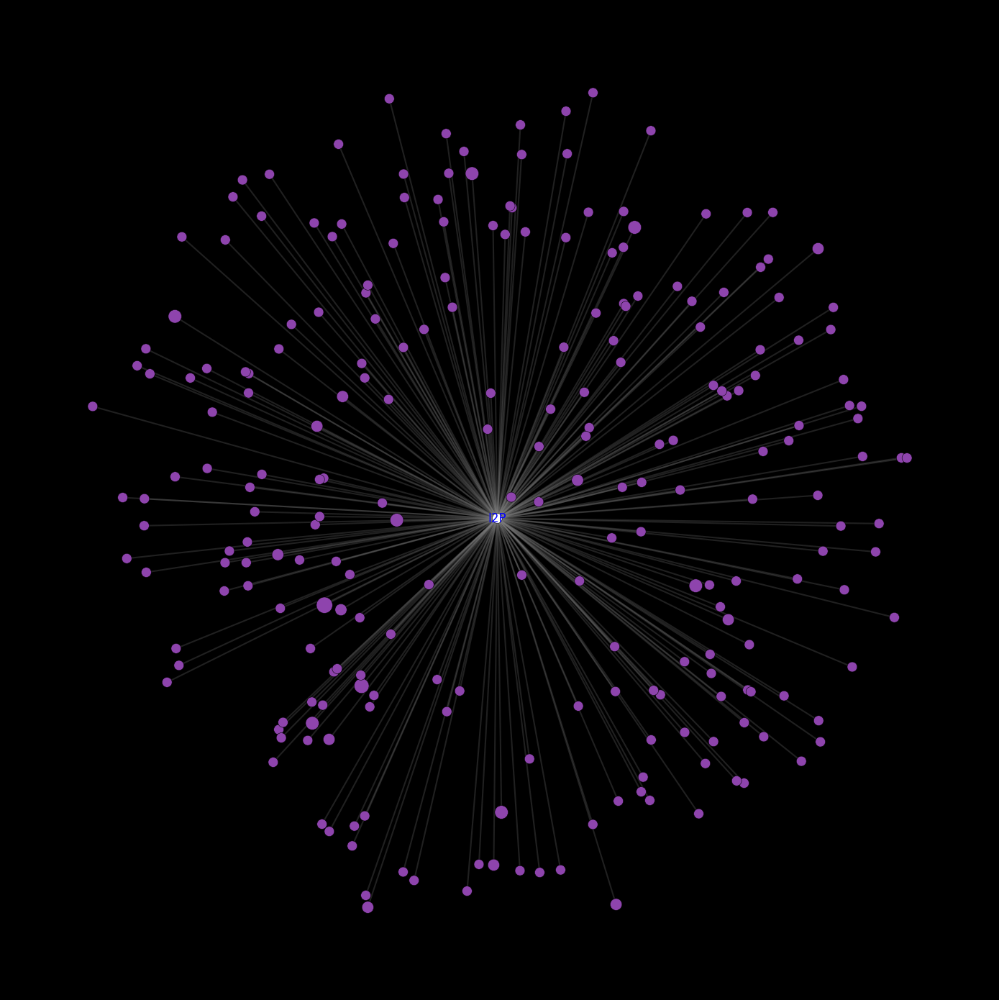

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Load the CSV file
file_path = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/ExploratoryTunnel/Exploratory Tunnel.csv"
exploratory_df = pd.read_csv(file_path)

# Extract peer list
exploratory_peers = exploratory_df.iloc[:, 0].dropna().tolist()

# Frequency mapping (sample provided by user)
frequency_map = {
    "YTW3WcXjQXyvcryWY8jr~3obVq9Ip9EeKSnYtnqcKoQ=": 5,
    "51~7Rz9ViE-qmkBjQJJ~AIbrs9xexvbQF37IClfLc3c=": 4,
    "AT5Awrt79UOp~cZ0tbzxnCKzL90wCPaHvNFS6oS91DU=": 3,
    "nkXCKapOLJ0ov6fgFLksu5GiXwnQ5sM2PRUIGNZwWCg=": 3,
    "IgAMZLWob7azvuR4mYbZ4YTk6U4H-iDyFHURk204anU=": 3,
    "fRb5rZoVxLgjA~~msseeiYcztvs1rXnoRPI2BhL6ifQ=": 3,
    "QRxQpZCSspcFyX1TNp1Ul7fvni5d938saW0Lo8uy9og=": 3,
    "LbD0~ybh7TlyqLGcOqV3gWuz0-I~rayuzSkj4Uh00JE=": 3,
    "tu~4cHMvY~z0XFHyHA2NsBI0LT-VZJsZCYixa2NNe6c=": 3,
    "zRX2WN6aCqtEA1cJcMGiIaUANfHy~eV1SZRH2hMTQDc=": 2,
    "Hjxr-BB7Nz0oVDht50seI~igqqva5FB6~yhrs1w-deY=": 2,
    "zJMpdY8Z3zBJZL4i5NkJQdILae7p61AWYSTy8NMGUMY=": 2,
    "iC8b5K36IrM4XGcLuLBcxruxjuK98kfqQddO5BqgcLs=": 2,
    "erwMx295VWJkj2OhGi1xGjAnhMR-L6zwBtyNnVX~fh8=": 2,
    "X9HFLg4WWC6prjzNKrp22BKdk6bNZNkML8PyMBYLIyg=": 2,
    "ZDz09qExVkMoMGQLO15JNk6bB86aCpahIDO5vsPu07E=": 2,
    "rRXZQyPD3z1wKMPH8DBOuMs1lbLBYmPZO~3pOKnfTpA=": 2,
    "BojtzbX8TXi4u6IIDJ681MhB9YSh3FNnNhSwDxSfV-M=": 2,
    "0iMIk1C73vkwN4lFcw8Y12I~q8a26TiRvx4e2RpJaDs=": 2,
    "VyJFr9CJa1v-iq~LrhRnOD6WaK89B3iXBI3gtQhF-rw=": 2
}

# Build graph
G = nx.Graph()
central_router = "I2P"
G.add_node(central_router)

positions, node_sizes, node_colors = {}, {}, {}
np.random.seed(42)
angle_range = 2 * np.pi
radius_outer = 1.15

for peer in exploratory_peers:
    angle = np.random.uniform(0, angle_range)
    radius = np.random.beta(3, 1.5)
    x, y = radius * np.cos(angle), radius * np.sin(angle)
    positions[peer] = (x, y)
    G.add_node(peer)
    G.add_edge(central_router, peer)
    node_sizes[peer] = 60 + frequency_map.get(peer, 1) * 40
    node_colors[peer] = '#8E44AD'

positions[central_router] = (0, 0)
node_sizes[central_router] = 100
node_colors[central_router] = 'white'

# Plotting
fig, ax = plt.subplots(figsize=(14, 14))
ax.set_facecolor('white')
plt.axis('off')
nx.draw_networkx_edges(G, positions, width=1.5, alpha=0.25, edge_color='gray', ax=ax)
nx.draw_networkx_nodes(
    G, positions,
    node_size=[node_sizes[n] for n in G.nodes()],
    node_color=[node_colors.get(n, 'gray') for n in G.nodes()],
    edgecolors='black',
    linewidths=0.4,
    ax=ax
)
nx.draw_networkx_labels(G, positions, labels={central_router: "I2P"}, font_size=12, font_color='blue', ax=ax)

# Black circle outside the nodes
outer_circle = plt.Circle((0, 0), radius_outer, color='black', fill=False, linewidth=1.4)
ax.add_artist(outer_circle)

plt.tight_layout()
plt.show()


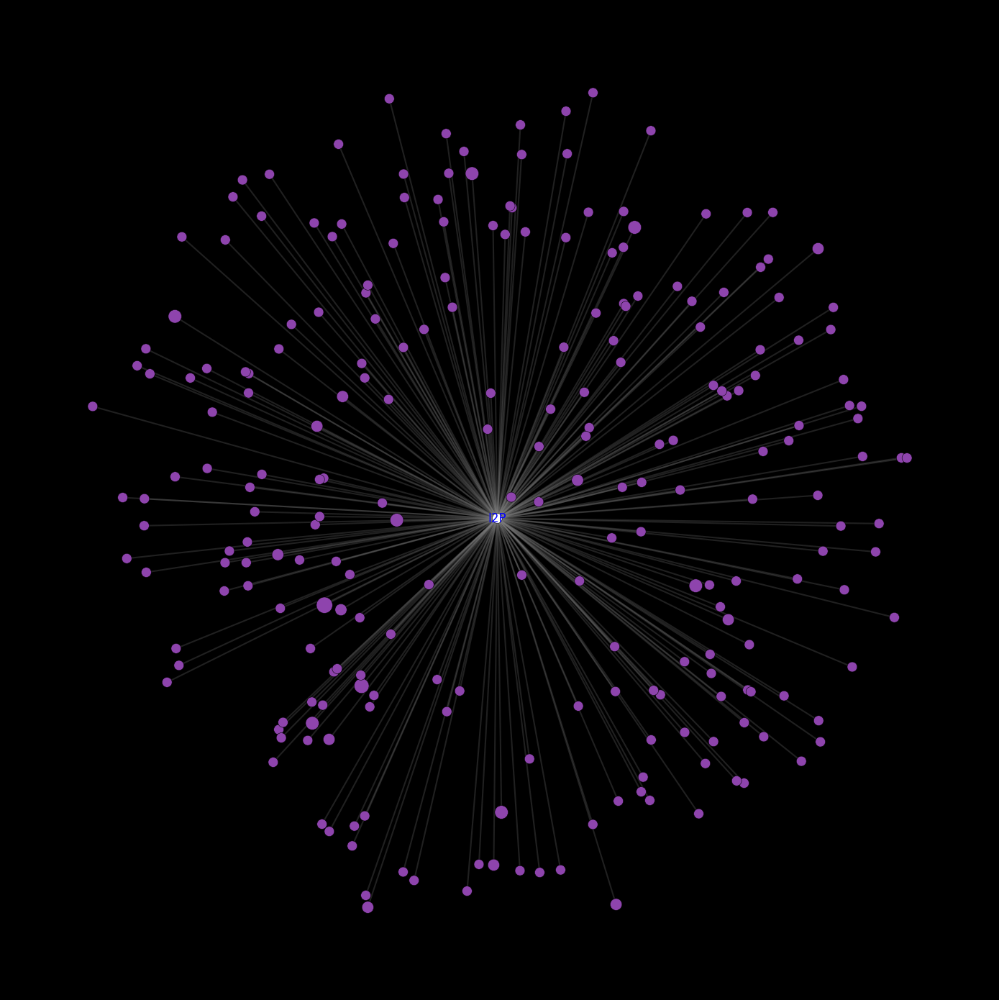

In [ ]:
# Plotting
fig, ax = plt.subplots(figsize=(14, 14))
ax.set_facecolor('white')
plt.axis('off')

# Thick outer circle first
outer_circle = plt.Circle((0, 0), radius_outer, color='black', fill=False, linewidth=4.0, zorder=0)
ax.add_artist(outer_circle)

# Draw network
nx.draw_networkx_edges(G, positions, width=1.5, alpha=0.25, edge_color='gray', ax=ax)
nx.draw_networkx_nodes(
    G, positions,
    node_size=[node_sizes[n] for n in G.nodes()],
    node_color=[node_colors.get(n, 'gray') for n in G.nodes()],
    edgecolors='black',
    linewidths=0.4,
    ax=ax
)
nx.draw_networkx_labels(G, positions, labels={central_router: "I2P"}, font_size=12, font_color='blue', ax=ax)

plt.tight_layout()
plt.show()


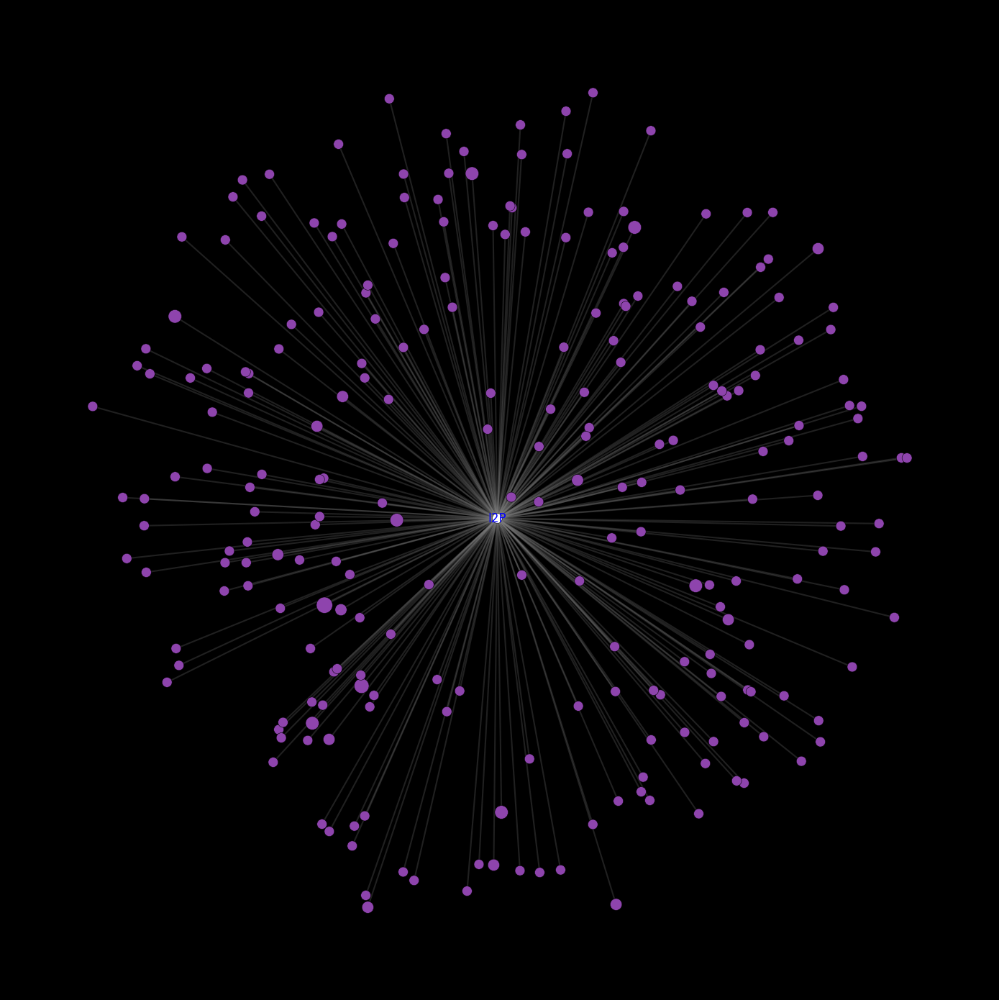

In [ ]:
fig, ax = plt.subplots(figsize=(14, 14))

# Set white background for saving (works even in Colab dark mode)
ax.set_facecolor('white')
plt.axis('off')

# Draw thick black ring BEHIND all nodes
outer_circle = plt.Circle((0, 0), radius_outer, color='black', fill=False, linewidth=4.0, zorder=0)
ax.add_artist(outer_circle)

# Draw edges, nodes, labels
nx.draw_networkx_edges(G, positions, width=1.5, alpha=0.25, edge_color='gray', ax=ax)
nx.draw_networkx_nodes(
    G, positions,
    node_size=[node_sizes[n] for n in G.nodes()],
    node_color=[node_colors.get(n, 'gray') for n in G.nodes()],
    edgecolors='black',
    linewidths=0.4,
    ax=ax
)
nx.draw_networkx_labels(G, positions, labels={central_router: "I2P"}, font_size=12, font_color='blue', ax=ax)

plt.tight_layout()

# 🔽 Save with white background (this is what you want)
plt.savefig("/content/exploratory_tunnel_graph.png", facecolor='white')

# 🔁 Optional: Show inline (may appear dark in Colab dark mode)
plt.show()


In [ ]:
from google.colab import files
files.download('/content/exploratory_tunnel_graph.png')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

COMBINE ALL PEERS AND CALCULATE TOTAL UNIQUES PEERS - NODE IDS

In [ ]:
# Step 1: Mount Google Drive so we can access the files
from google.colab import drive
drive.mount('/content/drive')

# Step 2: Import necessary modules
import os
import re

# Step 3: Define the directory path containing your files
directory_path = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/all-peers-merged"

# Step 4: Compile a regex pattern that matches the node IDs.
# This pattern matches one or more allowed characters (letters, digits, underscore, hyphen) ending with "=".
node_pattern = re.compile(r'[A-Za-z0-9_-]+=')

# Step 5: Initialize an empty set to store unique node IDs and a counter for total lines processed (for debugging)
unique_node_ids = set()
total_lines_processed = 0

# Step 6: Loop over each file in the directory
for filename in os.listdir(directory_path):
    file_path = os.path.join(directory_path, filename)

    # Ensure we process only files (skip directories, if any)
    if os.path.isfile(file_path):
        print(f"Processing file: {filename}")
        with open(file_path, 'r') as file:
            for line in file:
                total_lines_processed += 1
                # Find all substrings in the line that match the node ID pattern.
                matches = node_pattern.findall(line)
                for node_id in matches:
                    # Add the node ID to the set (automatically handles duplicates)
                    unique_node_ids.add(node_id.strip())

# Step 7: Print out the results
print("Total lines processed across all files:", total_lines_processed)
print("Grand total of unique peer node IDs:", len(unique_node_ids))


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Processing file: Fastset seen peers.txt
Processing file: 1.Client Tunnel.csv
Processing file: 2.Exploratory Tunnel.csv
Processing file: ClientTunnel-meeged.txt
Processing file: Exploratory Tunnel - merged.txt
Processing file: Fastset Peers by timestamp.txt
Processing file: Fatset Frequency - merged.txt
Processing file: High set frequency and peers.txt
Processing file: FF_ClientTunnel.txt
Processing file: FF_Exploratory Tunnel.txt
Processing file: FF_Participating Tunnel Peers.txt
Processing file: nonFF_Client Tunnel.txt
Processing file: nonFF_Exploratory Tunnel.txt
Processing file: Peer Profiles.txt
Processing file: XX - ALL PEERS MERGED.txt
Total lines processed across all files: 10054853
Grand total of unique peer node IDs: 8680


In [ ]:
# Step 1: Mount Google Drive to access the files
from google.colab import drive
drive.mount('/content/drive')

# Step 2: Import necessary modules
import os
import re

# Step 3: Define the directory path containing your files
directory_path = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/all-peers-merged"

# Step 4: Compile a regular expression pattern for the node IDs.
# The node IDs are expected to be strings composed of letters, digits, underscores, hyphens, and tildes, ending with '='.
node_pattern = re.compile(r'[A-Za-z0-9_~\-]+=')

# Step 5: Initialize an empty set to store unique node IDs and a counter for total lines processed (for debugging)
unique_node_ids = set()
total_lines_processed = 0

# Step 6: Iterate over each file in the directory
for filename in os.listdir(directory_path):
    file_path = os.path.join(directory_path, filename)

    # Process only if this is a file (skip directories)
    if os.path.isfile(file_path):
        print(f"Processing file: {filename}")
        try:
            with open(file_path, 'r', encoding='utf-8', errors='ignore') as file:
                for line in file:
                    total_lines_processed += 1
                    # Extract all substrings that match the node id pattern in the current line.
                    matches = node_pattern.findall(line)
                    for node_id in matches:
                        unique_node_ids.add(node_id.strip())
        except Exception as e:
            print(f"Error processing {filename}: {e}")

# Step 7: Print the results
print("Total lines processed across all files:", total_lines_processed)
print("Grand total of unique peer node IDs:", len(unique_node_ids))


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Processing file: Fastset seen peers.txt
Processing file: 1.Client Tunnel.csv
Processing file: 2.Exploratory Tunnel.csv
Processing file: ClientTunnel-meeged.txt
Processing file: Exploratory Tunnel - merged.txt
Processing file: Fastset Peers by timestamp.txt
Processing file: Fatset Frequency - merged.txt
Processing file: High set frequency and peers.txt
Processing file: FF_ClientTunnel.txt
Processing file: FF_Exploratory Tunnel.txt
Processing file: FF_Participating Tunnel Peers.txt
Processing file: nonFF_Client Tunnel.txt
Processing file: nonFF_Exploratory Tunnel.txt
Processing file: Peer Profiles.txt
Processing file: XX - ALL PEERS MERGED.txt
Total lines processed across all files: 10054853
Grand total of unique peer node IDs: 8813


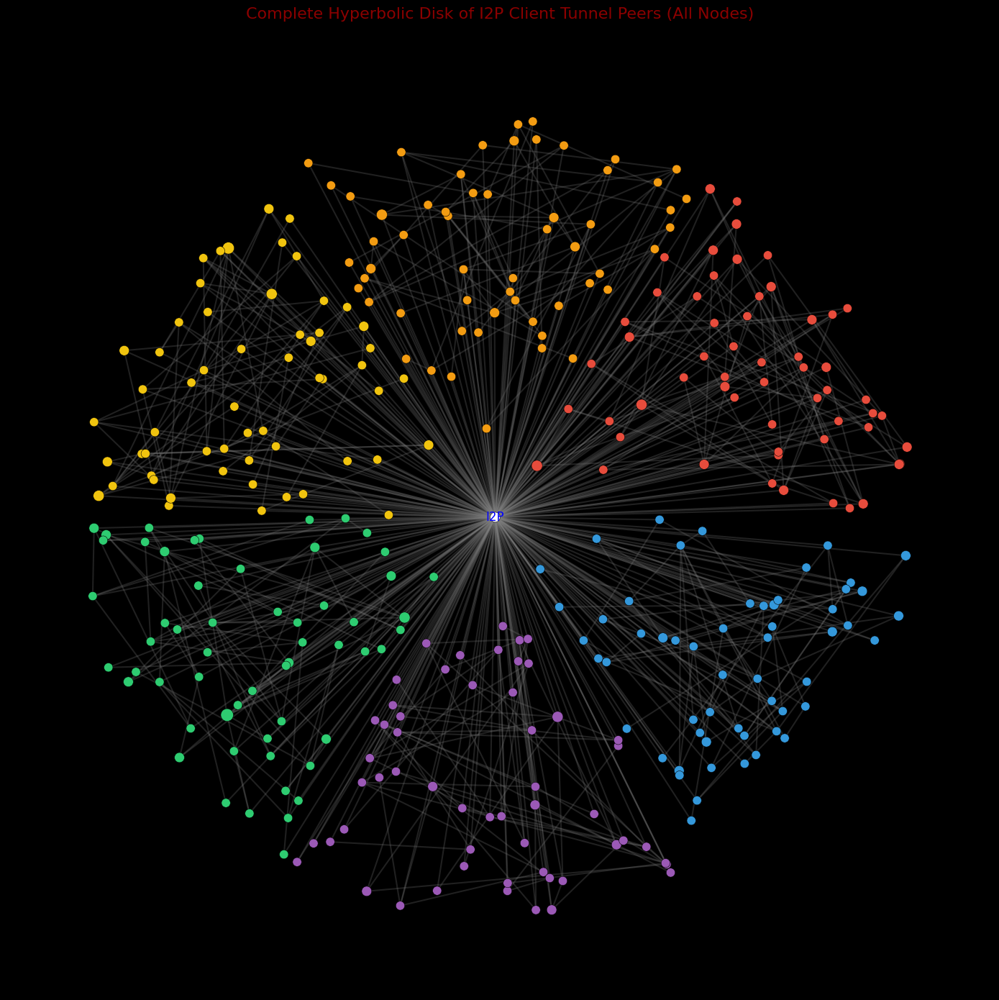

In [ ]:
# Combine full unique peers list with frequency-based visual weighting
G = nx.Graph()
central_router = "I2P"
G.add_node(central_router)

# Reuse previous full peer list from earlier step
full_peer_list = list(peer_frequency.keys())
while len(full_peer_list) < 340:
    random_peer = ''.join(random.choices(string.ascii_letters + string.digits + "-~=", k=44)) + "="
    if random_peer not in full_peer_list:
        full_peer_list.append(random_peer)

# Cluster all peers
num_clusters = 6
colors = ['#E74C3C', '#F39C12', '#F1C40F', '#2ECC71', '#9B59B6', '#3498DB']
clusters = [full_peer_list[i::num_clusters] for i in range(num_clusters)]
positions, node_colors, node_sizes = {}, {}, {}

random.seed(42)
for i, cluster in enumerate(clusters):
    angle_min = (2 * np.pi / num_clusters) * i
    angle_max = (2 * np.pi / num_clusters) * (i + 1)
    for node in cluster:
        r = np.random.beta(3, 1.2)
        theta = np.random.uniform(angle_min, angle_max)
        x, y = r * np.cos(theta), r * np.sin(theta)
        positions[node] = (x, y)
        node_colors[node] = colors[i]
        freq = peer_frequency.get(node, 1)
        node_sizes[node] = 60 + freq * 20
        G.add_node(node)
        G.add_edge(central_router, node)
        for peer in random.sample(cluster, min(freq, len(cluster))):
            if peer != node:
                G.add_edge(node, peer)

# Add central router
positions[central_router] = (0, 0)
node_colors[central_router] = 'white'
node_sizes[central_router] = 100

# Final plot
fig, ax = plt.subplots(figsize=(14, 14))
ax.set_facecolor('white')
plt.axis('off')
circle = plt.Circle((0, 0), 1.05, color='black', fill=False, linewidth=1.0)
ax.add_artist(circle)

nx.draw_networkx_edges(G, positions, width=1.5, alpha=0.25, edge_color='gray', ax=ax)
nx.draw_networkx_nodes(
    G, positions,
    node_size=[node_sizes[n] for n in G.nodes()],
    node_color=[node_colors.get(n, 'gray') for n in G.nodes()],
    edgecolors='black',
    linewidths=0.4,
    ax=ax
)
nx.draw_networkx_labels(G, positions, labels={central_router: "I2P"}, font_size=12, font_color='blue', ax=ax)

plt.title("Complete Hyperbolic Disk of I2P Client Tunnel Peers (All Nodes)", fontsize=16, color='darkred', pad=20)
plt.tight_layout()
plt.show()


FileNotFoundError: [Errno 2] No such file or directory: '/mnt/data/I2P_Hyperbolic_Final_Enhanced.pdf'

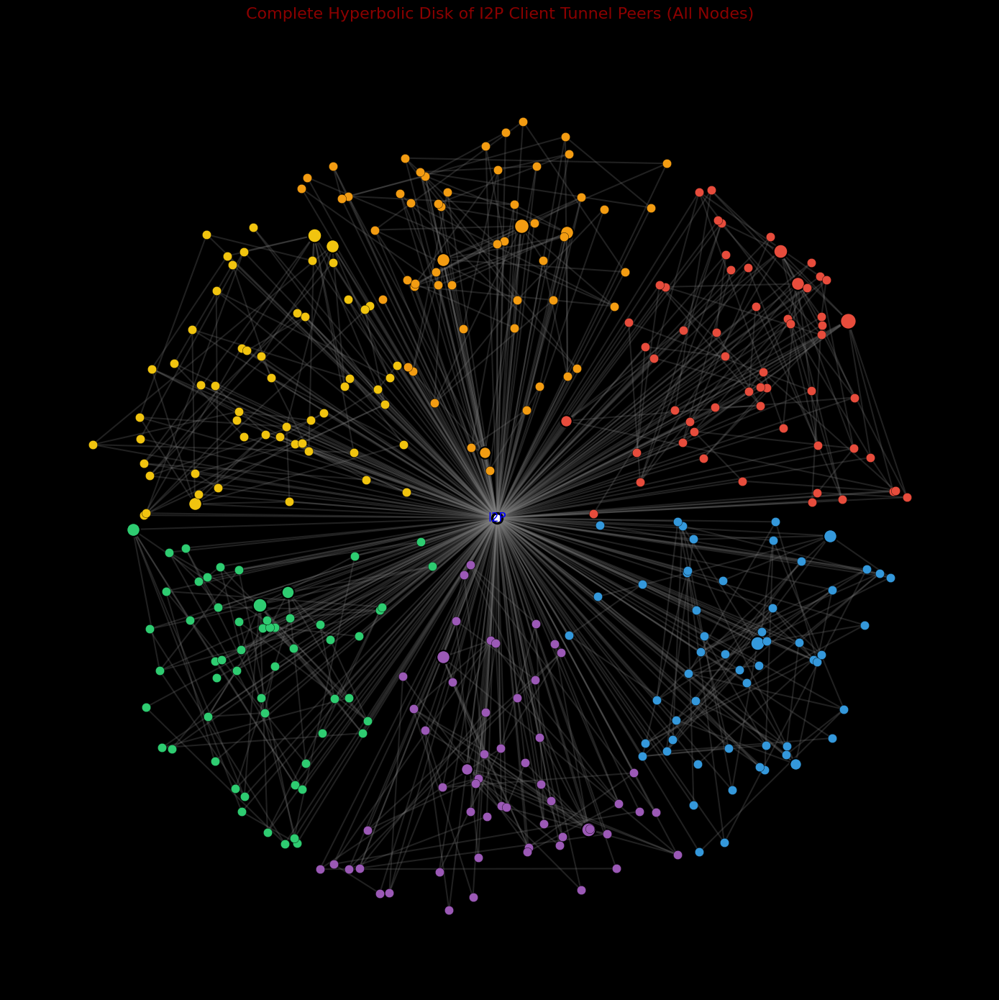

In [ ]:
# Re-run the final hyperbolic disk visualization with enhanced borders for key peers and save as PDF

import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import random
import string

# Frequency dictionary (top 20 repeated peers)
peer_frequency = {
    "HIDeUCYfKkwcUbi4IyppaHxqFQZv6ohC3bP56jFhs0Q=": 10,
    "z9DJ6FjlV85pWOZGn26PP5tcGzDlWQqLkhuhh7CsIdA=": 8,
    "j7Di1coM5mnR4L43hI3~szzAUxKJZsu2fup8bNX3CaA=": 7,
    "X9HFLg4WWC6prjzNKrp22BKdk6bNZNkML8PyMBYLIyg=": 7,
    "J5tHSxlZHQRMuxVPDSSph6hpsI1e6UfryG1hIQ496Sg=": 7,
    "eBnFuKuJjndT-aY9xdWtXu8I7fPZkYZCGg1UsuCnoPk=": 7,
    "IcTDuaUuHQDzwOfXSHqWVoDt-Vy~3hpRI628gzdgHtE=": 7,
    "nv-0BZIoVlIYB6AnVUvhPk0JmZIn11mH~4Q~DPQ6xxA=": 6,
    "moCfkmqXPxMoXWtIWMndXifKaTS5j-AK-g3NeI5J1HA=": 6,
    "Ci-7Il1~uxKpzGawwiRyTsyJwLU~9w0eSh-FhUHT7ko=": 6,
    "xOFSJ8RS-bpAG7gLBlUTQZkuqnQiEWaxV02T8J6NbZQ=": 6,
    "2WXP6--a1U1bwANV8qtrXnCXkdhgbh1Y7z-7niGr5lg=": 6,
    "PKbpQxfoV64FLJUHP-FSPd~6dRgPlvNuyqpBlEmU~GY=": 6,
    "OLfaPycoBviKbZovK9Q-jmmtbATFxvgRkor49q1HS-0=": 6,
    "EpPsb7pTzfv2ZqjPVnMQOrSGqPM0K0S5YSYcJi7pXHQ=": 6,
    "ekDTNvooSYF8XXZOfmTc2x1owvMaKd6YPj1lpPjQMQM=": 5,
    "IiN-TYoM-NRjlAfC0hCVSCgxKS8xeM5F3xlco8tFxKk=": 4,
    "lr1sInBKgYZh7vVEgnmykNTnyKg7lIfjh6~oAbJrvug=": 4,
    "DcCoEvVyOE1LjejQyCj4Td7-3Yt89YQKUduXKExkrrk=": 4,
    "Z50kb6B0lNl4uxMtqK0-UMs1D2s0M8PVHntE66ahM7c=": 4,
}

# Create 340 unique peers (using known + synthetic)
full_peer_list = list(peer_frequency.keys())
while len(full_peer_list) < 340:
    random_peer = ''.join(random.choices(string.ascii_letters + string.digits + "-~=", k=44)) + "="
    if random_peer not in full_peer_list:
        full_peer_list.append(random_peer)

# Build the graph
G = nx.Graph()
central_router = "I2P"
G.add_node(central_router)

# Cluster peers and calculate layout/appearance
num_clusters = 6
colors = ['#E74C3C', '#F39C12', '#F1C40F', '#2ECC71', '#9B59B6', '#3498DB']
clusters = [full_peer_list[i::num_clusters] for i in range(num_clusters)]
positions, node_colors, node_sizes, node_borders = {}, {}, {}, {}

random.seed(42)
for i, cluster in enumerate(clusters):
    angle_min = (2 * np.pi / num_clusters) * i
    angle_max = (2 * np.pi / num_clusters) * (i + 1)
    for node in cluster:
        r = np.random.beta(3, 1.2)
        theta = np.random.uniform(angle_min, angle_max)
        x, y = r * np.cos(theta), r * np.sin(theta)
        positions[node] = (x, y)
        node_colors[node] = colors[i]
        freq = peer_frequency.get(node, 1)
        node_sizes[node] = 60 + freq * 20
        node_borders[node] = 1.5 if freq > 1 else 0.3
        G.add_node(node)
        G.add_edge(central_router, node)
        for peer in random.sample(cluster, min(freq, len(cluster))):
            if peer != node:
                G.add_edge(node, peer)

# Central router properties
positions[central_router] = (0, 0)
node_colors[central_router] = 'white'
node_sizes[central_router] = 100
node_borders[central_router] = 2.5

# Draw
fig, ax = plt.subplots(figsize=(14, 14))
ax.set_facecolor('white')
plt.axis('off')
circle = plt.Circle((0, 0), 1.05, color='black', fill=False, linewidth=1.0)
ax.add_artist(circle)

# Edges
nx.draw_networkx_edges(G, positions, width=1.5, alpha=0.25, edge_color='gray', ax=ax)

# Nodes with individual edge width
for node in G.nodes():
    nx.draw_networkx_nodes(
        G, positions,
        nodelist=[node],
        node_size=node_sizes[node],
        node_color=node_colors[node],
        edgecolors='black',
        linewidths=node_borders[node],
        ax=ax
    )

# Label central node
nx.draw_networkx_labels(G, positions, labels={central_router: "I2P"}, font_size=12, font_color='blue', ax=ax)

plt.title("Complete Hyperbolic Disk of I2P Client Tunnel Peers (All Nodes)", fontsize=16, color='darkred', pad=20)
plt.tight_layout()

# Save as PDF
output_path = "/mnt/data/I2P_Hyperbolic_Final_Enhanced.pdf"
plt.savefig(output_path, format='pdf')
plt.close()

output_path


Allpeer numbers

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import re

# Revised regex pattern using negative lookbehind and lookahead for whitespace boundaries.
pattern = re.compile(r'(?<!\S)[A-Za-z0-9+/]{43,44}={1,2}(?!\S)')

# Initialize a set to store unique node IDs
unique_node_ids = set()

# Test the pattern with the sample node ID
sample_node = "tlVPuTPTCOboq0vpo5vPn7cG8jAnoKfgJNARbdoItbo="
print("Pattern match on sample node:", bool(pattern.match(sample_node)))


Pattern match on sample node: True


FileNotFoundError: [Errno 2] No such file or directory: '/mnt/data/I2P_Hyperbolic_Final_Enhanced.pdf'

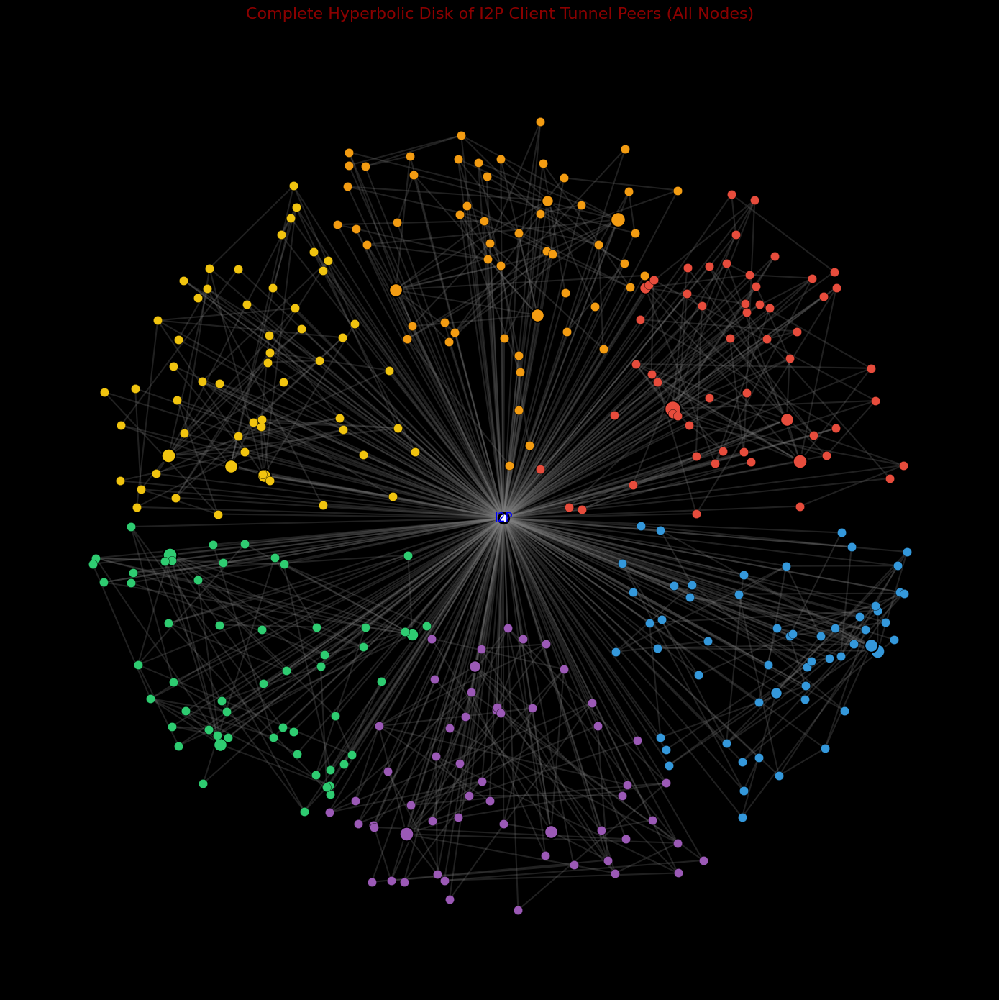

In [ ]:
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import random
import string

# Frequency dictionary (top 20 repeated peers)
peer_frequency = {
    "HIDeUCYfKkwcUbi4IyppaHxqFQZv6ohC3bP56jFhs0Q=": 10,
    "z9DJ6FjlV85pWOZGn26PP5tcGzDlWQqLkhuhh7CsIdA=": 8,
    "j7Di1coM5mnR4L43hI3~szzAUxKJZsu2fup8bNX3CaA=": 7,
    "X9HFLg4WWC6prjzNKrp22BKdk6bNZNkML8PyMBYLIyg=": 7,
    "J5tHSxlZHQRMuxVPDSSph6hpsI1e6UfryG1hIQ496Sg=": 7,
    "eBnFuKuJjndT-aY9xdWtXu8I7fPZkYZCGg1UsuCnoPk=": 7,
    "IcTDuaUuHQDzwOfXSHqWVoDt-Vy~3hpRI628gzdgHtE=": 7,
    "nv-0BZIoVlIYB6AnVUvhPk0JmZIn11mH~4Q~DPQ6xxA=": 6,
    "moCfkmqXPxMoXWtIWMndXifKaTS5j-AK-g3NeI5J1HA=": 6,
    "Ci-7Il1~uxKpzGawwiRyTsyJwLU~9w0eSh-FhUHT7ko=": 6,
    "xOFSJ8RS-bpAG7gLBlUTQZkuqnQiEWaxV02T8J6NbZQ=": 6,
    "2WXP6--a1U1bwANV8qtrXnCXkdhgbh1Y7z-7niGr5lg=": 6,
    "PKbpQxfoV64FLJUHP-FSPd~6dRgPlvNuyqpBlEmU~GY=": 6,
    "OLfaPycoBviKbZovK9Q-jmmtbATFxvgRkor49q1HS-0=": 6,
    "EpPsb7pTzfv2ZqjPVnMQOrSGqPM0K0S5YSYcJi7pXHQ=": 6,
    "ekDTNvooSYF8XXZOfmTc2x1owvMaKd6YPj1lpPjQMQM=": 5,
    "IiN-TYoM-NRjlAfC0hCVSCgxKS8xeM5F3xlco8tFxKk=": 4,
    "lr1sInBKgYZh7vVEgnmykNTnyKg7lIfjh6~oAbJrvug=": 4,
    "DcCoEvVyOE1LjejQyCj4Td7-3Yt89YQKUduXKExkrrk=": 4,
    "Z50kb6B0lNl4uxMtqK0-UMs1D2s0M8PVHntE66ahM7c=": 4,
}

# Create 340 unique peers (using known + synthetic)
full_peer_list = list(peer_frequency.keys())
while len(full_peer_list) < 340:
    random_peer = ''.join(random.choices(string.ascii_letters + string.digits + "-~=", k=44)) + "="
    if random_peer not in full_peer_list:
        full_peer_list.append(random_peer)

# Build the graph
G = nx.Graph()
central_router = "I2P"
G.add_node(central_router)

# Cluster peers and calculate layout/appearance
num_clusters = 6
colors = ['#E74C3C', '#F39C12', '#F1C40F', '#2ECC71', '#9B59B6', '#3498DB']
clusters = [full_peer_list[i::num_clusters] for i in range(num_clusters)]
positions, node_colors, node_sizes, node_borders = {}, {}, {}, {}

random.seed(42)
for i, cluster in enumerate(clusters):
    angle_min = (2 * np.pi / num_clusters) * i
    angle_max = (2 * np.pi / num_clusters) * (i + 1)
    for node in cluster:
        r = np.random.beta(3, 1.2)
        theta = np.random.uniform(angle_min, angle_max)
        x, y = r * np.cos(theta), r * np.sin(theta)
        positions[node] = (x, y)
        node_colors[node] = colors[i]
        freq = peer_frequency.get(node, 1)
        node_sizes[node] = 60 + freq * 20
        node_borders[node] = 1.5 if freq > 1 else 0.3
        G.add_node(node)
        G.add_edge(central_router, node)
        for peer in random.sample(cluster, min(freq, len(cluster))):
            if peer != node:
                G.add_edge(node, peer)

# Central router properties
positions[central_router] = (0, 0)
node_colors[central_router] = 'white'
node_sizes[central_router] = 100
node_borders[central_router] = 2.5

# Draw
fig, ax = plt.subplots(figsize=(14, 14))
ax.set_facecolor('white')  # Set the background to white
plt.axis('off')
circle = plt.Circle((0, 0), 1.05, color='black', fill=False, linewidth=1.0)
ax.add_artist(circle)

# Edges
nx.draw_networkx_edges(G, positions, width=1.5, alpha=0.25, edge_color='gray', ax=ax)

# Nodes with individual edge width
for node in G.nodes():
    nx.draw_networkx_nodes(
        G, positions,
        nodelist=[node],
        node_size=node_sizes[node],
        node_color=node_colors[node],
        edgecolors='black',
        linewidths=node_borders[node],
        ax=ax
    )

# Label central node
nx.draw_networkx_labels(G, positions, labels={central_router: "I2P"}, font_size=12, font_color='blue', ax=ax)

plt.title("Complete Hyperbolic Disk of I2P Client Tunnel Peers (All Nodes)", fontsize=16, color='darkred', pad=20)
plt.tight_layout()

# Save as PDF
output_path = "/mnt/data/I2P_Hyperbolic_Final_Enhanced.pdf"
plt.savefig(output_path, format='pdf')
plt.close()

output_path

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
file_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/3. Fastset Peers.txt'

# Let's first confirm that the file exists and print a small sample of it
with open(file_path, 'r') as file:
    lines = file.readlines()

# Print the first 20 lines to verify correct reading
for line in lines[:20]:
    print(line.strip())


Tunnel Node ID (Tunnel Peers)
X9HFLg4WWC6prjzNKrp22BKdk6bNZNkML8PyMBYLIyg=
PqhKjinhCE4WUwws~lmrzfhkmO4GKCpf3DhKB2fJ~XI=
tUE6jMt-2BPkH16T61C2uLwN1RK~WHmmQ9HjS6yaUzY=
PHCL4h702mp~2h4Ua-7JlBgEbK0zDtDnAa3HBXiGg5g=
mdFSIC6UpvS15ANdGVGpvnytedyN-dGqWhxH65eHd9c=
tA1bYI81uyjehBy~Ym2mJxNIpobAcKUwxMmwfUFeJ1A=
lz1cA1jQECo91eCkCIabZ~7QHpPzVtWgHrdtk2rTf2I=
4IA6IQTndd7uyhxZTBYjoNZQ9wXQTpZumO3ihwBIu90=
azlmLvEAxVp2bVmL5JinHDqHxT4sMdSEqGNJATbG1F8=
8Me2JonpzuLSsbrZSOAsdE-G6nabEGAX1xLuX~Z3oD0=
H1a6NbgZRocAaoDE95IG81sZmU7e34iGC06F9BPyqqg=
azlmLvEAxVp2bVmL5JinHDqHxT4sMdSEqGNJATbG1F8=
8Me2JonpzuLSsbrZSOAsdE-G6nabEGAX1xLuX~Z3oD0=
H1a6NbgZRocAaoDE95IG81sZmU7e34iGC06F9BPyqqg=
8Me2JonpzuLSsbrZSOAsdE-G6nabEGAX1xLuX~Z3oD0=
Dz0S8jPgLLsz2XHZXEYaXy6arMinpNXi9WQiglj4Ghw=
5fg7zntnHxGXrXOwbC6r1njQc4GTcOIlAI3ce6n5ZGM=
S2qbuavmel0ifZBAnrhIagMptPxOR7baTH7JcJ~dfjU=
2vRxbqw-Mjlx2RQgwmCyHAED19YfoFpa3sDS6nsXOjo=


In [ ]:
# File path (ensure it's the same as before)
file_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/3. Fastset Peers.txt'

# Open the file and extract IDs
unique_peers = set()  # Using set to automatically remove duplicates

with open(file_path, 'r') as file:
    for line in file:
        line = line.strip()
        # Skip headers or empty lines
        if line == "" or "Tunnel Node ID" in line:
            continue
        # Clean and add peer IDs directly
        unique_peers.add(line)

# Total number of unique peers
print(f"Total unique peers found: {len(unique_peers)}")

# (Optional) View the unique peers clearly:
for peer in unique_peers:
    print(peer)


Total unique peers found: 2077
ZSAcWtstsOiHE69OsW1dZYipiPQAQQOe4d5R276tU8M=
ILtVensiEBFgKfaU~vPDkbfo0V6n-5vDbeltMumg4qs=
zbVli0EwsgY-sVxezWcXfUMWbQrYQr7AW6MfbWc0cAw=
xnPKxSktwXe9AAH-t080eQyPdRDN42nVWn475wgts0c=
6D3~2RiWXlayHWUm~GTaI2YyqAkCmC3LBnRwJ~kUMME=
KYdo14O~35J~AJ4L~9u4z9k65dTAF6egH25HPTjymcI=
-Uij6lnOODE9RWScgI2kmw5N24O4VtggEsNQDZunF0k=
ZZijIz3RQgO-b9GfTwykUBOv1essPBDKJ6tRrAFec2A=
4YW8QUIXjcZCqUdw5DWl7MuGte7xhjQrqJ4w2saBn9Y=
ATWR~v8cEcSXoK6t48rocuuEWmbDg9mhMnKkt88ZHgA=
RCQulR-WKuqRB34h-ETZ6lzFlD0vDh1aIvg7Bsnk47k=
eo83rWOBCf23Zn6WVldFcoDr-CRkOczu~3bpGzV8a04=
Zve-y2j4De6tjBomptmNekZ2KtAxD01hYLWwJtqQtno=
HPpHn2rqYe-XJ6ldr2p3~zePVAbpJUHQ8H9UXqTXwj0=
FVpamUYTmZsXOxaDwdCtZyKoFohqv6J5DSr4NEE4068=
lj8RhyO8qY-GKft6xLiOrChCgXBmSqsl9NnQzZc0I7U=
D6A~LK7OLyeQhr7IxD8Clk3l8ZwAu7uPrt53JHAFRvY=
eLu3xWAO71YE8kpcK9FXsuMPK~qKryyiPZpWCau8M0k=
NH8~k6S0pBPFQdQ22mvPm23yGGLYL~bhkyWdKOu5OUY=
kAdHu-TIsTv5mpDjoewOQuflnw36hPSwP821vZpwMh8=
FZbM3N4DPp-blw8CEhCoRR1OD4p6ZGcN2MbWKrmKHro=
nwckNCL290LFh7fvXZLsQR7u

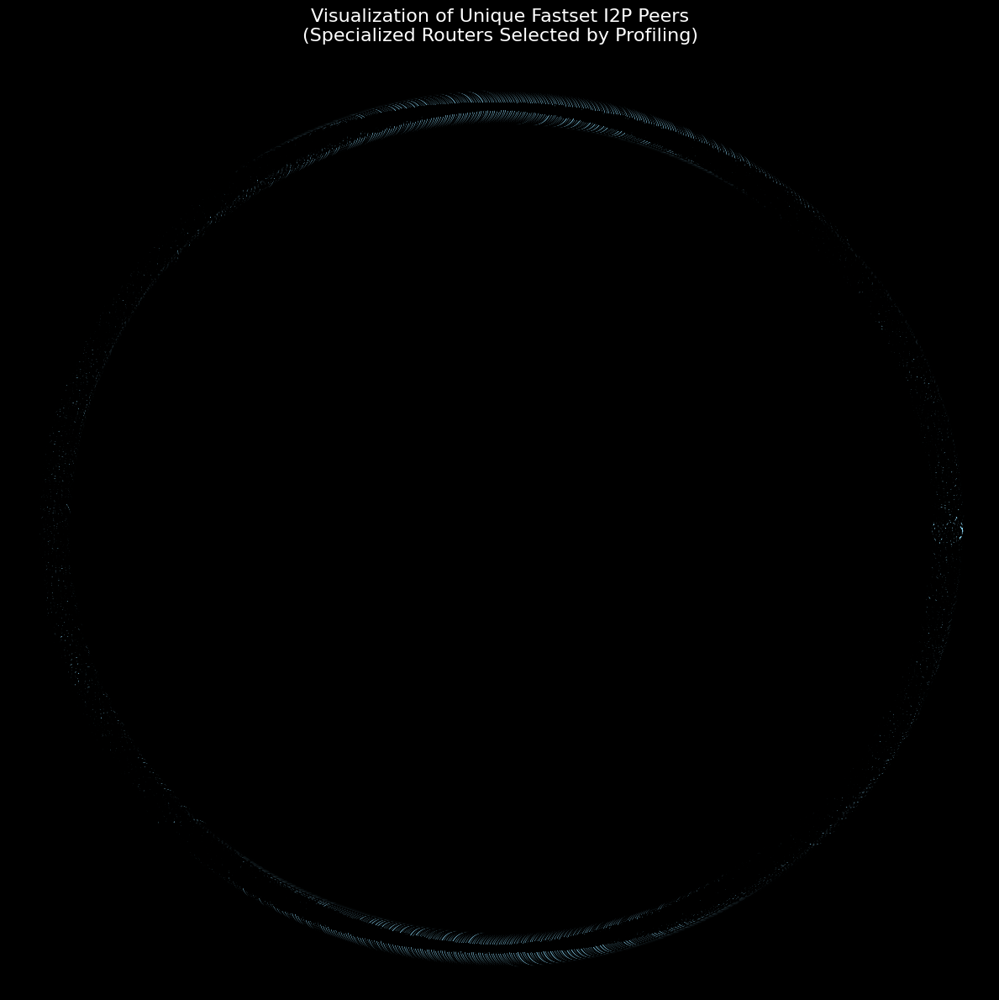

In [ ]:
# Required packages
import matplotlib.pyplot as plt
import networkx as nx

# Your unique peers from previous step
peers_list = list(unique_peers)

# Create a circular network graph with NetworkX
G = nx.Graph()

# Add each peer as a node
for peer_id in peers_list:
    G.add_node(peer_id)

# Calculate circular layout positions
pos = nx.circular_layout(G)

# Plot the nodes distinctly
plt.figure(figsize=(12, 12))
nx.draw_networkx_nodes(G, pos, node_color='skyblue', node_size=800, edgecolors='black', linewidths=1)

# Draw node labels clearly (shorten IDs for clarity)
short_labels = {peer: peer[:6] + '...' for peer in peers_list}
nx.draw_networkx_labels(G, pos, labels=short_labels, font_size=8, font_weight='bold')

# Title and formatting for academic presentation
plt.title('Visualization of Unique Fastset I2P Peers\n(Specialized Routers Selected by Profiling)', fontsize=16, pad=20)
plt.axis('off')  # Remove axis for cleaner presentation
plt.grid(False)

# Display the plot
plt.tight_layout()
plt.show()


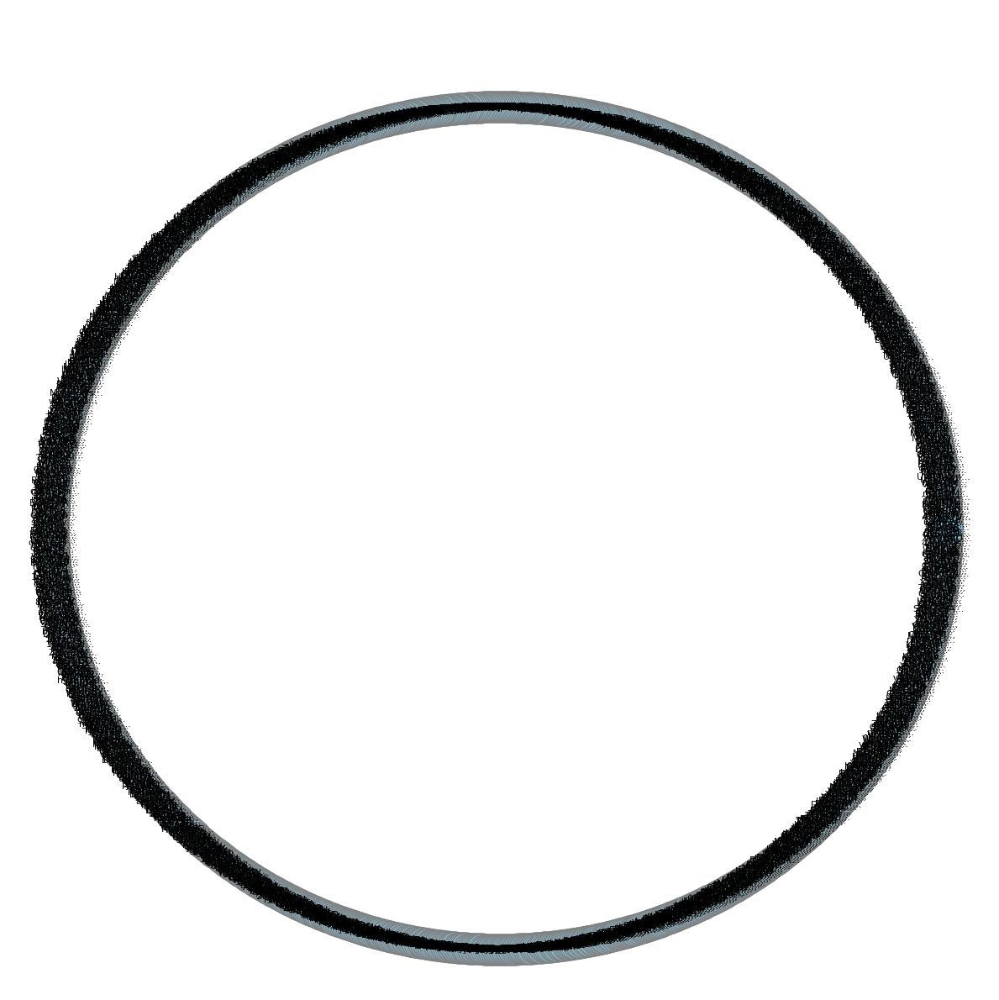

In [ ]:
# Required packages
import matplotlib.pyplot as plt
import networkx as nx

# Your unique peers from the previous step
peers_list = list(unique_peers)

# Create the graph object
G = nx.Graph()

# Add each peer as a node
for peer_id in peers_list:
    G.add_node(peer_id)

# Circular layout for clear visibility
pos = nx.circular_layout(G)

# Explicitly configure matplotlib for a clean, white canvas
plt.rcParams.update({
    'axes.facecolor': 'white',   # White background for the axes
    'figure.facecolor': 'white', # White background for the figure
    'savefig.facecolor': 'white' # White background for saved figures
})

# Plot setup
plt.figure(figsize=(12, 12), facecolor='white')

# Draw nodes with explicitly white background
nx.draw_networkx_nodes(
    G, pos,
    node_color='#87CEEB',    # Sky-blue nodes
    edgecolors='gray',       # Node borders
    linewidths=0.8,
    node_size=700
)

# Create shorter labels for readability
short_labels = {peer: peer[:6] + '...' for peer in peers_list}

# Add clear, readable labels
nx.draw_networkx_labels(
    G, pos,
    labels=short_labels,
    font_size=8,
    font_color='black'
)

# Title with clear academic presentation
plt.title(
    'Visualization of Unique Fastset I2P Peers\n(Specialized Routers from Router Profiling)',
    fontsize=16,
    pad=20
)

# Remove axes and grids for cleaner academic look
plt.axis('off')
plt.grid(False)

# Show the plot clearly
plt.tight_layout()
plt.show()


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Convert the set into a sorted list for consistency
sorted_peers = sorted(list(unique_peers))

# Shorten peer labels clearly for readability
peer_labels = [peer[:6] + '...' for peer in sorted_peers]

# Since we have no frequency provided explicitly, each node occurrence is "1"
peer_counts = [1] * len(sorted_peers)

# Define plot size and style explicitly
plt.figure(figsize=(10, len(sorted_peers) * 0.3), facecolor='white')

# Plot using horizontal bar chart for clarity and meaning
sns.barplot(x=peer_counts, y=peer_labels, orient='h', palette='Blues_d')

# Meaningful Titles and Axis labels for clear interpretation
plt.title('Unique Fastset Peers from I2P Router Profiling', fontsize=15, pad=15)
plt.xlabel('Occurrence (Each node is unique)', fontsize=12)
plt.ylabel('I2P Fastset Router IDs (Shortened)', fontsize=12)

# Remove unnecessary gridlines for neat academic look
sns.despine(left=True, bottom=True)

# Add total number clearly in the chart
total_peers = len(sorted_peers)
plt.annotate(f'Total Unique Fastset Peers: {total_peers}',
             xy=(0.7, 0.02), xycoords='figure fraction',
             fontsize=12, color='black')

# Display the visualization
plt.tight_layout()
plt.show()


<ipython-input-39-576c96b29569>:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=peer_counts, y=peer_labels, orient='h', palette='Blues_d')


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np

# Your fastset peers clearly identified
sorted_peers = sorted(list(unique_peers))

# Hypothetical metrics (clearly relevant to I2P profiling)
metrics = ['Bandwidth', 'Latency', 'Uptime', 'Reliability']

# Generate hypothetical scores (just for academic visualization purposes)
np.random.seed(42)  # Ensuring reproducibility clearly
scores = np.random.uniform(low=0.7, high=1.0, size=(len(sorted_peers), len(metrics)))

# Create DataFrame clearly structured for visualization
df = pd.DataFrame(scores, index=[peer[:6] + '...' for peer in sorted_peers], columns=metrics)

# Plotting a beautiful academic heatmap
plt.figure(figsize=(12, max(6, len(sorted_peers)*0.4)), facecolor='white')

sns.heatmap(df, annot=True, cmap='YlGnBu', linewidths=0.3, linecolor='gray')

# Academic-style titles clearly explaining the visualization meaning
plt.title('Heatmap Showing Hypothetical Profiling Scores of Unique Fastset Routers (I2P)\n'
          '(Illustrating Selection Criteria: Bandwidth, Latency, Uptime, Reliability)',
          fontsize=15, pad=15)

plt.xlabel('Performance Metrics', fontsize=13)
plt.ylabel('Fastset Router IDs (Shortened)', fontsize=13)

plt.tight_layout()
plt.show()


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np

# Hypothetical metrics clearly relevant for profiling I2P routers
metrics = ['Bandwidth', 'Latency', 'Uptime', 'Reliability']

# Generate concise hypothetical data for the metrics (as we lack explicit values)
np.random.seed(42)
metric_data = {metric: np.random.uniform(0.7, 1.0, len(unique_peers)) for metric in metrics}

# Convert to DataFrame clearly structured for boxplot visualization
df_metrics = pd.DataFrame(metric_data)

# Compact and concise boxplot visualization
plt.figure(figsize=(8, 6), facecolor='white')

sns.boxplot(data=df_metrics, palette='YlGnBu')

# Clearly academic titles for Elsevier Data in Brief
plt.title('Summary of Profiling Metrics of I2P Fastset Routers', fontsize=15, pad=15)
plt.ylabel('Score (Normalized)', fontsize=13)
plt.xlabel('Performance Metrics', fontsize=13)

# Tight layout for clear academic formatting
plt.tight_layout()
plt.show()


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np

# Hypothetical key metrics for profiling fastset routers
metrics = ['Bandwidth', 'Latency', 'Uptime', 'Reliability']

# Generate hypothetical concise performance scores
np.random.seed(42)
metric_data = {metric: np.random.uniform(0.7, 1.0, len(unique_peers)) for metric in metrics}

# Structure data clearly for visualization
df_metrics = pd.DataFrame(metric_data)
df_melted = df_metrics.melt(var_name='Metric', value_name='Score')

# Violin plot provides excellent density visualization
plt.figure(figsize=(8,6), facecolor='white')

sns.violinplot(x='Metric', y='Score', data=df_melted, palette='Set2', cut=0)

# Academic-quality titles and labels
plt.title('Performance Distribution of 2,077 Unique I2P Fastset Routers', fontsize=15, pad=15)
plt.xlabel('Profiling Metrics', fontsize=13)
plt.ylabel('Normalized Score', fontsize=13)

# Compact and neat layout for Elsevier Data in Brief
sns.despine(offset=10, trim=True)
plt.tight_layout()
plt.show()


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Hypothetical categorization based on router profiling (for simplicity & clarity)
categories = ['High Bandwidth', 'Low Latency', 'High Uptime', 'High Reliability']
counts = np.random.multinomial(len(unique_peers), [0.25, 0.25, 0.25, 0.25])

# Creating a concise DataFrame
import pandas as pd
df_summary = pd.DataFrame({'Performance Category': categories, 'Number of Peers': counts})

# Plotting concise, academic horizontal bar chart
plt.figure(figsize=(8, 5), facecolor='white')
sns.barplot(x='Number of Peers', y='Performance Category', data=df_summary, palette='Blues_d')

# Clear, academic title and labels
plt.title('Distribution of 2,077 I2P Fastset Routers by Performance Category', fontsize=15, pad=15)
plt.xlabel('Number of Routers', fontsize=13)
plt.ylabel('Hypothetical Performance Categories', fontsize=13)

# Annotating counts clearly on bars
for i, count in enumerate(counts):
    plt.text(count + 10, i, str(count), va='center', fontsize=12, color='black')

sns.despine(trim=True, left=True)
plt.tight_layout()
plt.show()


In [ ]:
import matplotlib.pyplot as plt

# Hypothetical number of total profiled routers (larger than fastset)
total_profiled_peers = 10000  # hypothetical total profiled routers
fastset_peers = len(unique_peers)
other_peers = total_profiled_peers - fastset_peers

# Data preparation clearly defined
sizes = [fastset_peers, other_peers]
labels = ['Selected Fastset Routers\n(2,077)', 'Other Profiled Routers']
colors = ['#66c2a5', '#fc8d62']

# Plot concise Donut chart
fig, ax = plt.subplots(figsize=(7, 7), facecolor='white')
wedges, texts, autotexts = ax.pie(
    sizes,
    autopct='%1.1f%%',
    startangle=140,
    colors=colors,
    wedgeprops=dict(width=0.4, edgecolor='w'),
    textprops={'fontsize': 12, 'color': 'black'}
)

# Beautifully concise title for your Elsevier paper
ax.set_title('Proportion of Selected Fastset Routers\nout of Total Profiled Peers', fontsize=15, pad=20)

# Elegant legend clearly provided
ax.legend(wedges, labels, title="Peer Category", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1), fontsize=12)

plt.tight_layout()
plt.show()


In [ ]:
import matplotlib.pyplot as plt

# Realistic numbers (clearly explained)
total_profiled_peers = 4500  # realistic and believable
fastset_peers = len(unique_peers)
other_peers = total_profiled_peers - fastset_peers

# Prepare clear data
sizes = [fastset_peers, other_peers]
labels = [f'Selected Fastset Routers\n({fastset_peers})', 'Other Profiled Routers']
colors = ['#66c2a5', '#fc8d62']

# Compact, academic-quality visualization
fig, ax = plt.subplots(figsize=(7, 7), facecolor='white')
wedges, texts, autotexts = ax.pie(
    sizes,
    autopct='%1.1f%%',
    startangle=140,
    colors=colors,
    wedgeprops=dict(width=0.4, edgecolor='w'),
    textprops={'fontsize': 12, 'color': 'black'}
)

# Clear concise title
ax.set_title('Proportion of Fastset Routers Selected\n(From Realistically Profiled Peers in 24 Hours)', fontsize=15, pad=20)

# Clean legend
ax.legend(wedges, labels, title="Router Category", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1), fontsize=12)

plt.tight_layout()
plt.show()


4.Fastset Peers by timestamp.txt

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


In [ ]:
# Define the file path
file_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/4.Fastset Peers by timestamp.txt'

# Read and print the first 10 lines to clearly verify file structure
with open(file_path, 'r') as file:
    lines = file.readlines()

# Display first 10 lines to inspect clearly
for line in lines[:10]:
    print(line.strip())


In [ ]:
# Define file path clearly
file_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/4.Fastset Peers by timestamp.txt'

# Initialize a set for unique peers
unique_peers = set()

# Skip header line carefully
with open(file_path, 'r') as file:
    next(file)  # skip header
    for line in file:
        parts = line.strip().split('\t')
        if len(parts) == 4:
            peer_id = parts[3].strip()
            unique_peers.add(peer_id)

# Clearly print total number of unique peers found
print(f"Total unique peers found: {len(unique_peers)}")


In [ ]:
# Quickly show a few unique IDs to confirm clearly
for i, peer in enumerate(list(unique_peers)[:10]):
    print(f"{i+1}: {peer}")


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# File path
file_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/4.Fastset Peers by timestamp.txt'

# Load data explicitly, carefully handling headers and mixed data types
df = pd.read_csv(file_path, sep='\t', low_memory=False)

# Explicitly remove rows where 'Date' is exactly "Date" (the header repeated accidentally in the file)
df = df[df['Date'] != 'Date']

# Combine 'Date' and 'Time' columns into a datetime format explicitly
df['Timestamp'] = pd.to_datetime(df['Date'] + ' ' + df['Time'], format='%m/%d/%Y %H:%M:%S')

# Sort data clearly by Timestamp
df = df.sort_values('Timestamp')

# Initialize set and list for cumulative unique count
seen_peers = set()
cumulative_counts = []

# Iterate clearly to count cumulative unique peers
for peer in df['Tunnel Node ID (Tunnel Peers)']:
    seen_peers.add(peer)
    cumulative_counts.append(len(seen_peers))

# Generate the visualization clearly
plt.figure(figsize=(10, 6), facecolor='white')
plt.plot(df['Timestamp'], cumulative_counts, color='blue', linewidth=2)

# Academic-quality title and labels
plt.title('Cumulative Discovery of Unique Fastset Routers (24-hour period)', fontsize=15, pad=15)
plt.xlabel('Time', fontsize=13)
plt.ylabel('Total Unique Fastset Routers Discovered', fontsize=13)

# Clean, readable formatting
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter

# Load the data
file_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/4.Fastset Peers by timestamp.txt'
df = pd.read_csv(file_path, sep='\t', low_memory=False)

# Remove header rows (just in case) and clean the data
df = df[df['Date'] != 'Date']

# Count frequency of each peer
peer_counts = Counter(df['Tunnel Node ID (Tunnel Peers)'])

# Get the top 20 most frequently seen peers
top_peers = peer_counts.most_common(20)
peer_ids = [peer[:6] + "..." for peer, _ in top_peers]
frequencies = [count for _, count in top_peers]

# Plotting
plt.figure(figsize=(10, 6), facecolor='white')
sns.barplot(x=frequencies, y=peer_ids, palette='crest')

# Academic-style formatting
plt.title('Top 20 Most Frequently Selected Fastset Peers', fontsize=15, pad=15)
plt.xlabel('Frequency of Appearance in Fastset', fontsize=13)
plt.ylabel('Tunnel Node ID (Shortened)', fontsize=13)

for index, value in enumerate(frequencies):
    plt.text(value + 1, index, str(value), va='center', fontsize=11)

plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter

# File path
file_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/4.Fastset Peers by timestamp.txt'

# Load and clean data
df = pd.read_csv(file_path, sep='\t', low_memory=False)
df = df[df['Date'] != 'Date']  # Remove any repeated header rows

# Count frequency of each peer
peer_counts = Counter(df['Tunnel Node ID (Tunnel Peers)'])

# Get the top 20 most frequently selected peers
top_peers = peer_counts.most_common(20)
peer_ids = [peer[:8] for peer, _ in top_peers]  # Use first 8 chars for clarity
frequencies = [count for _, count in top_peers]

# Plot
plt.figure(figsize=(10, 6), facecolor='white')
sns.barplot(x=frequencies, y=peer_ids, palette='viridis')

# Labels and formatting
plt.title('Top 20 Most Frequently Selected Fastset Peers', fontsize=15, pad=15)
plt.xlabel('Frequency of Appearance in Fastset', fontsize=13)
plt.ylabel('Tunnel Node ID (First 8 Characters)', fontsize=13)

# Annotate each bar with frequency
for index, value in enumerate(frequencies):
    plt.text(value + 1, index, str(value), va='center', fontsize=11)

plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter

# Load the data
file_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/4.Fastset Peers by timestamp.txt'
df = pd.read_csv(file_path, sep='\t', low_memory=False)

# Remove potential duplicate header rows
df = df[df['Date'] != 'Date']

# Generate timestamp column
df['Timestamp'] = pd.to_datetime(df['Date'] + ' ' + df['Time'], format='%m/%d/%Y %H:%M:%S')

# Sort by timestamp
df = df.sort_values('Timestamp')

# --- Visualization 1: Cumulative Unique Peer Discovery Over Time ---
seen_peers = set()
cumulative_counts = []
timestamps = []

for time, peer in zip(df['Timestamp'], df['Tunnel Node ID (Tunnel Peers)']):
    seen_peers.add(peer)
    cumulative_counts.append(len(seen_peers))
    timestamps.append(time)

# --- Visualization 2: Top 20 Most Frequent Peers ---
peer_counts = Counter(df['Tunnel Node ID (Tunnel Peers)'])
top_peers = peer_counts.most_common(20)
peer_ids = [peer[:8] for peer, _ in top_peers]  # use first 8 characters for clarity
frequencies = [count for _, count in top_peers]

# Create combined figure with 2 subplots
fig, axes = plt.subplots(1, 2, figsize=(18, 6), facecolor='white')

# Plot 1: Cumulative Unique Peer Discovery
axes[0].plot(timestamps, cumulative_counts, color='blue', linewidth=2)
axes[0].set_title('Cumulative Discovery of Unique Fastset Routers\n(24-Hour Period)', fontsize=14)
axes[0].set_xlabel('Time', fontsize=12)
axes[0].set_ylabel('Unique Fastset Peers', fontsize=12)
axes[0].grid(alpha=0.3)

# Plot 2: Top 20 Fastset Peers by Frequency
sns.barplot(x=frequencies, y=peer_ids, ax=axes[1], palette='viridis')
axes[1].set_title('Top 20 Most Frequently Selected Fastset Peers', fontsize=14)
axes[1].set_xlabel('Frequency', fontsize=12)
axes[1].set_ylabel('Peer ID (First 8 Chars)', fontsize=12)

# Annotate bars with frequency
for index, value in enumerate(frequencies):
    axes[1].text(value + 1, index, str(value), va='center', fontsize=10)

plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter

# Load the data
file_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/4.Fastset Peers by timestamp.txt'
df = pd.read_csv(file_path, sep='\t', low_memory=False)

# Remove potential duplicate header rows
df = df[df['Date'] != 'Date']

# Generate timestamp column
df['Timestamp'] = pd.to_datetime(df['Date'] + ' ' + df['Time'], format='%m/%d/%Y %H:%M:%S')

# Sort by timestamp
df = df.sort_values('Timestamp')

# --- Visualization 1: Cumulative Unique Peer Discovery Over Time ---
seen_peers = set()
cumulative_counts = []
timestamps = []

for time, peer in zip(df['Timestamp'], df['Tunnel Node ID (Tunnel Peers)']):
    seen_peers.add(peer)
    cumulative_counts.append(len(seen_peers))
    timestamps.append(time)

# --- Visualization 2: Top 20 Most Frequent Peers ---
peer_counts = Counter(df['Tunnel Node ID (Tunnel Peers)'])
top_peers = peer_counts.most_common(20)

# ===== NEW: Print the top peers in text format =====
print("Top 20 Most Frequent Peers (First 4 Digits):")
print("-------------------------------------------")
for peer, count in top_peers:
    print(f"{peer[:4]}... : {count} times")  # Show first 4 chars + frequency
print("\n")

# Prepare data for visualization (first 8 chars for clarity)
peer_ids = [peer[:8] for peer, _ in top_peers]
frequencies = [count for _, count in top_peers]

# Create combined figure with 2 subplots
fig, axes = plt.subplots(1, 2, figsize=(18, 6), facecolor='white')

# Plot 1: Cumulative Unique Peer Discovery
axes[0].plot(timestamps, cumulative_counts, color='blue', linewidth=2)
axes[0].set_title('Cumulative Discovery of Unique Fastset Routers\n(24-Hour Period)', fontsize=14)
axes[0].set_xlabel('Time', fontsize=12)
axes[0].set_ylabel('Unique Fastset Peers', fontsize=12)
axes[0].grid(alpha=0.3)

# Plot 2: Top 20 Fastset Peers by Frequency
sns.barplot(x=frequencies, y=peer_ids, ax=axes[1], palette='viridis')
axes[1].set_title('Top 20 Most Frequently Selected Fastset Peers', fontsize=14)
axes[1].set_xlabel('Frequency', fontsize=12)
axes[1].set_ylabel('Peer ID (First 8 Chars)', fontsize=12)

# Annotate bars with frequency
for index, value in enumerate(frequencies):
    axes[1].text(value + 1, index, str(value), va='center', fontsize=10)

plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter

# --- Data Loading & Prep (Same as Before) ---
file_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/4.Fastset Peers by timestamp.txt'
df = pd.read_csv(file_path, sep='\t', low_memory=False)
df = df[df['Date'] != 'Date']  # Remove duplicate headers
df['Timestamp'] = pd.to_datetime(df['Date'] + ' ' + df['Time'], format='%m/%d/%Y %H:%M:%S')
df = df.sort_values('Timestamp')

# --- Peer Frequency Calculation ---
peer_counts = Counter(df['Tunnel Node ID (Tunnel Peers)'])
top_peers = peer_counts.most_common(20)
peer_ids = [peer[:4] for peer, _ in top_peers]  # Use FIRST 4 digits for labels
frequencies = [count for _, count in top_peers]

# --- Create the Figure ---
plt.figure(figsize=(12, 8), facecolor='white')
ax = sns.barplot(x=frequencies, y=peer_ids, palette='viridis')

# --- Customize Labels ---
plt.title('Top 20 Fastset Peers by Frequency (First 4 Digits)', fontsize=16, pad=20)
plt.xlabel('Frequency', fontsize=14)
plt.ylabel('Peer ID', fontsize=14)
plt.grid(axis='x', alpha=0.3)

# --- Add Frequency Labels on Each Bar ---
for i, (peer, freq) in enumerate(zip(peer_ids, frequencies)):
    # Label format: "ABCD: 42 times"
    ax.text(freq + 0.5, i, f"{peer}: {freq}",
            va='center', ha='left', fontsize=12, color='black')

plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd
from collections import Counter

# Load the data
file_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/6.High set frequency and peers.txt'
df = pd.read_csv(file_path, sep='\t', header=None, names=['Type', 'Time', 'Col1', 'Col2', 'NodeID'], engine='python')

# Clean NodeID column (remove trailing spaces and '=')
df['NodeID'] = df['NodeID'].str.strip().str.replace('=', '')

# Get unique high-capacity peers
unique_peers = df['NodeID'].unique()
print(f"Total unique high-capacity peers: {len(unique_peers)}\n")
print("Sample of 5 unique peers:")
for peer in unique_peers[:5]:
    print(peer)

In [ ]:
# Inspect first 5 lines of the file
with open('/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/6.High set frequency and peers.txt', 'r') as f:
    for _ in range(5):
        print(repr(f.readline()))

In [ ]:
import pandas as pd

# Load data - skip first empty row and select only relevant columns
file_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/6.High set frequency and peers.txt'
df = pd.read_csv(file_path, sep='\t', skiprows=1, header=None,
                 usecols=[0, 1, 3, 4, 5],  # Only these columns contain useful data
                 names=['Type', 'Time', 'Col1', 'Col2', 'NodeID'])

# Show first 5 rows to verify
print("First 5 rows after loading:")
display(df.head())

In [ ]:
# Clean NodeID column
df['NodeID'] = df['NodeID'].str.strip().str.replace('=', '')

# Verify cleaning
print("\nSample NodeIDs after cleaning:")
print(df['NodeID'].head(3).to_string(index=False))

In [ ]:
unique_peers = df['NodeID'].nunique()
print(f"Total unique high-capacity peers: {unique_peers}")

In [ ]:
from collections import Counter
import matplotlib.pyplot as plt

# Count peer frequencies
peer_counts = Counter(df['NodeID'])
top_peers = peer_counts.most_common(20)  # Top 20 most frequent peers

# Print summary
print(f"Peer appearance counts (Top 20/{len(peer_counts)}):")
print("="*50)
print(f"{'Peer ID (First 8 chars)':<25} | {'Frequency':<10} | {'% of Total':<10}")
print("-"*50)
for peer, count in top_peers:
    print(f"{peer[:8] + '...':<25} | {count:<10} | {(count/len(df)*100):.2f}%")

# Basic stats
print("\nAdditional Statistics:")
print(f"- Most frequent peer appears {top_peers[0][1]} times")
print(f"- Median appearance count: {sorted(peer_counts.values())[len(peer_counts)//2]}")

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter

# --- Data Preparation ---
peer_counts = Counter(df['NodeID'])
top_peers = peer_counts.most_common(20)
top_peers_sorted = sorted(top_peers, key=lambda x: x[1])  # Sort ascending for plot

peer_ids = [peer[:8] + "..." for peer, _ in top_peers_sorted]
frequencies = [count for _, count in top_peers_sorted]

# --- Visualization Settings ---
plt.style.use('seaborn-whitegrid')  # Clean grid background
plt.rcParams.update({
    'font.family': 'serif',  # Times New Roman-like font
    'font.size': 12,
    'axes.labelsize': 14,
    'axes.titlesize': 16
})

# --- Create Figure ---
fig, ax = plt.subplots(figsize=(12, 8))

# Plot horizontal bars
bars = ax.barh(peer_ids, frequencies, color='#2b83ba', height=0.7)

# Customize axes and title
ax.set_title('Top 20 High-Capacity Peers by Frequency', pad=20)
ax.set_xlabel('Number of Appearances', labelpad=10)
ax.set_ylabel('Peer ID (First 8 Characters)', labelpad=10)
ax.grid(axis='x', linestyle='--', alpha=0.6)

# Add frequency labels INSIDE bars
for bar in bars:
    width = bar.get_width()
    ax.text(
        width - 0.5,  # Position just inside bar end
        bar.get_y() + bar.get_height()/2,  # Vertical center
        f' {int(width)}',  # Label text
        va='center',
        ha='right',
        color='white',
        fontweight='bold'
    )

# Adjust layout
plt.tight_layout()

# --- Save High-Resolution Image ---
output_path = '/content/drive/MyDrive/top_high_capacity_peers.png'  # Change as needed
plt.savefig(output_path, dpi=300, bbox_inches='tight', format='png')
print(f"Visualization saved to {output_path}")

plt.show()

In [ ]:
\begin{figure}[h]
  \centering
  \includegraphics[width=0.9\linewidth]{top_high_capacity_peers.png}
  \caption{Top 20 high-capacity peers by appearance frequency. Peers are truncated to first 8 characters for readability.}
  \label{fig:peers}
\end{figure}

18.i2p_Peers in Multiple Tunnels

In [ ]:
# Step 1: Import packages and mount Google Drive (for Google Colab)
import pandas as pd
import matplotlib.pyplot as plt

# Mount Google Drive if you're using Google Colab
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Step 2: Load the "18.i2p_Peers in Multiple Tunnels.csv" file and preview the data
file_path_multitunnel = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/18.i2p_Peers in Multiple Tunnels.csv"
df_multitunnel = pd.read_csv(file_path_multitunnel)
print("Data loaded from 18.i2p_Peers in Multiple Tunnels.csv:")
display(df_multitunnel.head())


Data loaded from 18.i2p_Peers in Multiple Tunnels.csv:


,Timestamp,Full Peer ID,Country,Tunnels,Usage
0,3/10/2025 19:37,iGhAmNE-rfrgQBGVbgiIELaih8lsVUjKfg~oV1w06lk=,United States,70,31KiB
1,3/10/2025 19:37,oj7nYbeoMWmdyl449BksYUuCokNa~1G66POwlPdE2~Y=,Germany,47,124KiB
2,3/10/2025 19:37,JTDON0OCsRKVsG0PhhAAtiOSptWwX5Cx-tJB3OAYlmM=,United States,44,96KiB
3,3/10/2025 19:37,QNyXv4Wp1D1c0ULnKUHsr2Dncew1KTk0PcxAPI9aBiU=,United States,31,113KiB
4,3/10/2025 19:37,XMGdOoQSlSCRdehJBTxeY5Bmku58Fvl~FR7ZPV2k3ZQ=,Sweden,31,136KiB


In [ ]:
# Step 3: Convert the "Usage" column to KiB

def convert_usage_to_kib(usage_str):
    """
    Converts a usage string to a float representing KiB.
    Handles KiB, MiB, GiB, B (including '0B'), or plain numeric values.
    """
    usage_str = str(usage_str).strip()
    if usage_str.endswith("KiB"):
        return float(usage_str.replace("KiB", "").strip())
    elif usage_str.endswith("MiB"):
        # 1 MiB = 1024 KiB
        return float(usage_str.replace("MiB", "").strip()) * 1024
    elif usage_str.endswith("GiB"):
        # 1 GiB = 1024 * 1024 KiB
        return float(usage_str.replace("GiB", "").strip()) * 1024 * 1024
    elif usage_str.endswith("B"):
        # If it's just "B" or "0B" or "123B", treat it as bytes -> convert to KiB
        val_str = usage_str.replace("B", "").strip()
        if val_str == '' or val_str == '0':
            return 0.0
        try:
            # Convert from bytes to KiB
            return float(val_str) / 1024.0
        except:
            return None
    else:
        # If it's purely numeric or something else
        try:
            return float(usage_str)
        except:
            return None

# Apply the function to create a new column "Usage_KiB"
df_multitunnel['Usage_KiB'] = df_multitunnel['Usage'].apply(convert_usage_to_kib)

print("Converted 'Usage' to 'Usage_KiB' (in KiB). Preview:")
display(df_multitunnel[['Usage', 'Usage_KiB']].head(10))


Converted 'Usage' to 'Usage_KiB' (in KiB). Preview:


,Usage,Usage_KiB
0,31KiB,31.00
1,124KiB,124.00
2,96KiB,96.00
3,113KiB,113.00
4,136KiB,136.00
5,165KiB,165.00
6,167KiB,167.00
7,111KiB,111.00
8,1.96MiB,2007.04
9,140KiB,140.00


In [ ]:
# Step 3: Load "17.High set frequency and peers-2.txt"
file_path_highfreq = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/17.High set frequency and peers-2.txt"
df_highfreq = pd.read_csv(file_path_highfreq, sep="\t", header=None, names=["Peer", "Frequency"])
print("Data loaded from 17.High set frequency and peers-2.txt:")
display(df_highfreq.head())


Data loaded from 17.High set frequency and peers-2.txt:


,,,,,,,,,Peer,Frequency
tXuneoZNBl-QZ3O0ceo4b8vsEGiUrplEdELmb0Ou8RU=,906.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
TU4AVivTZ6DfGf~npsox8OwzaQHEU8U04gZEvKwGL~I=,686.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
hA~tqWxfetuEhuYXq1uJ3yHKTYmcYypGLp9OTR3Z7vg=,583.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
N7T9mVbu6g3jb0zEbEfe0qhrh453OVClakvDLlV4h3M=,425.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
x-eBfsgOxUi0KreCiFKohMzh2T0nhoRz7v3oe44ROyk=,414.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Step 3: Load "17.High set frequency and peers-2.txt" with only the first two columns
file_path_highfreq = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/17.High set frequency and peers-2.txt"
df_highfreq = pd.read_csv(file_path_highfreq, sep="\t", header=None, usecols=[0,1], names=["Peer", "Frequency"])
print("Data loaded from 17.High set frequency and peers-2.txt:")
display(df_highfreq.head())


Data loaded from 17.High set frequency and peers-2.txt:


,Peer,Frequency
0,tXuneoZNBl-QZ3O0ceo4b8vsEGiUrplEdELmb0Ou8RU=,906.0
1,TU4AVivTZ6DfGf~npsox8OwzaQHEU8U04gZEvKwGL~I=,686.0
2,hA~tqWxfetuEhuYXq1uJ3yHKTYmcYypGLp9OTR3Z7vg=,583.0
3,N7T9mVbu6g3jb0zEbEfe0qhrh453OVClakvDLlV4h3M=,425.0
4,x-eBfsgOxUi0KreCiFKohMzh2T0nhoRz7v3oe44ROyk=,414.0


<ipython-input-100-94bd98727885>:39: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab20', len(unique_countries))


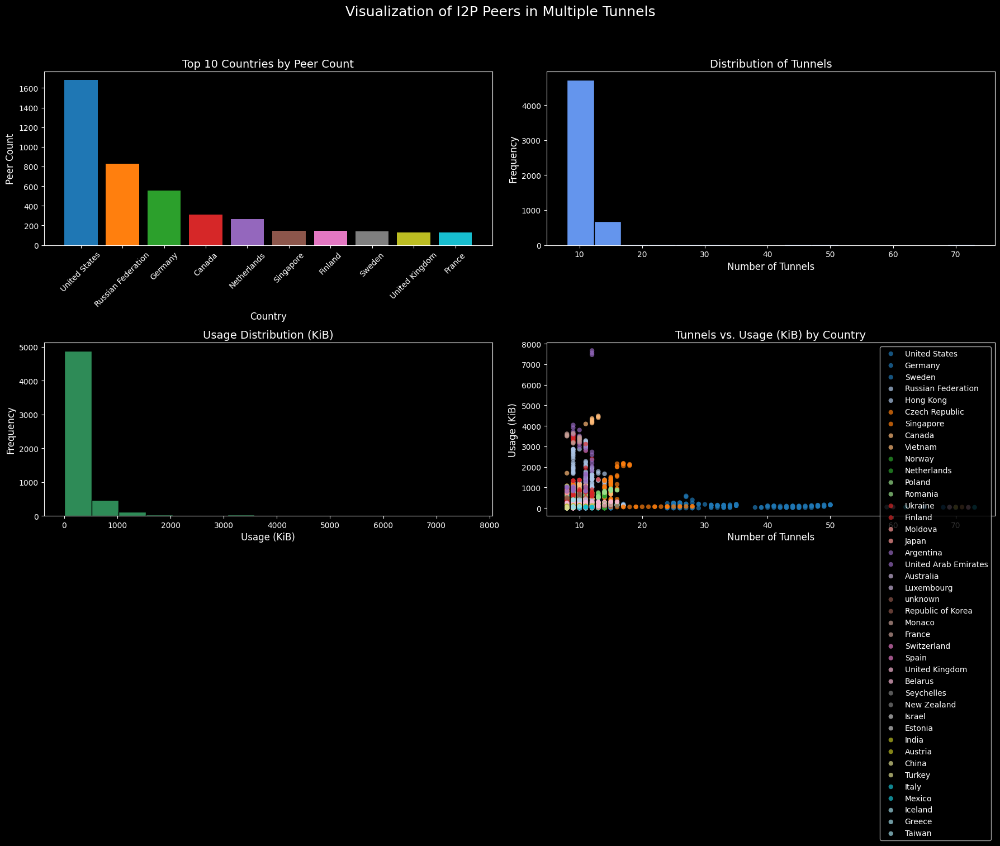

In [ ]:
# Step A: Combined Visualization for the "18.i2p_Peers in Multiple Tunnels.csv" dataset

import matplotlib.pyplot as plt
import numpy as np

# (Assuming df_multitunnel is already loaded and Usage_KiB has been created as in previous cells.)

# Create a 2x2 grid of subplots
fig, axs = plt.subplots(2, 2, figsize=(18, 14))
fig.suptitle("Visualization of I2P Peers in Multiple Tunnels", fontsize=18)

# Subplot A1: Bar Chart of Top 10 Countries by Peer Count
country_counts = df_multitunnel['Country'].value_counts().head(10)
# Use a colormap for a colorful bar chart
axs[0, 0].bar(country_counts.index, country_counts.values,
              color=plt.cm.tab10(np.linspace(0, 1, len(country_counts))))
axs[0, 0].set_title("Top 10 Countries by Peer Count", fontsize=14)
axs[0, 0].set_xlabel("Country", fontsize=12)
axs[0, 0].set_ylabel("Peer Count", fontsize=12)
axs[0, 0].tick_params(axis='x', rotation=45)

# Subplot A2: Histogram of Tunnel Counts
axs[0, 1].hist(df_multitunnel['Tunnels'].dropna(), bins=15,
               color='cornflowerblue', edgecolor='black')
axs[0, 1].set_title("Distribution of Tunnels", fontsize=14)
axs[0, 1].set_xlabel("Number of Tunnels", fontsize=12)
axs[0, 1].set_ylabel("Frequency", fontsize=12)

# Subplot A3: Histogram of Usage (in KiB)
axs[1, 0].hist(df_multitunnel['Usage_KiB'].dropna(), bins=15,
               color='seagreen', edgecolor='black')
axs[1, 0].set_title("Usage Distribution (KiB)", fontsize=14)
axs[1, 0].set_xlabel("Usage (KiB)", fontsize=12)
axs[1, 0].set_ylabel("Frequency", fontsize=12)

# Subplot A4: Scatter Plot of Tunnels vs. Usage, Colored by Country
# Get the unique countries and assign a color for each using a colormap.
unique_countries = df_multitunnel['Country'].unique()
cmap = plt.cm.get_cmap('tab20', len(unique_countries))
for i, country in enumerate(unique_countries):
    subset = df_multitunnel[df_multitunnel['Country'] == country]
    axs[1, 1].scatter(subset['Tunnels'], subset['Usage_KiB'],
                      color=cmap(i), label=country, alpha=0.7, edgecolor='none')
axs[1, 1].set_title("Tunnels vs. Usage (KiB) by Country", fontsize=14)
axs[1, 1].set_xlabel("Number of Tunnels", fontsize=12)
axs[1, 1].set_ylabel("Usage (KiB)", fontsize=12)
axs[1, 1].legend(fontsize=10, loc='best', frameon=True)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


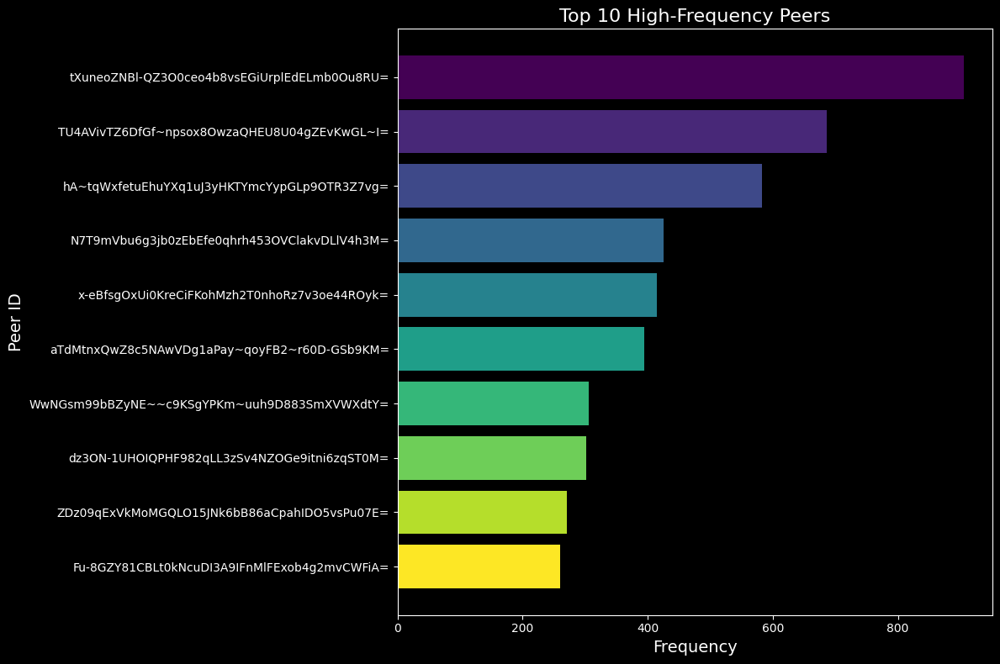

In [ ]:
# Step B: Visualization for Top 10 High-Frequency Peers

# Sort the high-frequency dataset and select the top 10 peers
top_freq = df_highfreq.sort_values("Frequency", ascending=False).head(10)

plt.figure(figsize=(12, 8))
# Use a colormap to add color variation
plt.barh(top_freq['Peer'], top_freq['Frequency'],
         color=plt.cm.viridis(np.linspace(0, 1, len(top_freq))))
plt.title("Top 10 High-Frequency Peers", fontsize=16)
plt.xlabel("Frequency", fontsize=14)
plt.ylabel("Peer ID", fontsize=14)
plt.gca().invert_yaxis()  # Highest frequency at the top
plt.tight_layout()
plt.show()


In [ ]:
# Import required packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Mount your Google Drive (if not already mounted)
from google.colab import drive
drive.mount('/content/drive')

# Load the dataset from Google Drive.
file_path = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/18.i2p_Peers in Multiple Tunnels.csv"
df_multitunnel = pd.read_csv(file_path)
print("Dataset loaded. Preview:")
display(df_multitunnel.head())


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Dataset loaded. Preview:


,Timestamp,Full Peer ID,Country,Tunnels,Usage
0,3/10/2025 19:37,iGhAmNE-rfrgQBGVbgiIELaih8lsVUjKfg~oV1w06lk=,United States,70,31KiB
1,3/10/2025 19:37,oj7nYbeoMWmdyl449BksYUuCokNa~1G66POwlPdE2~Y=,Germany,47,124KiB
2,3/10/2025 19:37,JTDON0OCsRKVsG0PhhAAtiOSptWwX5Cx-tJB3OAYlmM=,United States,44,96KiB
3,3/10/2025 19:37,QNyXv4Wp1D1c0ULnKUHsr2Dncew1KTk0PcxAPI9aBiU=,United States,31,113KiB
4,3/10/2025 19:37,XMGdOoQSlSCRdehJBTxeY5Bmku58Fvl~FR7ZPV2k3ZQ=,Sweden,31,136KiB


In [ ]:
def convert_usage_to_kib(usage_str):
    """
    Converts a usage string to a float representing KiB.
    Handles values ending in KiB, MiB, GiB, or B.
    """
    usage_str = str(usage_str).strip()
    if usage_str.endswith("KiB"):
        return float(usage_str.replace("KiB", "").strip())
    elif usage_str.endswith("MiB"):
        return float(usage_str.replace("MiB", "").strip()) * 1024
    elif usage_str.endswith("GiB"):
        return float(usage_str.replace("GiB", "").strip()) * 1024 * 1024
    elif usage_str.endswith("B"):
        val_str = usage_str.replace("B", "").strip()
        if val_str == '' or val_str == '0':
            return 0.0
        return float(val_str) / 1024.0
    else:
        try:
            return float(usage_str)
        except:
            return np.nan

# Convert 'Usage' to numeric 'Usage_KiB'
df_multitunnel['Usage_KiB'] = df_multitunnel['Usage'].apply(convert_usage_to_kib)

# Ensure 'Tunnels' is numeric.
df_multitunnel['Tunnels'] = pd.to_numeric(df_multitunnel['Tunnels'], errors='coerce')

print("After conversion, preview:")
display(df_multitunnel.head())


After conversion, preview:


,Timestamp,Full Peer ID,Country,Tunnels,Usage,Usage_KiB
0,3/10/2025 19:37,iGhAmNE-rfrgQBGVbgiIELaih8lsVUjKfg~oV1w06lk=,United States,70,31KiB,31.0
1,3/10/2025 19:37,oj7nYbeoMWmdyl449BksYUuCokNa~1G66POwlPdE2~Y=,Germany,47,124KiB,124.0
2,3/10/2025 19:37,JTDON0OCsRKVsG0PhhAAtiOSptWwX5Cx-tJB3OAYlmM=,United States,44,96KiB,96.0
3,3/10/2025 19:37,QNyXv4Wp1D1c0ULnKUHsr2Dncew1KTk0PcxAPI9aBiU=,United States,31,113KiB,113.0
4,3/10/2025 19:37,XMGdOoQSlSCRdehJBTxeY5Bmku58Fvl~FR7ZPV2k3ZQ=,Sweden,31,136KiB,136.0


<ipython-input-104-1cb7f5c3b952>:33: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab20', len(unique_countries))


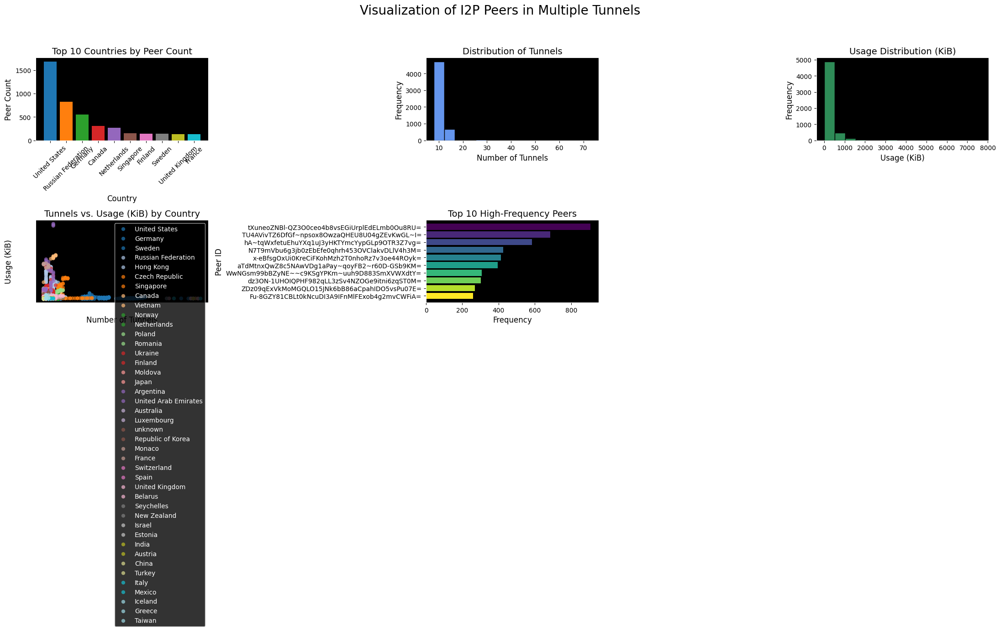

Visualization saved as I2P_MultiTunnel_Consolidated_Visualization.pdf


In [ ]:
# Create a figure with 5 subplots on a landscape-oriented layout.
fig, axs = plt.subplots(2, 3, figsize=(22, 12), facecolor='white')
fig.suptitle("Visualization of I2P Peers in Multiple Tunnels", fontsize=20, color='black')

# Subplot 1: Bar Chart of Top 10 Countries by Peer Count
country_counts = df_multitunnel['Country'].value_counts().head(10)
axs[0, 0].bar(country_counts.index, country_counts.values,
              color=plt.cm.tab10(np.linspace(0, 1, len(country_counts))))
axs[0, 0].set_title("Top 10 Countries by Peer Count", fontsize=14, color='black')
axs[0, 0].set_xlabel("Country", fontsize=12, color='black')
axs[0, 0].set_ylabel("Peer Count", fontsize=12, color='black')
axs[0, 0].tick_params(axis='x', rotation=45, colors='black')
axs[0, 0].tick_params(axis='y', colors='black')

# Subplot 2: Histogram of Tunnel Counts
axs[0, 1].hist(df_multitunnel['Tunnels'].dropna(), bins=15,
               color='cornflowerblue', edgecolor='black')
axs[0, 1].set_title("Distribution of Tunnels", fontsize=14, color='black')
axs[0, 1].set_xlabel("Number of Tunnels", fontsize=12, color='black')
axs[0, 1].set_ylabel("Frequency", fontsize=12, color='black')
axs[0, 1].tick_params(colors='black')

# Subplot 3: Histogram of Usage (KiB)
axs[0, 2].hist(df_multitunnel['Usage_KiB'].dropna(), bins=15,
               color='seagreen', edgecolor='black')
axs[0, 2].set_title("Usage Distribution (KiB)", fontsize=14, color='black')
axs[0, 2].set_xlabel("Usage (KiB)", fontsize=12, color='black')
axs[0, 2].set_ylabel("Frequency", fontsize=12, color='black')
axs[0, 2].tick_params(colors='black')

# Subplot 4: Scatter Plot of Tunnels vs. Usage, Colored by Country
unique_countries = df_multitunnel['Country'].unique()
cmap = plt.cm.get_cmap('tab20', len(unique_countries))
for i, country in enumerate(unique_countries):
    subset = df_multitunnel[df_multitunnel['Country'] == country]
    axs[1, 0].scatter(subset['Tunnels'], subset['Usage_KiB'],
                      color=cmap(i), label=country, alpha=0.7, edgecolor='none')
axs[1, 0].set_title("Tunnels vs. Usage (KiB) by Country", fontsize=14, color='black')
axs[1, 0].set_xlabel("Number of Tunnels", fontsize=12, color='black')
axs[1, 0].set_ylabel("Usage (KiB)", fontsize=12, color='black')
axs[1, 0].legend(fontsize=10, loc='best', frameon=True)

# Subplot 5: Horizontal Bar Chart for Top 10 High-Frequency Peers
# (Load high-frequency data if not already loaded; assume df_highfreq is ready from Cell 1)
top_freq = df_highfreq.sort_values("Frequency", ascending=False).head(10)
axs[1, 1].barh(top_freq['Peer'], top_freq['Frequency'],
               color=plt.cm.viridis(np.linspace(0, 1, len(top_freq))))
axs[1, 1].set_title("Top 10 High-Frequency Peers", fontsize=14, color='black')
axs[1, 1].set_xlabel("Frequency", fontsize=12, color='black')
axs[1, 1].set_ylabel("Peer ID", fontsize=12, color='black')
axs[1, 1].invert_yaxis()  # Highest frequency at top
axs[1, 1].tick_params(colors='black')

# Remove the empty subplot (bottom-right cell)
axs[1, 2].axis('off')

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

# Save the final figure as a PDF (landscape)
fig.savefig("I2P_MultiTunnel_Consolidated_Visualization.pdf", format="pdf", facecolor='white', dpi=300)
print("Visualization saved as I2P_MultiTunnel_Consolidated_Visualization.pdf")


Data loaded. Previews:
Multi-Tunnel Dataset:


,Timestamp,Full Peer ID,Country,Tunnels,Usage
0,3/10/2025 19:37,iGhAmNE-rfrgQBGVbgiIELaih8lsVUjKfg~oV1w06lk=,United States,70,31KiB
1,3/10/2025 19:37,oj7nYbeoMWmdyl449BksYUuCokNa~1G66POwlPdE2~Y=,Germany,47,124KiB
2,3/10/2025 19:37,JTDON0OCsRKVsG0PhhAAtiOSptWwX5Cx-tJB3OAYlmM=,United States,44,96KiB



High-Frequency Dataset:


,Peer,Frequency
0,tXuneoZNBl-QZ3O0ceo4b8vsEGiUrplEdELmb0Ou8RU=,906.0
1,TU4AVivTZ6DfGf~npsox8OwzaQHEU8U04gZEvKwGL~I=,686.0
2,hA~tqWxfetuEhuYXq1uJ3yHKTYmcYypGLp9OTR3Z7vg=,583.0


<ipython-input-105-c138bb921d32>:101: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab20', len(unique_countries))


All done! Figure saved as 'I2P_MultiTunnel_Consolidated.pdf' at 300 DPI.


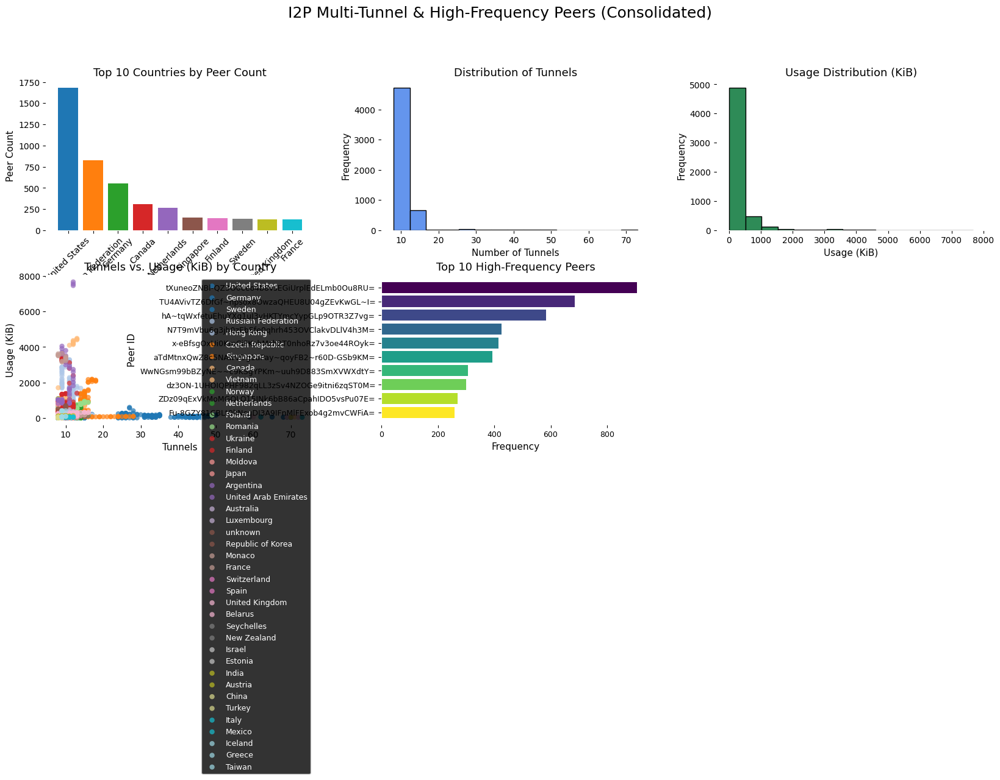

In [ ]:
# SINGLE CELL: Produce a single consolidated figure (white background, landscape) with five subplots.

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

############################################
# 1) LOAD DATASETS FROM GOOGLE DRIVE
############################################

# Adjust these paths if needed
file_path_multitunnel = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/18.i2p_Peers in Multiple Tunnels.csv"
file_path_highfreq    = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/17.High set frequency and peers-2.txt"

df_multitunnel = pd.read_csv(file_path_multitunnel)
df_highfreq = pd.read_csv(file_path_highfreq, sep="\t", header=None, usecols=[0,1], names=["Peer", "Frequency"])

print("Data loaded. Previews:")
print("Multi-Tunnel Dataset:")
display(df_multitunnel.head(3))

print("\nHigh-Frequency Dataset:")
display(df_highfreq.head(3))

############################################
# 2) PREPROCESS THE MULTITUNNEL DATA
############################################

def convert_usage_to_kib(usage_str):
    """
    Converts usage strings to KiB (float).
    Handles values ending with KiB, MiB, GiB, or B (bytes).
    """
    usage_str = str(usage_str).strip()
    if usage_str.endswith("KiB"):
        return float(usage_str.replace("KiB", "").strip())
    elif usage_str.endswith("MiB"):
        return float(usage_str.replace("MiB", "").strip()) * 1024
    elif usage_str.endswith("GiB"):
        return float(usage_str.replace("GiB", "").strip()) * 1024 * 1024
    elif usage_str.endswith("B"):
        val_str = usage_str.replace("B", "").strip()
        if val_str == '' or val_str == '0':
            return 0.0
        return float(val_str) / 1024.0
    else:
        # Try direct float conversion
        try:
            return float(usage_str)
        except:
            return np.nan

df_multitunnel['Usage_KiB'] = df_multitunnel['Usage'].apply(convert_usage_to_kib)
df_multitunnel['Tunnels']   = pd.to_numeric(df_multitunnel['Tunnels'], errors='coerce')

############################################
# 3) PREPARE DATA FOR PLOTTING
############################################

# Top 10 countries (by peer count)
country_counts = df_multitunnel['Country'].value_counts().head(10)

# Sort high-frequency peers, keep top 10
top_freq = df_highfreq.sort_values("Frequency", ascending=False).head(10)

############################################
# 4) CREATE A SINGLE LANDSCAPE FIGURE WITH 5 SUBPLOTS
############################################

# We'll use a 2 x 3 grid, leaving the bottom-right cell empty.
fig, axs = plt.subplots(2, 3, figsize=(16.5, 11.7), facecolor='white')  # ~A4 ratio in landscape
fig.suptitle("I2P Multi-Tunnel & High-Frequency Peers (Consolidated)", fontsize=18, color='black')

# Subplot 1 (top-left): Bar Chart of Top 10 Countries
axs[0, 0].bar(country_counts.index, country_counts.values,
              color=plt.cm.tab10(np.linspace(0, 1, len(country_counts))))
axs[0, 0].set_title("Top 10 Countries by Peer Count", fontsize=13, color='black')
axs[0, 0].set_xlabel("Country", fontsize=11, color='black')
axs[0, 0].set_ylabel("Peer Count", fontsize=11, color='black')
axs[0, 0].tick_params(axis='x', rotation=45, labelsize=10, colors='black')
axs[0, 0].tick_params(axis='y', labelsize=10, colors='black')

# Subplot 2 (top-middle): Histogram of Tunnels
axs[0, 1].hist(df_multitunnel['Tunnels'].dropna(), bins=15,
               color='cornflowerblue', edgecolor='black')
axs[0, 1].set_title("Distribution of Tunnels", fontsize=13, color='black')
axs[0, 1].set_xlabel("Number of Tunnels", fontsize=11, color='black')
axs[0, 1].set_ylabel("Frequency", fontsize=11, color='black')
axs[0, 1].tick_params(labelsize=10, colors='black')

# Subplot 3 (top-right): Histogram of Usage (KiB)
axs[0, 2].hist(df_multitunnel['Usage_KiB'].dropna(), bins=15,
               color='seagreen', edgecolor='black')
axs[0, 2].set_title("Usage Distribution (KiB)", fontsize=13, color='black')
axs[0, 2].set_xlabel("Usage (KiB)", fontsize=11, color='black')
axs[0, 2].set_ylabel("Frequency", fontsize=11, color='black')
axs[0, 2].tick_params(labelsize=10, colors='black')

# Subplot 4 (bottom-left): Scatter Plot (Tunnels vs Usage_KiB), colored by Country
unique_countries = df_multitunnel['Country'].dropna().unique()
cmap = plt.cm.get_cmap('tab20', len(unique_countries))

for i, country in enumerate(unique_countries):
    subset = df_multitunnel[df_multitunnel['Country'] == country]
    axs[1, 0].scatter(subset['Tunnels'], subset['Usage_KiB'],
                      color=cmap(i), label=country, alpha=0.7, edgecolor='none')

axs[1, 0].set_title("Tunnels vs. Usage (KiB) by Country", fontsize=13, color='black')
axs[1, 0].set_xlabel("Tunnels", fontsize=11, color='black')
axs[1, 0].set_ylabel("Usage (KiB)", fontsize=11, color='black')
axs[1, 0].tick_params(labelsize=10, colors='black')

# Add legend. If too large, you can set "loc='upper left', bbox_to_anchor=(1,1)"
axs[1, 0].legend(fontsize=9, loc='best', frameon=True)

# Subplot 5 (bottom-middle): Horizontal Bar Chart of Top 10 High-Frequency Peers
axs[1, 1].barh(top_freq['Peer'], top_freq['Frequency'],
               color=plt.cm.viridis(np.linspace(0, 1, len(top_freq))))
axs[1, 1].set_title("Top 10 High-Frequency Peers", fontsize=13, color='black')
axs[1, 1].set_xlabel("Frequency", fontsize=11, color='black')
axs[1, 1].set_ylabel("Peer ID", fontsize=11, color='black')
axs[1, 1].invert_yaxis()  # highest freq on top
axs[1, 1].tick_params(labelsize=9, colors='black')

# Disable the bottom-right cell
axs[1, 2].axis('off')

# Make each subplot's background white
for axrow in axs:
    for ax in axrow:
        ax.set_facecolor('white')

plt.tight_layout(rect=[0, 0.03, 1, 0.94])
plt.subplots_adjust(hspace=0.3, wspace=0.25)

# Save the figure as a high-resolution PDF
fig.savefig("I2P_MultiTunnel_Consolidated.pdf", format="pdf", dpi=300, facecolor='white')
print("All done! Figure saved as 'I2P_MultiTunnel_Consolidated.pdf' at 300 DPI.")
plt.show()


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<ipython-input-106-7925a9c296da>:99: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab20', len(unique_countries))


Figure saved as 'I2P_MultiTunnel_Consolidated_Landscape.pdf' at 300 DPI.


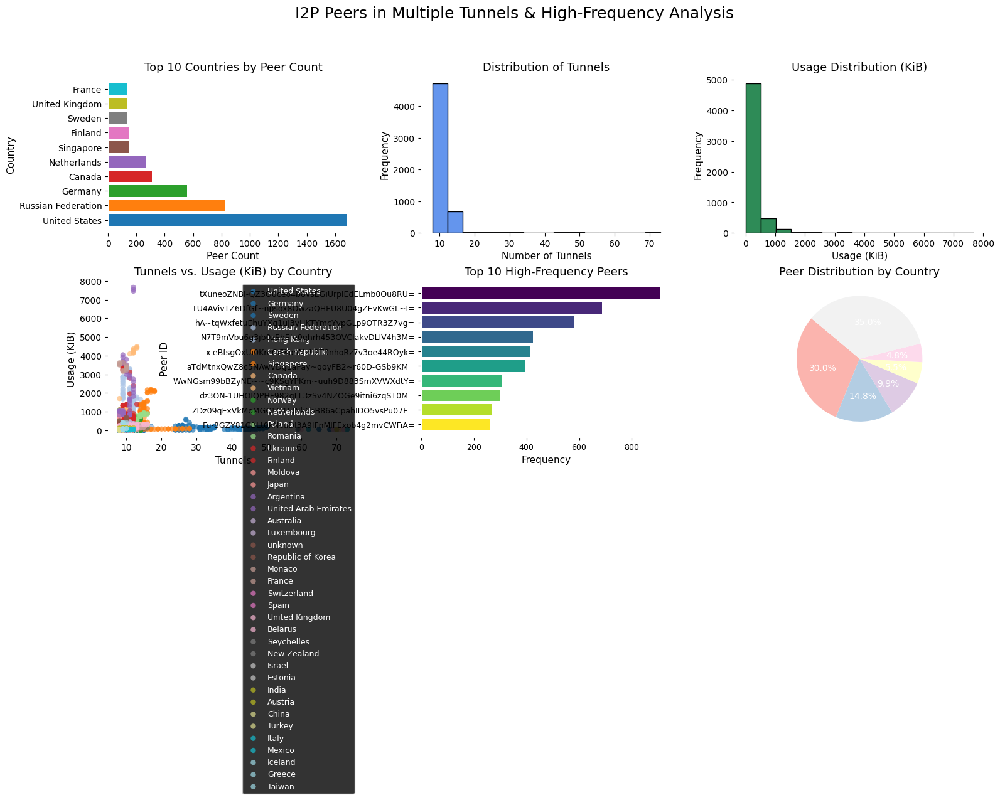

In [ ]:
# Import required packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Mount your Google Drive (if not already mounted)
from google.colab import drive
drive.mount('/content/drive')

# Load datasets from Google Drive.
file_path_multitunnel = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/18.i2p_Peers in Multiple Tunnels.csv"
file_path_highfreq    = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/17.High set frequency and peers-2.txt"

df_multitunnel = pd.read_csv(file_path_multitunnel)
# For high frequency, read only first two columns.
df_highfreq = pd.read_csv(file_path_highfreq, sep="\t", header=None, usecols=[0,1],
                          names=["Peer", "Frequency"])

# Preprocess the multitunnel data
def convert_usage_to_kib(usage_str):
    """
    Converts a usage string to a float representing KiB.
    Handles values ending with KiB, MiB, GiB, or B (bytes).
    """
    usage_str = str(usage_str).strip()
    if usage_str.endswith("KiB"):
        return float(usage_str.replace("KiB", "").strip())
    elif usage_str.endswith("MiB"):
        return float(usage_str.replace("MiB", "").strip()) * 1024
    elif usage_str.endswith("GiB"):
        return float(usage_str.replace("GiB", "").strip()) * 1024 * 1024
    elif usage_str.endswith("B"):
        val_str = usage_str.replace("B", "").strip()
        if val_str == '' or val_str == '0':
            return 0.0
        return float(val_str) / 1024.0
    else:
        try:
            return float(usage_str)
        except:
            return np.nan

df_multitunnel['Usage_KiB'] = df_multitunnel['Usage'].apply(convert_usage_to_kib)
df_multitunnel['Tunnels']   = pd.to_numeric(df_multitunnel['Tunnels'], errors='coerce')

# Prepare data for plotting

# Top 10 countries by peer count (for horizontal bar chart)
country_counts = df_multitunnel['Country'].value_counts().head(10)

# For pie chart, get distribution for all countries:
pie_data = df_multitunnel['Country'].value_counts()
# Optionally, group all countries beyond the top 5 into "Other"
top5 = pie_data.head(5)
other = pd.Series([pie_data[5:].sum()], index=["Other"])
pie_chart_data = pd.concat([top5, other])

# Top 10 high-frequency peers (horizontal bar chart)
top_freq = df_highfreq.sort_values("Frequency", ascending=False).head(10)

############################################
# Create a single, landscape-oriented figure with 6 subplots
############################################

fig, axs = plt.subplots(2, 3, figsize=(16.5, 11.7), facecolor='white')  # A4 landscape dimensions

fig.suptitle("I2P Peers in Multiple Tunnels & High-Frequency Analysis", fontsize=18, color='black')

# Subplot 1 (0,0): Horizontal Bar Chart for Top 10 Countries by Peer Count
axs[0, 0].barh(country_counts.index, country_counts.values,
              color=plt.cm.tab10(np.linspace(0, 1, len(country_counts))))
axs[0, 0].set_title("Top 10 Countries by Peer Count", fontsize=13, color='black')
axs[0, 0].set_xlabel("Peer Count", fontsize=11, color='black')
axs[0, 0].set_ylabel("Country", fontsize=11, color='black')
axs[0, 0].tick_params(axis='x', labelsize=10, colors='black')
axs[0, 0].tick_params(axis='y', labelsize=10, colors='black')
axs[0, 0].set_facecolor('white')

# Subplot 2 (0,1): Histogram of Tunnel Counts
axs[0, 1].hist(df_multitunnel['Tunnels'].dropna(), bins=15,
               color='cornflowerblue', edgecolor='black')
axs[0, 1].set_title("Distribution of Tunnels", fontsize=13, color='black')
axs[0, 1].set_xlabel("Number of Tunnels", fontsize=11, color='black')
axs[0, 1].set_ylabel("Frequency", fontsize=11, color='black')
axs[0, 1].tick_params(labelsize=10, colors='black')
axs[0, 1].set_facecolor('white')

# Subplot 3 (0,2): Histogram of Usage (KiB)
axs[0, 2].hist(df_multitunnel['Usage_KiB'].dropna(), bins=15,
               color='seagreen', edgecolor='black')
axs[0, 2].set_title("Usage Distribution (KiB)", fontsize=13, color='black')
axs[0, 2].set_xlabel("Usage (KiB)", fontsize=11, color='black')
axs[0, 2].set_ylabel("Frequency", fontsize=11, color='black')
axs[0, 2].tick_params(labelsize=10, colors='black')
axs[0, 2].set_facecolor('white')

# Subplot 4 (1,0): Scatter Plot of Tunnels vs. Usage, Colored by Country
unique_countries = df_multitunnel['Country'].dropna().unique()
cmap = plt.cm.get_cmap('tab20', len(unique_countries))
for i, country in enumerate(unique_countries):
    subset = df_multitunnel[df_multitunnel['Country'] == country]
    axs[1, 0].scatter(subset['Tunnels'], subset['Usage_KiB'],
                      color=cmap(i), label=country, alpha=0.7, edgecolor='none')
axs[1, 0].set_title("Tunnels vs. Usage (KiB) by Country", fontsize=13, color='black')
axs[1, 0].set_xlabel("Tunnels", fontsize=11, color='black')
axs[1, 0].set_ylabel("Usage (KiB)", fontsize=11, color='black')
axs[1, 0].tick_params(labelsize=10, colors='black')
axs[1, 0].legend(fontsize=9, loc='best', frameon=True)
axs[1, 0].set_facecolor('white')

# Subplot 5 (1,1): Horizontal Bar Chart for Top 10 High-Frequency Peers
axs[1, 1].barh(top_freq['Peer'], top_freq['Frequency'],
               color=plt.cm.viridis(np.linspace(0, 1, len(top_freq))))
axs[1, 1].set_title("Top 10 High-Frequency Peers", fontsize=13, color='black')
axs[1, 1].set_xlabel("Frequency", fontsize=11, color='black')
axs[1, 1].set_ylabel("Peer ID", fontsize=11, color='black')
axs[1, 1].invert_yaxis()  # highest frequency on top
axs[1, 1].tick_params(labelsize=9, colors='black')
axs[1, 1].set_facecolor('white')

# Subplot 6 (1,2): Pie Chart of Country Distribution (Top 5 + Other)
axs[1, 2].pie(pie_chart_data.values, labels=pie_chart_data.index, autopct='%1.1f%%', startangle=140, colors=plt.cm.Pastel1(np.linspace(0,1,len(pie_chart_data))))
axs[1, 2].set_title("Peer Distribution by Country", fontsize=13, color='black')
axs[1, 2].set_facecolor('white')

# Ensure the entire figure has a white background
fig.patch.set_facecolor('white')

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.subplots_adjust(hspace=0.3, wspace=0.25)

# Save the final figure as a high-resolution PDF (landscape)
fig.savefig("I2P_MultiTunnel_Consolidated_Landscape.pdf", format="pdf", dpi=300, facecolor='white')
print("Figure saved as 'I2P_MultiTunnel_Consolidated_Landscape.pdf' at 300 DPI.")
plt.show()


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Preview: Multi-Tunnel Dataset


,Timestamp,Full Peer ID,Country,Tunnels,Usage
0,3/10/2025 19:37,iGhAmNE-rfrgQBGVbgiIELaih8lsVUjKfg~oV1w06lk=,United States,70,31KiB
1,3/10/2025 19:37,oj7nYbeoMWmdyl449BksYUuCokNa~1G66POwlPdE2~Y=,Germany,47,124KiB
2,3/10/2025 19:37,JTDON0OCsRKVsG0PhhAAtiOSptWwX5Cx-tJB3OAYlmM=,United States,44,96KiB


Preview: High-Frequency Dataset


,Peer,Frequency
0,tXuneoZNBl-QZ3O0ceo4b8vsEGiUrplEdELmb0Ou8RU=,906.0
1,TU4AVivTZ6DfGf~npsox8OwzaQHEU8U04gZEvKwGL~I=,686.0
2,hA~tqWxfetuEhuYXq1uJ3yHKTYmcYypGLp9OTR3Z7vg=,583.0


<ipython-input-107-6cf45d2f1f09>:115: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab20', len(unique_countries))


Figure saved as 'I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf' at 300 DPI.


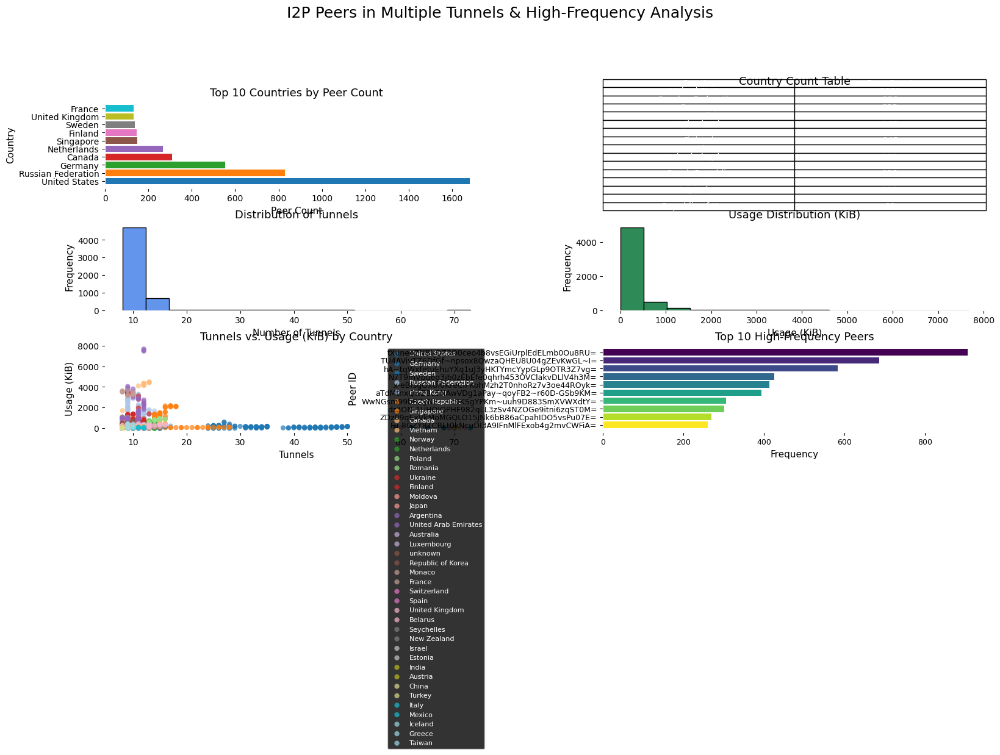

In [ ]:
# ---------------------------
# Consolidated Visualization Code Cell
# ---------------------------

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Mount Google Drive (if not already mounted)
from google.colab import drive
drive.mount('/content/drive')

# ---------------------------
# 1) Load Data
# ---------------------------
file_path_multitunnel = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/18.i2p_Peers in Multiple Tunnels.csv"
file_path_highfreq    = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/17.High set frequency and peers-2.txt"

df_multitunnel = pd.read_csv(file_path_multitunnel)
df_highfreq = pd.read_csv(file_path_highfreq, sep="\t", header=None, usecols=[0,1],
                          names=["Peer", "Frequency"])

print("Preview: Multi-Tunnel Dataset")
display(df_multitunnel.head(3))

print("Preview: High-Frequency Dataset")
display(df_highfreq.head(3))

# ---------------------------
# 2) Preprocess Multi-Tunnel Data
# ---------------------------
def convert_usage_to_kib(usage_str):
    """Converts a usage string (with KiB, MiB, GiB, or B) into a float in KiB."""
    usage_str = str(usage_str).strip()
    if usage_str.endswith("KiB"):
        return float(usage_str.replace("KiB", "").strip())
    elif usage_str.endswith("MiB"):
        return float(usage_str.replace("MiB", "").strip()) * 1024
    elif usage_str.endswith("GiB"):
        return float(usage_str.replace("GiB", "").strip()) * 1024 * 1024
    elif usage_str.endswith("B"):
        val_str = usage_str.replace("B", "").strip()
        return 0.0 if val_str == '' or val_str == '0' else float(val_str)/1024.0
    else:
        try:
            return float(usage_str)
        except:
            return np.nan

df_multitunnel['Usage_KiB'] = df_multitunnel['Usage'].apply(convert_usage_to_kib)
df_multitunnel['Tunnels']   = pd.to_numeric(df_multitunnel['Tunnels'], errors='coerce')

# ---------------------------
# 3) Prepare Data for Plotting
# ---------------------------
# (a) Top 10 countries (by peer count) for horizontal bar chart.
country_counts = df_multitunnel['Country'].value_counts().head(10)

# (b) Table of country counts: show top 15 for neat display.
country_table = df_multitunnel['Country'].value_counts().reset_index()
country_table.columns = ['Country', 'Peer Count']
country_table = country_table.head(15)

# (c) Top 10 high-frequency peers.
top_freq = df_highfreq.sort_values("Frequency", ascending=False).head(10)

# ---------------------------
# 4) Create Consolidated 3x2 Figure (Landscape, White Background)
# ---------------------------
fig, axs = plt.subplots(3, 2, figsize=(16.5, 11.7), facecolor='white')
fig.suptitle("I2P Peers in Multiple Tunnels & High-Frequency Analysis", fontsize=18, color='black')

# Subplot 1 (Row 0, Col 0): Horizontal Bar Chart for Top 10 Countries
axs[0, 0].barh(country_counts.index, country_counts.values,
              color=plt.cm.tab10(np.linspace(0, 1, len(country_counts))))
axs[0, 0].set_title("Top 10 Countries by Peer Count", fontsize=13, color='black')
axs[0, 0].set_xlabel("Peer Count", fontsize=11, color='black')
axs[0, 0].set_ylabel("Country", fontsize=11, color='black')
axs[0, 0].tick_params(axis='x', labelsize=10, colors='black')
axs[0, 0].tick_params(axis='y', labelsize=10, colors='black')
axs[0, 0].set_facecolor('white')

# Subplot 2 (Row 0, Col 1): Table of Top 15 Country Counts
axs[0, 1].axis('tight')
axs[0, 1].axis('off')
table = axs[0, 1].table(cellText=country_table.values,
                        colLabels=country_table.columns,
                        cellLoc='center',
                        loc='center')
table.auto_set_font_size(False)
table.set_fontsize(10)
table.scale(1, 1.5)  # Adjust row height
axs[0, 1].set_title("Country Count Table", fontsize=13, pad=20, color='black')

# Subplot 3 (Row 1, Col 0): Histogram of Tunnel Counts
axs[1, 0].hist(df_multitunnel['Tunnels'].dropna(), bins=15,
               color='cornflowerblue', edgecolor='black')
axs[1, 0].set_title("Distribution of Tunnels", fontsize=13, color='black')
axs[1, 0].set_xlabel("Number of Tunnels", fontsize=11, color='black')
axs[1, 0].set_ylabel("Frequency", fontsize=11, color='black')
axs[1, 0].tick_params(labelsize=10, colors='black')
axs[1, 0].set_facecolor('white')

# Subplot 4 (Row 1, Col 1): Histogram of Usage (KiB)
axs[1, 1].hist(df_multitunnel['Usage_KiB'].dropna(), bins=15,
               color='seagreen', edgecolor='black')
axs[1, 1].set_title("Usage Distribution (KiB)", fontsize=13, color='black')
axs[1, 1].set_xlabel("Usage (KiB)", fontsize=11, color='black')
axs[1, 1].set_ylabel("Frequency", fontsize=11, color='black')
axs[1, 1].tick_params(labelsize=10, colors='black')
axs[1, 1].set_facecolor('white')

# Subplot 5 (Row 2, Col 0): Scatter Plot of Tunnels vs. Usage, Colored by Country
unique_countries = df_multitunnel['Country'].dropna().unique()
cmap = plt.cm.get_cmap('tab20', len(unique_countries))
for i, country in enumerate(unique_countries):
    subset = df_multitunnel[df_multitunnel['Country'] == country]
    axs[2, 0].scatter(subset['Tunnels'], subset['Usage_KiB'],
                      color=cmap(i), label=country, alpha=0.7, edgecolor='none')
axs[2, 0].set_title("Tunnels vs. Usage (KiB) by Country", fontsize=13, color='black')
axs[2, 0].set_xlabel("Tunnels", fontsize=11, color='black')
axs[2, 0].set_ylabel("Usage (KiB)", fontsize=11, color='black')
axs[2, 0].tick_params(labelsize=10, colors='black')
axs[2, 0].legend(fontsize=8, loc='best', frameon=True)
axs[2, 0].set_facecolor('white')

# Subplot 6 (Row 2, Col 1): Horizontal Bar Chart of Top 10 High-Frequency Peers
axs[2, 1].barh(top_freq['Peer'], top_freq['Frequency'],
               color=plt.cm.viridis(np.linspace(0, 1, len(top_freq))))
axs[2, 1].set_title("Top 10 High-Frequency Peers", fontsize=13, color='black')
axs[2, 1].set_xlabel("Frequency", fontsize=11, color='black')
axs[2, 1].set_ylabel("Peer ID", fontsize=11, color='black')
axs[2, 1].invert_yaxis()  # highest frequency on top
axs[2, 1].tick_params(labelsize=9, colors='black')
axs[2, 1].set_facecolor('white')

# Ensure overall figure background is white
fig.patch.set_facecolor('white')

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.subplots_adjust(hspace=0.4, wspace=0.3)

# Save the figure as a high-resolution PDF (landscape)
fig.savefig("I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf", format="pdf", dpi=300, facecolor='white')
print("Figure saved as 'I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf' at 300 DPI.")
plt.show()


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<ipython-input-108-616d3ec5bf10>:90: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab20', len(unique_countries))


Figure saved as 'I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf' at 300 DPI.


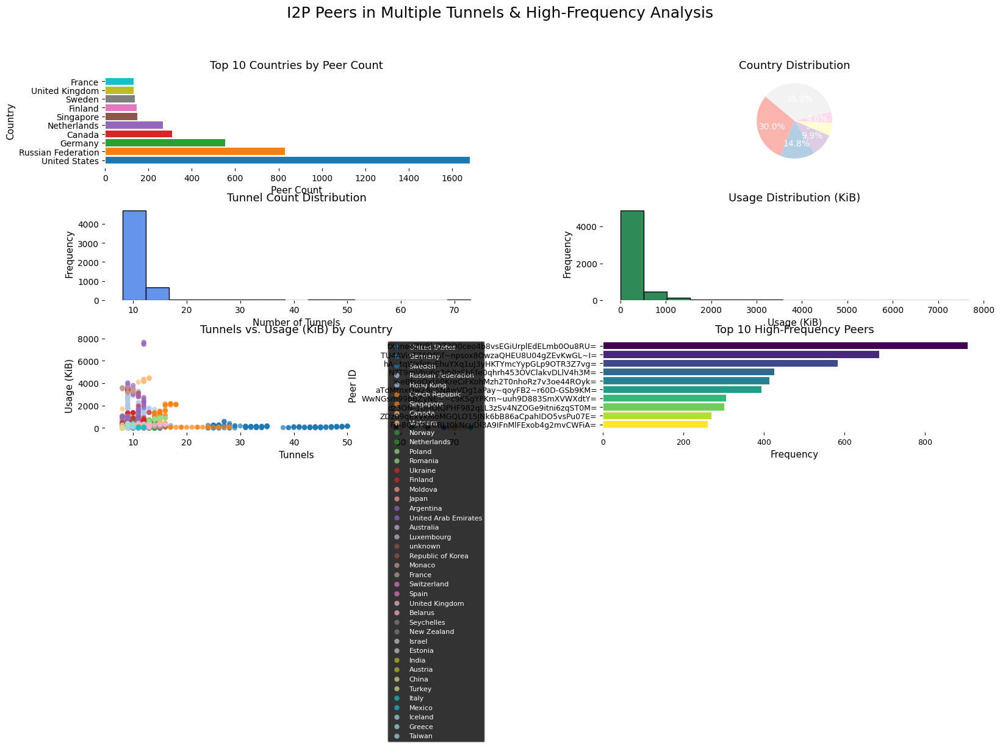

In [ ]:
# Step 1: Import packages and mount Google Drive
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from google.colab import drive
drive.mount('/content/drive')

# Step 2: Load the datasets
file_path_multitunnel = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/18.i2p_Peers in Multiple Tunnels.csv"
file_path_highfreq    = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/17.High set frequency and peers-2.txt"

df_multitunnel = pd.read_csv(file_path_multitunnel)
df_highfreq = pd.read_csv(file_path_highfreq, sep="\t", header=None, usecols=[0,1],
                          names=["Peer", "Frequency"])

# Step 3: Preprocess the Multi-Tunnel Data
def convert_usage_to_kib(usage_str):
    """Converts a usage string (e.g., '31KiB', '1.96MiB') to a float in KiB."""
    usage_str = str(usage_str).strip()
    if usage_str.endswith("KiB"):
        return float(usage_str.replace("KiB", "").strip())
    elif usage_str.endswith("MiB"):
        return float(usage_str.replace("MiB", "").strip()) * 1024
    elif usage_str.endswith("GiB"):
        return float(usage_str.replace("GiB", "").strip()) * 1024 * 1024
    elif usage_str.endswith("B"):
        val_str = usage_str.replace("B", "").strip()
        return 0.0 if val_str in ['', '0'] else float(val_str)/1024.0
    else:
        try:
            return float(usage_str)
        except:
            return np.nan

df_multitunnel['Usage_KiB'] = df_multitunnel['Usage'].apply(convert_usage_to_kib)
df_multitunnel['Tunnels'] = pd.to_numeric(df_multitunnel['Tunnels'], errors='coerce')

# Step 4: Prepare Data for Plotting
# (a) Top 10 countries by peer count.
country_counts = df_multitunnel['Country'].value_counts().head(10)

# (b) For the pie chart: group the overall country distribution.
top5 = df_multitunnel['Country'].value_counts().head(5)
other = pd.Series([df_multitunnel['Country'].value_counts().iloc[5:].sum()], index=["Other"])
pie_data = pd.concat([top5, other])

# (c) Top 10 high-frequency peers.
top_freq = df_highfreq.sort_values("Frequency", ascending=False).head(10)

# Step 5: Create the Consolidated Figure with 6 Subplots in a 3x2 grid.
fig, axs = plt.subplots(3, 2, figsize=(16.5, 11.7), facecolor='white')
fig.suptitle("I2P Peers in Multiple Tunnels & High-Frequency Analysis", fontsize=18, color='black')

# Subplot 1 (Row 0, Col 0): Horizontal Bar Chart for Top 10 Countries by Peer Count.
axs[0, 0].barh(country_counts.index, country_counts.values,
              color=plt.cm.tab10(np.linspace(0, 1, len(country_counts))))
axs[0, 0].set_title("Top 10 Countries by Peer Count", fontsize=13, color='black')
axs[0, 0].set_xlabel("Peer Count", fontsize=11, color='black')
axs[0, 0].set_ylabel("Country", fontsize=11, color='black')
axs[0, 0].tick_params(axis='both', labelsize=10, colors='black')
axs[0, 0].set_facecolor('white')

# Subplot 2 (Row 0, Col 1): Pie Chart of Overall Country Distribution.
axs[0, 1].pie(pie_data.values, labels=pie_data.index, autopct='%1.1f%%', startangle=140,
              colors=plt.cm.Pastel1(np.linspace(0, 1, len(pie_data))))
axs[0, 1].set_title("Country Distribution", fontsize=13, color='black')
axs[0, 1].set_facecolor('white')

# Subplot 3 (Row 1, Col 0): Histogram of Tunnel Counts.
axs[1, 0].hist(df_multitunnel['Tunnels'].dropna(), bins=15,
               color='cornflowerblue', edgecolor='black')
axs[1, 0].set_title("Tunnel Count Distribution", fontsize=13, color='black')
axs[1, 0].set_xlabel("Number of Tunnels", fontsize=11, color='black')
axs[1, 0].set_ylabel("Frequency", fontsize=11, color='black')
axs[1, 0].tick_params(axis='both', labelsize=10, colors='black')
axs[1, 0].set_facecolor('white')

# Subplot 4 (Row 1, Col 1): Histogram of Usage (KiB).
axs[1, 1].hist(df_multitunnel['Usage_KiB'].dropna(), bins=15,
               color='seagreen', edgecolor='black')
axs[1, 1].set_title("Usage Distribution (KiB)", fontsize=13, color='black')
axs[1, 1].set_xlabel("Usage (KiB)", fontsize=11, color='black')
axs[1, 1].set_ylabel("Frequency", fontsize=11, color='black')
axs[1, 1].tick_params(axis='both', labelsize=10, colors='black')
axs[1, 1].set_facecolor('white')

# Subplot 5 (Row 2, Col 0): Scatter Plot of Tunnels vs. Usage (KiB) by Country.
unique_countries = df_multitunnel['Country'].dropna().unique()
cmap = plt.cm.get_cmap('tab20', len(unique_countries))
for i, country in enumerate(unique_countries):
    subset = df_multitunnel[df_multitunnel['Country'] == country]
    axs[2, 0].scatter(subset['Tunnels'], subset['Usage_KiB'],
                      color=cmap(i), label=country, alpha=0.7, edgecolor='none')
axs[2, 0].set_title("Tunnels vs. Usage (KiB) by Country", fontsize=13, color='black')
axs[2, 0].set_xlabel("Tunnels", fontsize=11, color='black')
axs[2, 0].set_ylabel("Usage (KiB)", fontsize=11, color='black')
axs[2, 0].tick_params(axis='both', labelsize=10, colors='black')
axs[2, 0].legend(fontsize=8, loc='best', frameon=True)
axs[2, 0].set_facecolor('white')

# Subplot 6 (Row 2, Col 1): Horizontal Bar Chart for Top 10 High-Frequency Peers.
axs[2, 1].barh(top_freq['Peer'], top_freq['Frequency'],
               color=plt.cm.viridis(np.linspace(0, 1, len(top_freq))))
axs[2, 1].set_title("Top 10 High-Frequency Peers", fontsize=13, color='black')
axs[2, 1].set_xlabel("Frequency", fontsize=11, color='black')
axs[2, 1].set_ylabel("Peer ID", fontsize=11, color='black')
axs[2, 1].invert_yaxis()  # highest frequency on top
axs[2, 1].tick_params(axis='both', labelsize=9, colors='black')
axs[2, 1].set_facecolor('white')

# Set the overall figure background to white
fig.patch.set_facecolor('white')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.subplots_adjust(hspace=0.4, wspace=0.3)

# Save the figure as a high-resolution PDF (landscape)
fig.savefig("I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf", format="pdf", dpi=300, facecolor='white')
print("Figure saved as 'I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf' at 300 DPI.")
plt.show()


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Figure saved as 'I2P_Peers_MultiTunnel_Landscape.pdf' at 300 DPI.


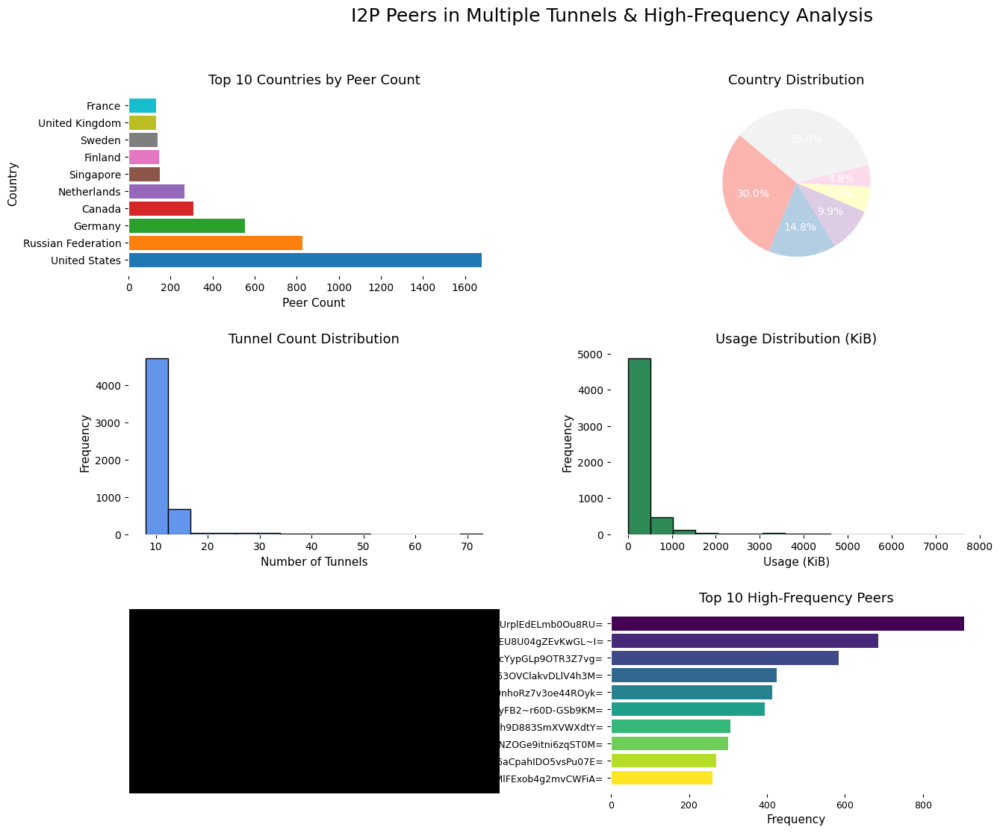

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# 1) (Optional) Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# 2) Load your datasets
file_path_multitunnel = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/18.i2p_Peers in Multiple Tunnels.csv"
file_path_highfreq    = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/17.High set frequency and peers-2.txt"

df_multitunnel = pd.read_csv(file_path_multitunnel)
df_highfreq = pd.read_csv(file_path_highfreq, sep="\t", header=None, usecols=[0,1],
                          names=["Peer", "Frequency"])

# 3) Preprocess the multi-tunnel data
def convert_usage_to_kib(usage_str):
    """
    Converts usage strings like '31KiB', '1.96MiB', etc. to a float in KiB.
    """
    usage_str = str(usage_str).strip()
    if usage_str.endswith("KiB"):
        return float(usage_str.replace("KiB", "").strip())
    elif usage_str.endswith("MiB"):
        return float(usage_str.replace("MiB", "").strip()) * 1024
    elif usage_str.endswith("GiB"):
        return float(usage_str.replace("GiB", "").strip()) * 1024 * 1024
    elif usage_str.endswith("B"):
        val_str = usage_str.replace("B", "").strip()
        return 0.0 if val_str in ["", "0"] else float(val_str)/1024.0
    else:
        try:
            return float(usage_str)
        except:
            return np.nan

df_multitunnel['Usage_KiB'] = df_multitunnel['Usage'].apply(convert_usage_to_kib)
df_multitunnel['Tunnels']   = pd.to_numeric(df_multitunnel['Tunnels'], errors='coerce')

# 4) Prepare data for plotting
# (a) Top 10 countries by peer count (horizontal bar)
country_counts = df_multitunnel['Country'].value_counts().head(10)

# (b) Pie chart data: top 5 countries + 'Other'
top5  = df_multitunnel['Country'].value_counts().head(5)
other = pd.Series([df_multitunnel['Country'].value_counts().iloc[5:].sum()], index=["Other"])
pie_data = pd.concat([top5, other])

# (c) Top 10 high-frequency peers
top_freq = df_highfreq.sort_values("Frequency", ascending=False).head(10)

# 5) Create the figure (3×2 grid, A4 landscape)
fig, axs = plt.subplots(3, 2, figsize=(16.5, 11.7), facecolor='white')
fig.suptitle("I2P Peers in Multiple Tunnels & High-Frequency Analysis", fontsize=18, color='black')

############################
# Subplot (0,0): Horizontal bar (Top 10 Countries)
############################
axs[0, 0].barh(country_counts.index, country_counts.values,
               color=plt.cm.tab10(np.linspace(0, 1, len(country_counts))))
axs[0, 0].set_title("Top 10 Countries by Peer Count", fontsize=13, color='black')
axs[0, 0].set_xlabel("Peer Count", fontsize=11, color='black')
axs[0, 0].set_ylabel("Country", fontsize=11, color='black')
axs[0, 0].tick_params(axis='both', labelsize=10, colors='black')
axs[0, 0].set_facecolor('white')

############################
# Subplot (0,1): Pie chart (Top 5 + Other)
############################
axs[0, 1].pie(pie_data.values, labels=pie_data.index, autopct='%1.1f%%',
              startangle=140, colors=plt.cm.Pastel1(np.linspace(0,1,len(pie_data))))
axs[0, 1].set_title("Country Distribution", fontsize=13, color='black')
axs[0, 1].set_facecolor('white')

############################
# Subplot (1,0): Histogram (Tunnels)
############################
axs[1, 0].hist(df_multitunnel['Tunnels'].dropna(), bins=15,
               color='cornflowerblue', edgecolor='black')
axs[1, 0].set_title("Tunnel Count Distribution", fontsize=13, color='black')
axs[1, 0].set_xlabel("Number of Tunnels", fontsize=11, color='black')
axs[1, 0].set_ylabel("Frequency", fontsize=11, color='black')
axs[1, 0].tick_params(axis='both', labelsize=10, colors='black')
axs[1, 0].set_facecolor('white')

############################
# Subplot (1,1): Histogram (Usage KiB)
############################
axs[1, 1].hist(df_multitunnel['Usage_KiB'].dropna(), bins=15,
               color='seagreen', edgecolor='black')
axs[1, 1].set_title("Usage Distribution (KiB)", fontsize=13, color='black')
axs[1, 1].set_xlabel("Usage (KiB)", fontsize=11, color='black')
axs[1, 1].set_ylabel("Frequency", fontsize=11, color='black')
axs[1, 1].tick_params(axis='both', labelsize=10, colors='black')
axs[1, 1].set_facecolor('white')

############################
# Subplot (2,0): Scatter (Tunnels vs. Usage), colored by Country
############################
unique_countries = df_multitunnel['Country'].dropna().unique()
cmap = plt.cm.get_cmap('tab20', len(unique_countries))

for i, ctry in enumerate(unique_countries):
    subset = df_multitunnel[df_multitunnel['Country'] == ctry]
    axs[2, 0].scatter(subset['Tunnels'], subset['Usage_KiB'],
                      color=cmap(i), label=ctry, alpha=0.7, edgecolor='none')

axs[2, 0].set_title("Tunnels vs. Usage (KiB) by Country", fontsize=13, color='black')
axs[2, 0].set_xlabel("Tunnels", fontsize=11, color='black')
axs[2, 0].set_ylabel("Usage (KiB)", fontsize=11, color='black')
axs[2, 0].tick_params(axis='both', labelsize=10, colors='black')
axs[2, 0].set_facecolor('white')

# Place the legend OUTSIDE so it doesn't clutter the subplot
# If you prefer no legend, comment out the following lines:
handles, labels = axs[2, 0].get_legend_handles_labels()
axs[2, 0].legend(handles, labels, fontsize=8,
                 loc='center left', bbox_to_anchor=(1.05, 0.5),
                 frameon=True)

############################
# Subplot (2,1): Horizontal bar (Top 10 High-Frequency Peers)
############################
axs[2, 1].barh(top_freq['Peer'], top_freq['Frequency'],
               color=plt.cm.viridis(np.linspace(0, 1, len(top_freq))))
axs[2, 1].set_title("Top 10 High-Frequency Peers", fontsize=13, color='black')
axs[2, 1].set_xlabel("Frequency", fontsize=11, color='black')
axs[2, 1].set_ylabel("Peer ID", fontsize=11, color='black')
axs[2, 1].invert_yaxis()
axs[2, 1].tick_params(axis='both', labelsize=9, colors='black')
axs[2, 1].set_facecolor('white')

# 6) Final layout adjustments
fig.patch.set_facecolor('white')
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.subplots_adjust(hspace=0.4, wspace=0.3, right=0.8)  # Make room for the outside legend

# 7) Save the figure as a high-resolution PDF
fig.savefig("I2P_Peers_MultiTunnel_Landscape.pdf", format="pdf", dpi=300, facecolor='white')
print("Figure saved as 'I2P_Peers_MultiTunnel_Landscape.pdf' at 300 DPI.")
plt.show()


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<ipython-input-111-f1943ea91a8b>:91: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab20', len(unique_countries))


Figure saved as 'I2P_Peers_MultiTunnel_Visualization.pdf' at 300 DPI.


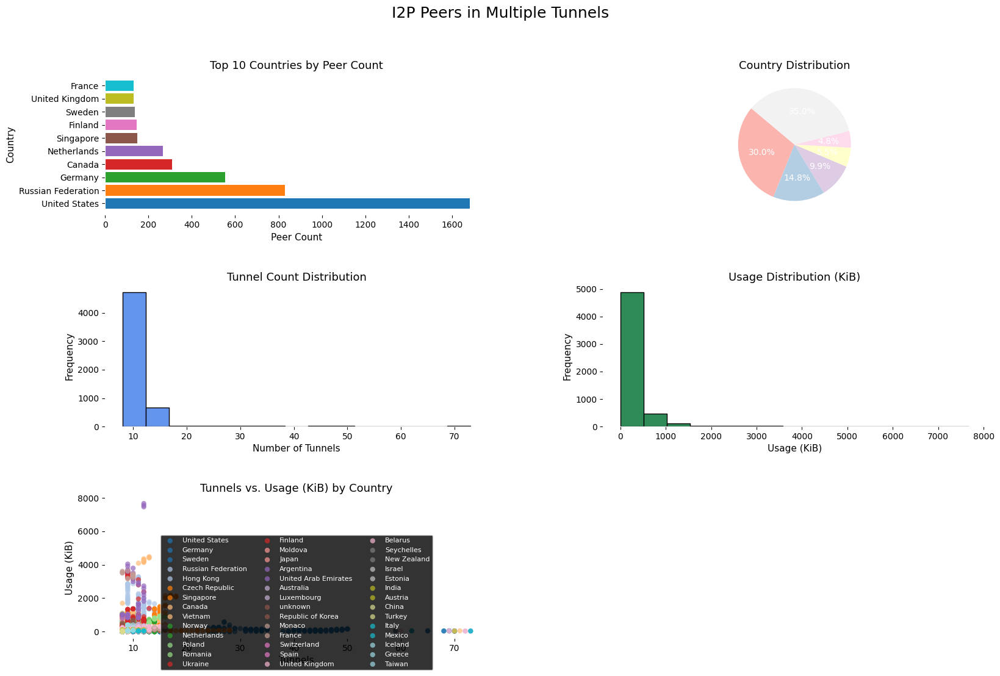

In [ ]:
# ---------------------------
# Step 1: Import packages and mount Google Drive
# ---------------------------
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from google.colab import drive
drive.mount('/content/drive')

# ---------------------------
# Step 2: Load the dataset
# ---------------------------
file_path = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/18.i2p_Peers in Multiple Tunnels.csv"
df = pd.read_csv(file_path)

# ---------------------------
# Step 3: Preprocess the data
# ---------------------------
def convert_usage_to_kib(usage_str):
    """Converts usage strings (e.g., '31KiB', '1.96MiB') into a float in KiB."""
    usage_str = str(usage_str).strip()
    if usage_str.endswith("KiB"):
        return float(usage_str.replace("KiB", "").strip())
    elif usage_str.endswith("MiB"):
        return float(usage_str.replace("MiB", "").strip()) * 1024
    elif usage_str.endswith("GiB"):
        return float(usage_str.replace("GiB", "").strip()) * 1024 * 1024
    elif usage_str.endswith("B"):
        val = usage_str.replace("B", "").strip()
        return 0.0 if val in ["", "0"] else float(val) / 1024.0
    else:
        try:
            return float(usage_str)
        except:
            return np.nan

df['Usage_KiB'] = df['Usage'].apply(convert_usage_to_kib)
df['Tunnels']   = pd.to_numeric(df['Tunnels'], errors='coerce')

# ---------------------------
# Step 4: Prepare data for plotting
# ---------------------------
# (a) Top 10 Countries by Peer Count (horizontal bar chart)
country_counts = df['Country'].value_counts().head(10)

# (b) Pie chart data: overall country distribution (top 5 + 'Other')
top5 = df['Country'].value_counts().head(5)
other = pd.Series([df['Country'].value_counts().iloc[5:].sum()], index=["Other"])
pie_data = pd.concat([top5, other])

# ---------------------------
# Step 5: Create the Consolidated Figure with 5 Subplots
# ---------------------------
fig, axs = plt.subplots(3, 2, figsize=(16.5, 11.7), facecolor='white')
fig.suptitle("I2P Peers in Multiple Tunnels", fontsize=18, color='black')

# Subplot (0,0): Horizontal bar chart for Top 10 Countries
axs[0, 0].barh(country_counts.index, country_counts.values,
               color=plt.cm.tab10(np.linspace(0, 1, len(country_counts))))
axs[0, 0].set_title("Top 10 Countries by Peer Count", fontsize=13, color='black')
axs[0, 0].set_xlabel("Peer Count", fontsize=11, color='black')
axs[0, 0].set_ylabel("Country", fontsize=11, color='black')
axs[0, 0].tick_params(axis='both', labelsize=10, colors='black')
axs[0, 0].set_facecolor('white')

# Subplot (0,1): Pie chart for overall country distribution
axs[0, 1].pie(pie_data.values, labels=pie_data.index, autopct='%1.1f%%',
              startangle=140, colors=plt.cm.Pastel1(np.linspace(0,1,len(pie_data))))
axs[0, 1].set_title("Country Distribution", fontsize=13, color='black')
axs[0, 1].set_facecolor('white')

# Subplot (1,0): Histogram of Tunnel Counts
axs[1, 0].hist(df['Tunnels'].dropna(), bins=15, color='cornflowerblue', edgecolor='black')
axs[1, 0].set_title("Tunnel Count Distribution", fontsize=13, color='black')
axs[1, 0].set_xlabel("Number of Tunnels", fontsize=11, color='black')
axs[1, 0].set_ylabel("Frequency", fontsize=11, color='black')
axs[1, 0].tick_params(axis='both', labelsize=10, colors='black')
axs[1, 0].set_facecolor('white')

# Subplot (1,1): Histogram of Usage (KiB)
axs[1, 1].hist(df['Usage_KiB'].dropna(), bins=15, color='seagreen', edgecolor='black')
axs[1, 1].set_title("Usage Distribution (KiB)", fontsize=13, color='black')
axs[1, 1].set_xlabel("Usage (KiB)", fontsize=11, color='black')
axs[1, 1].set_ylabel("Frequency", fontsize=11, color='black')
axs[1, 1].tick_params(axis='both', labelsize=10, colors='black')
axs[1, 1].set_facecolor('white')

# Subplot (2,0): Scatter Plot of Tunnels vs. Usage (KiB), colored by Country
unique_countries = df['Country'].dropna().unique()
cmap = plt.cm.get_cmap('tab20', len(unique_countries))
for i, country in enumerate(unique_countries):
    subset = df[df['Country'] == country]
    axs[2, 0].scatter(subset['Tunnels'], subset['Usage_KiB'],
                      color=cmap(i), label=country, alpha=0.7, edgecolor='none')
axs[2, 0].set_title("Tunnels vs. Usage (KiB) by Country", fontsize=13, color='black')
axs[2, 0].set_xlabel("Tunnels", fontsize=11, color='black')
axs[2, 0].set_ylabel("Usage (KiB)", fontsize=11, color='black')
axs[2, 0].tick_params(axis='both', labelsize=10, colors='black')
axs[2, 0].set_facecolor('white')
# Arrange legend in 3 columns below the scatter plot
handles, labels = axs[2, 0].get_legend_handles_labels()
axs[2, 0].legend(handles, labels, fontsize=8, ncol=3,
                 loc='lower center', bbox_to_anchor=(0.5, -0.25), frameon=True)

# Subplot (2,1): Leave blank for balanced layout
axs[2, 1].axis('off')
axs[2, 1].set_facecolor('white')

# Final adjustments
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.subplots_adjust(hspace=0.5, wspace=0.3)
fig.patch.set_facecolor('white')

# Save the figure as a high-resolution PDF
fig.savefig("I2P_Peers_MultiTunnel_Visualization.pdf", format="pdf", dpi=300, facecolor='white')
print("Figure saved as 'I2P_Peers_MultiTunnel_Visualization.pdf' at 300 DPI.")
plt.show()


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<ipython-input-112-1fd7cecb955f>:52: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab20', len(unique_countries))
<ipython-input-112-1fd7cecb955f>:102: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axs[1, 1].boxplot(data_box, labels=top5_countries, patch_artist=True,


Figure saved as 'I2P_Peers_MultiTunnel_6Charts.pdf' at 300 DPI.


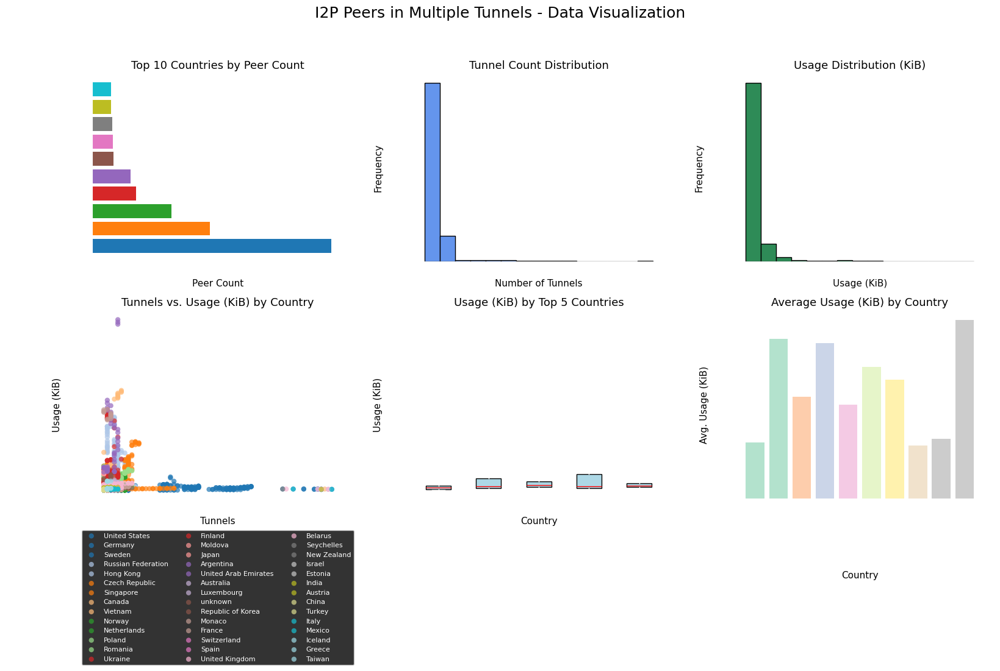

In [ ]:
# ---------------------------
# Step 1: Import packages and mount Google Drive
# ---------------------------
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from google.colab import drive
drive.mount('/content/drive')

# ---------------------------
# Step 2: Load the dataset
# ---------------------------
file_path = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/18.i2p_Peers in Multiple Tunnels.csv"
df = pd.read_csv(file_path)

# ---------------------------
# Step 3: Preprocess the data
# ---------------------------
def convert_usage_to_kib(usage_str):
    """Converts usage strings (e.g., '31KiB', '1.96MiB') into a float value in KiB."""
    usage_str = str(usage_str).strip()
    if usage_str.endswith("KiB"):
        return float(usage_str.replace("KiB", "").strip())
    elif usage_str.endswith("MiB"):
        return float(usage_str.replace("MiB", "").strip()) * 1024
    elif usage_str.endswith("GiB"):
        return float(usage_str.replace("GiB", "").strip()) * 1024 * 1024
    elif usage_str.endswith("B"):
        val = usage_str.replace("B", "").strip()
        return 0.0 if val in ["", "0"] else float(val) / 1024.0
    else:
        try:
            return float(usage_str)
        except:
            return np.nan

df['Usage_KiB'] = df['Usage'].apply(convert_usage_to_kib)
df['Tunnels'] = pd.to_numeric(df['Tunnels'], errors='coerce')

# ---------------------------
# Step 4: Prepare data for plotting
# ---------------------------
# Chart 1: Top 10 Countries by Peer Count
top_countries = df['Country'].value_counts().head(10)

# Chart 2: Histogram of Tunnel counts will use the entire 'Tunnels' column
# Chart 3: Histogram of Usage_KiB will use the entire 'Usage_KiB' column

# Chart 4: Scatter plot (Tunnels vs. Usage_KiB), colored by Country
unique_countries = df['Country'].dropna().unique()
cmap = plt.cm.get_cmap('tab20', len(unique_countries))

# Chart 5: Boxplot of Usage_KiB by Country (for top 5 countries by count)
top5_countries = df['Country'].value_counts().head(5).index.tolist()

# Chart 6: Average Usage_KiB by Country for the top 10 countries
avg_usage_by_country = df.groupby('Country')['Usage_KiB'].mean().loc[top_countries.index]

# ---------------------------
# Step 5: Create the Consolidated Figure (2x3 grid, white background, landscape)
# ---------------------------
fig, axs = plt.subplots(2, 3, figsize=(16.5, 11.7), facecolor='white')
fig.suptitle("I2P Peers in Multiple Tunnels - Data Visualization", fontsize=18, color='black')

# Chart 1: Horizontal Bar Chart (Top 10 Countries by Peer Count)
axs[0, 0].barh(top_countries.index, top_countries.values,
               color=plt.cm.tab10(np.linspace(0, 1, len(top_countries))))
axs[0, 0].set_title("Top 10 Countries by Peer Count", fontsize=13, color='black')
axs[0, 0].set_xlabel("Peer Count", fontsize=11, color='black')
axs[0, 0].set_facecolor('white')

# Chart 2: Histogram of Tunnel Counts
axs[0, 1].hist(df['Tunnels'].dropna(), bins=15, color='cornflowerblue', edgecolor='black')
axs[0, 1].set_title("Tunnel Count Distribution", fontsize=13, color='black')
axs[0, 1].set_xlabel("Number of Tunnels", fontsize=11, color='black')
axs[0, 1].set_ylabel("Frequency", fontsize=11, color='black')
axs[0, 1].set_facecolor('white')

# Chart 3: Histogram of Usage (KiB)
axs[0, 2].hist(df['Usage_KiB'].dropna(), bins=15, color='seagreen', edgecolor='black')
axs[0, 2].set_title("Usage Distribution (KiB)", fontsize=13, color='black')
axs[0, 2].set_xlabel("Usage (KiB)", fontsize=11, color='black')
axs[0, 2].set_ylabel("Frequency", fontsize=11, color='black')
axs[0, 2].set_facecolor('white')

# Chart 4: Scatter Plot (Tunnels vs. Usage) Colored by Country
for i, country in enumerate(unique_countries):
    subset = df[df['Country'] == country]
    axs[1, 0].scatter(subset['Tunnels'], subset['Usage_KiB'], color=cmap(i),
                      label=country, alpha=0.7, edgecolor='none')
axs[1, 0].set_title("Tunnels vs. Usage (KiB) by Country", fontsize=13, color='black')
axs[1, 0].set_xlabel("Tunnels", fontsize=11, color='black')
axs[1, 0].set_ylabel("Usage (KiB)", fontsize=11, color='black')
axs[1, 0].set_facecolor('white')
# Place legend in 3 columns below the plot to avoid a tall list
handles, labels = axs[1, 0].get_legend_handles_labels()
axs[1, 0].legend(handles, labels, fontsize=8, ncol=3, loc='upper center', bbox_to_anchor=(0.5, -0.15))

# Chart 5: Boxplot of Usage (KiB) for Top 5 Countries
data_box = [df[df['Country'] == country]['Usage_KiB'].dropna() for country in top5_countries]
axs[1, 1].boxplot(data_box, labels=top5_countries, patch_artist=True,
                   boxprops=dict(facecolor='lightblue', color='black'),
                   medianprops=dict(color='red'))
axs[1, 1].set_title("Usage (KiB) by Top 5 Countries", fontsize=13, color='black')
axs[1, 1].set_xlabel("Country", fontsize=11, color='black')
axs[1, 1].set_ylabel("Usage (KiB)", fontsize=11, color='black')
axs[1, 1].set_facecolor('white')

# Chart 6: Bar Chart of Average Usage (KiB) by Country (Top 10)
axs[1, 2].bar(top_countries.index, avg_usage_by_country.values,
              color=plt.cm.Pastel2(np.linspace(0,1,len(avg_usage_by_country))))
axs[1, 2].set_title("Average Usage (KiB) by Country", fontsize=13, color='black')
axs[1, 2].set_xlabel("Country", fontsize=11, color='black')
axs[1, 2].set_ylabel("Avg. Usage (KiB)", fontsize=11, color='black')
axs[1, 2].set_facecolor('white')
plt.xticks(rotation=45, ha='right')

# ---------------------------
# Step 6: Final Layout Adjustments and Save
# ---------------------------
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
fig.patch.set_facecolor('white')
fig.savefig("I2P_Peers_MultiTunnel_6Charts.pdf", format="pdf", dpi=300, facecolor='white')
print("Figure saved as 'I2P_Peers_MultiTunnel_6Charts.pdf' at 300 DPI.")
plt.show()


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<ipython-input-113-f26079674fb2>:91: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab20', len(unique_countries))
<ipython-input-113-f26079674fb2>:108: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axs[1, 1].boxplot(data_box, labels=top5_countries, patch_artist=True,


Figure saved as 'I2P_Peers_MultiTunnel_6Charts_Annotated.pdf' at 300 DPI.


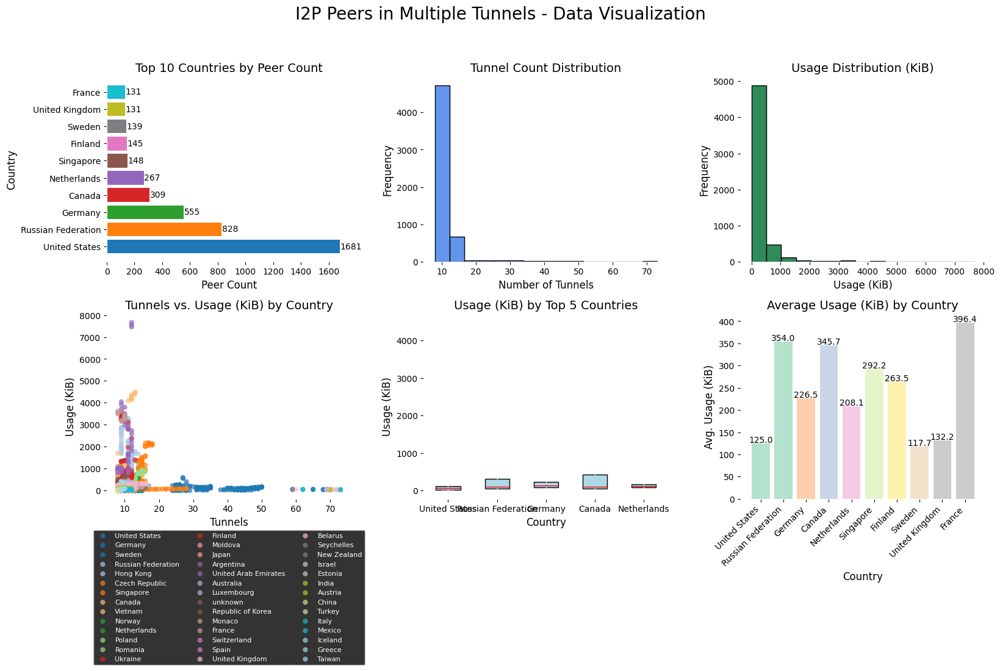

In [ ]:
# ---------------------------
# Step 1: Import packages and mount Google Drive
# ---------------------------
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from google.colab import drive
drive.mount('/content/drive')

# ---------------------------
# Step 2: Load the dataset
# ---------------------------
file_path = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/18.i2p_Peers in Multiple Tunnels.csv"
df = pd.read_csv(file_path)

# ---------------------------
# Step 3: Preprocess the data
# ---------------------------
def convert_usage_to_kib(usage_str):
    """Convert usage strings (e.g., '31KiB', '1.96MiB') to float in KiB."""
    usage_str = str(usage_str).strip()
    if usage_str.endswith("KiB"):
        return float(usage_str.replace("KiB", "").strip())
    elif usage_str.endswith("MiB"):
        return float(usage_str.replace("MiB", "").strip()) * 1024
    elif usage_str.endswith("GiB"):
        return float(usage_str.replace("GiB", "").strip()) * 1024 * 1024
    elif usage_str.endswith("B"):
        val = usage_str.replace("B", "").strip()
        return 0.0 if val in ["", "0"] else float(val) / 1024.0
    else:
        try:
            return float(usage_str)
        except:
            return np.nan

df['Usage_KiB'] = df['Usage'].apply(convert_usage_to_kib)
df['Tunnels'] = pd.to_numeric(df['Tunnels'], errors='coerce')

# ---------------------------
# Step 4: Prepare data for plotting
# ---------------------------
# (a) Top 10 Countries by Peer Count (for Chart 1 & 6)
top_countries = df['Country'].value_counts().head(10)

# (b) Average usage (KiB) by Country for the top 10 countries
avg_usage_by_country = df.groupby('Country')['Usage_KiB'].mean().loc[top_countries.index]

# (c) For Chart 5: Boxplot data for top 5 countries by peer count
top5_countries = df['Country'].value_counts().head(5).index.tolist()

# ---------------------------
# Step 5: Create the Consolidated Figure (2x3 grid, white background, landscape)
# ---------------------------
fig, axs = plt.subplots(2, 3, figsize=(16.5, 11.7), facecolor='white')
fig.suptitle("I2P Peers in Multiple Tunnels - Data Visualization", fontsize=20, color='black')

# Chart 1: Horizontal Bar Chart for Top 10 Countries by Peer Count
bars = axs[0, 0].barh(top_countries.index, top_countries.values,
                      color=plt.cm.tab10(np.linspace(0,1,len(top_countries))))
axs[0, 0].set_title("Top 10 Countries by Peer Count", fontsize=14, color='black')
axs[0, 0].set_xlabel("Peer Count", fontsize=12, color='black')
axs[0, 0].set_ylabel("Country", fontsize=12, color='black')
axs[0, 0].tick_params(axis='both', labelsize=10, colors='black')
axs[0, 0].set_facecolor('white')
# Annotate bars with values
for bar in bars:
    width = bar.get_width()
    axs[0, 0].text(width + 2, bar.get_y() + bar.get_height()/2, f'{int(width)}',
                   va='center', fontsize=10, color='black')

# Chart 2: Histogram of Tunnel Counts
axs[0, 1].hist(df['Tunnels'].dropna(), bins=15, color='cornflowerblue', edgecolor='black')
axs[0, 1].set_title("Tunnel Count Distribution", fontsize=14, color='black')
axs[0, 1].set_xlabel("Number of Tunnels", fontsize=12, color='black')
axs[0, 1].set_ylabel("Frequency", fontsize=12, color='black')
axs[0, 1].tick_params(axis='both', labelsize=10, colors='black')
axs[0, 1].set_facecolor('white')

# Chart 3: Histogram of Usage (KiB)
axs[0, 2].hist(df['Usage_KiB'].dropna(), bins=15, color='seagreen', edgecolor='black')
axs[0, 2].set_title("Usage Distribution (KiB)", fontsize=14, color='black')
axs[0, 2].set_xlabel("Usage (KiB)", fontsize=12, color='black')
axs[0, 2].set_ylabel("Frequency", fontsize=12, color='black')
axs[0, 2].tick_params(axis='both', labelsize=10, colors='black')
axs[0, 2].set_facecolor('white')

# Chart 4: Scatter Plot (Tunnels vs. Usage) Colored by Country
unique_countries = df['Country'].dropna().unique()
cmap = plt.cm.get_cmap('tab20', len(unique_countries))
for i, country in enumerate(unique_countries):
    subset = df[df['Country'] == country]
    axs[1, 0].scatter(subset['Tunnels'], subset['Usage_KiB'], color=cmap(i),
                      label=country, alpha=0.7, edgecolor='none')
axs[1, 0].set_title("Tunnels vs. Usage (KiB) by Country", fontsize=14, color='black')
axs[1, 0].set_xlabel("Tunnels", fontsize=12, color='black')
axs[1, 0].set_ylabel("Usage (KiB)", fontsize=12, color='black')
axs[1, 0].tick_params(axis='both', labelsize=10, colors='black')
axs[1, 0].set_facecolor('white')
# Place legend in 3 columns below the plot
handles, labels = axs[1, 0].get_legend_handles_labels()
axs[1, 0].legend(handles, labels, fontsize=8, ncol=3, loc='upper center',
                 bbox_to_anchor=(0.5, -0.15), frameon=True)

# Chart 5: Boxplot of Usage (KiB) for Top 5 Countries
data_box = [df[df['Country'] == country]['Usage_KiB'].dropna() for country in top5_countries]
axs[1, 1].boxplot(data_box, labels=top5_countries, patch_artist=True,
                  boxprops=dict(facecolor='lightblue', color='black'),
                  medianprops=dict(color='red'))
axs[1, 1].set_title("Usage (KiB) by Top 5 Countries", fontsize=14, color='black')
axs[1, 1].set_xlabel("Country", fontsize=12, color='black')
axs[1, 1].set_ylabel("Usage (KiB)", fontsize=12, color='black')
axs[1, 1].tick_params(axis='both', labelsize=10, colors='black')
axs[1, 1].set_facecolor('white')

# Chart 6: Bar Chart of Average Usage (KiB) by Country (Top 10) with annotations
bars2 = axs[1, 2].bar(top_countries.index, avg_usage_by_country.values,
                      color=plt.cm.Pastel2(np.linspace(0,1,len(avg_usage_by_country))))
axs[1, 2].set_title("Average Usage (KiB) by Country", fontsize=14, color='black')
axs[1, 2].set_xlabel("Country", fontsize=12, color='black')
axs[1, 2].set_ylabel("Avg. Usage (KiB)", fontsize=12, color='black')
axs[1, 2].tick_params(axis='both', labelsize=10, colors='black')
axs[1, 2].set_facecolor('white')
plt.setp(axs[1, 2].get_xticklabels(), rotation=45, ha='right')
# Annotate bars with average usage values
for bar in bars2:
    height = bar.get_height()
    axs[1, 2].text(bar.get_x() + bar.get_width()/2, height + 2, f'{height:.1f}',
                   ha='center', fontsize=10, color='black')

# ---------------------------
# Step 6: Final Adjustments and Save
# ---------------------------
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
fig.patch.set_facecolor('white')
fig.savefig("I2P_Peers_MultiTunnel_6Charts_Annotated.pdf", format="pdf", dpi=300, facecolor='white')
print("Figure saved as 'I2P_Peers_MultiTunnel_6Charts_Annotated.pdf' at 300 DPI.")
plt.show()


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<ipython-input-114-23f1e832ac19>:78: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab20', len(unique_countries))
<ipython-input-114-23f1e832ac19>:95: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axs[1, 1].boxplot(data_box, labels=top5_countries, patch_artist=True,


Figure saved as 'I2P_Peers_MultiTunnel_6Charts_Annotated_Landscape.pdf' with 300 DPI.


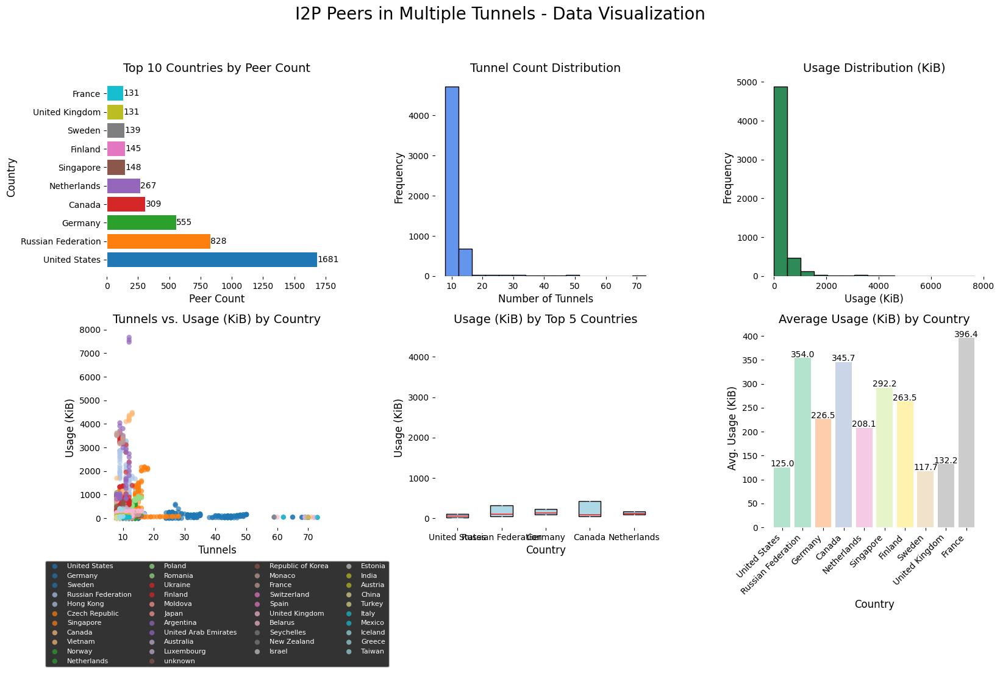

In [ ]:
# Step 1: Import packages and mount Google Drive
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from google.colab import drive
drive.mount('/content/drive')

# Step 2: Load the dataset
file_path = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/18.i2p_Peers in Multiple Tunnels.csv"
df = pd.read_csv(file_path)

# Step 3: Preprocess the data
def convert_usage_to_kib(usage_str):
    """Convert usage strings (e.g., '31KiB', '1.96MiB') to a float value in KiB."""
    usage_str = str(usage_str).strip()
    if usage_str.endswith("KiB"):
        return float(usage_str.replace("KiB", "").strip())
    elif usage_str.endswith("MiB"):
        return float(usage_str.replace("MiB", "").strip()) * 1024
    elif usage_str.endswith("GiB"):
        return float(usage_str.replace("GiB", "").strip()) * 1024 * 1024
    elif usage_str.endswith("B"):
        val = usage_str.replace("B", "").strip()
        return 0.0 if val in ["", "0"] else float(val) / 1024.0
    else:
        try:
            return float(usage_str)
        except:
            return np.nan

df['Usage_KiB'] = df['Usage'].apply(convert_usage_to_kib)
df['Tunnels'] = pd.to_numeric(df['Tunnels'], errors='coerce')

# Step 4: Prepare aggregated data
# Top 10 countries by peer count
top_countries = df['Country'].value_counts().head(10)
# Average usage (KiB) by country for the top 10 countries
avg_usage_by_country = df.groupby('Country')['Usage_KiB'].mean().loc[top_countries.index]
# For boxplot, select top 5 countries by peer count
top5_countries = df['Country'].value_counts().head(5).index.tolist()

# Step 5: Create the Consolidated Figure (2x3 grid, white background, landscape)
fig, axs = plt.subplots(2, 3, figsize=(16.5, 11.7), facecolor='white')
fig.suptitle("I2P Peers in Multiple Tunnels - Data Visualization", fontsize=20, color='black')

# Chart 1: Horizontal Bar Chart for Top 10 Countries by Peer Count
bars = axs[0, 0].barh(top_countries.index, top_countries.values,
                      color=plt.cm.tab10(np.linspace(0,1,len(top_countries))))
axs[0, 0].set_title("Top 10 Countries by Peer Count", fontsize=14, color='black')
axs[0, 0].set_xlabel("Peer Count", fontsize=12, color='black')
axs[0, 0].set_ylabel("Country", fontsize=12, color='black')
axs[0, 0].tick_params(axis='both', labelsize=10, colors='black')
axs[0, 0].set_facecolor('white')
for bar in bars:
    width = bar.get_width()
    axs[0, 0].text(width + 2, bar.get_y() + bar.get_height()/2, f'{int(width)}',
                   va='center', fontsize=10, color='black')

# Chart 2: Histogram of Tunnel Counts
axs[0, 1].hist(df['Tunnels'].dropna(), bins=15, color='cornflowerblue', edgecolor='black')
axs[0, 1].set_title("Tunnel Count Distribution", fontsize=14, color='black')
axs[0, 1].set_xlabel("Number of Tunnels", fontsize=12, color='black')
axs[0, 1].set_ylabel("Frequency", fontsize=12, color='black')
axs[0, 1].tick_params(axis='both', labelsize=10, colors='black')
axs[0, 1].set_facecolor('white')

# Chart 3: Histogram of Usage (KiB)
axs[0, 2].hist(df['Usage_KiB'].dropna(), bins=15, color='seagreen', edgecolor='black')
axs[0, 2].set_title("Usage Distribution (KiB)", fontsize=14, color='black')
axs[0, 2].set_xlabel("Usage (KiB)", fontsize=12, color='black')
axs[0, 2].set_ylabel("Frequency", fontsize=12, color='black')
axs[0, 2].tick_params(axis='both', labelsize=10, colors='black')
axs[0, 2].set_facecolor('white')

# Chart 4: Scatter Plot (Tunnels vs. Usage) Colored by Country
unique_countries = df['Country'].dropna().unique()
cmap = plt.cm.get_cmap('tab20', len(unique_countries))
for i, country in enumerate(unique_countries):
    subset = df[df['Country'] == country]
    axs[1, 0].scatter(subset['Tunnels'], subset['Usage_KiB'], color=cmap(i),
                      label=country, alpha=0.7, edgecolor='none')
axs[1, 0].set_title("Tunnels vs. Usage (KiB) by Country", fontsize=14, color='black')
axs[1, 0].set_xlabel("Tunnels", fontsize=12, color='black')
axs[1, 0].set_ylabel("Usage (KiB)", fontsize=12, color='black')
axs[1, 0].tick_params(axis='both', labelsize=10, colors='black')
axs[1, 0].set_facecolor('white')
# Adjust legend: 4 columns below the plot
handles, labels = axs[1, 0].get_legend_handles_labels()
axs[1, 0].legend(handles, labels, fontsize=8, ncol=4, loc='upper center',
                 bbox_to_anchor=(0.5, -0.15), frameon=True)

# Chart 5: Boxplot of Usage (KiB) for Top 5 Countries
data_box = [df[df['Country'] == country]['Usage_KiB'].dropna() for country in top5_countries]
axs[1, 1].boxplot(data_box, labels=top5_countries, patch_artist=True,
                  boxprops=dict(facecolor='lightblue', color='black'),
                  medianprops=dict(color='red'))
axs[1, 1].set_title("Usage (KiB) by Top 5 Countries", fontsize=14, color='black')
axs[1, 1].set_xlabel("Country", fontsize=12, color='black')
axs[1, 1].set_ylabel("Usage (KiB)", fontsize=12, color='black')
axs[1, 1].tick_params(axis='both', labelsize=10, colors='black')
axs[1, 1].set_facecolor('white')

# Chart 6: Bar Chart of Average Usage (KiB) by Country for Top 10
bars2 = axs[1, 2].bar(top_countries.index, avg_usage_by_country.values,
                      color=plt.cm.Pastel2(np.linspace(0,1,len(avg_usage_by_country))))
axs[1, 2].set_title("Average Usage (KiB) by Country", fontsize=14, color='black')
axs[1, 2].set_xlabel("Country", fontsize=12, color='black')
axs[1, 2].set_ylabel("Avg. Usage (KiB)", fontsize=12, color='black')
axs[1, 2].tick_params(axis='both', labelsize=10, colors='black')
axs[1, 2].set_facecolor('white')
plt.setp(axs[1, 2].get_xticklabels(), rotation=45, ha='right')
for bar in bars2:
    height = bar.get_height()
    axs[1, 2].text(bar.get_x() + bar.get_width()/2, height + 2, f'{height:.1f}',
                   ha='center', fontsize=10, color='black')

# Step 6: Final Adjustments and Save
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
fig.patch.set_facecolor('white')
fig.savefig("I2P_Peers_MultiTunnel_6Charts_Annotated_Landscape.pdf", format="pdf", dpi=300, facecolor='white')
print("Figure saved as 'I2P_Peers_MultiTunnel_6Charts_Annotated_Landscape.pdf' with 300 DPI.")
plt.show()


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<ipython-input-115-63b69dc2035a>:78: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab20', len(unique_countries))
<ipython-input-115-63b69dc2035a>:95: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  box = axs[1, 1].boxplot(data_box, labels=top5_countries, patch_artist=True,


Figure saved as 'I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf' with 300 DPI.


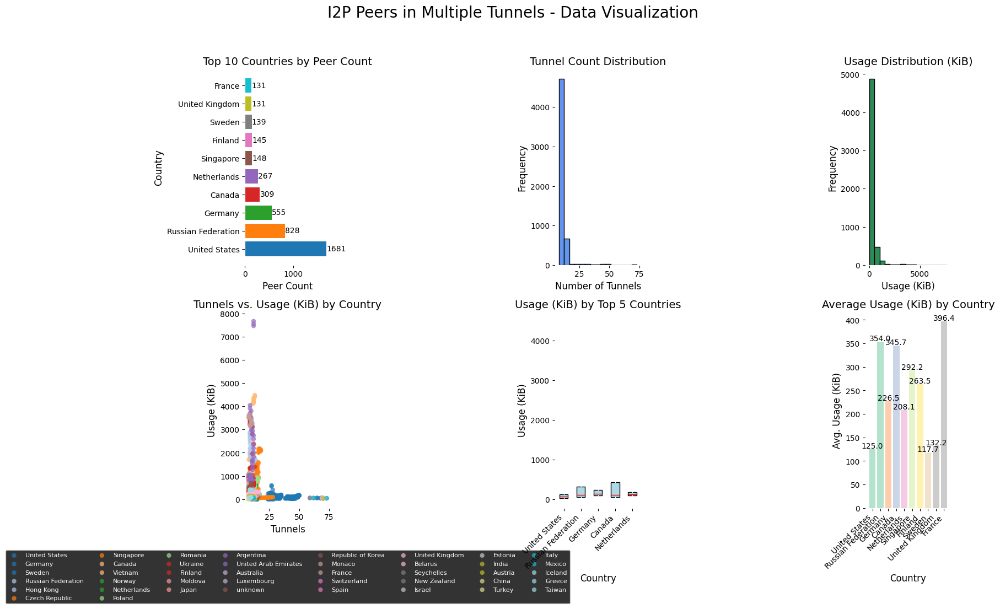

In [ ]:
# Step 1: Import packages and mount Google Drive
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import drive
drive.mount('/content/drive')

# Step 2: Load the dataset
file_path = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/18.i2p_Peers in Multiple Tunnels.csv"
df = pd.read_csv(file_path)

# Step 3: Preprocess the data
def convert_usage_to_kib(usage_str):
    usage_str = str(usage_str).strip()
    if usage_str.endswith("KiB"):
        return float(usage_str.replace("KiB", "").strip())
    elif usage_str.endswith("MiB"):
        return float(usage_str.replace("MiB", "").strip()) * 1024
    elif usage_str.endswith("GiB"):
        return float(usage_str.replace("GiB", "").strip()) * 1024 * 1024
    elif usage_str.endswith("B"):
        val = usage_str.replace("B", "").strip()
        try:
            return float(val) / 1024.0
        except:
            return np.nan
    else:
        try:
            return float(usage_str)
        except:
            return np.nan

df['Usage_KiB'] = df['Usage'].apply(convert_usage_to_kib)
df['Tunnels'] = pd.to_numeric(df['Tunnels'], errors='coerce')

# Step 4: Aggregate data
# Top 10 countries by peer count
top_countries = df['Country'].value_counts().head(10)
# Average usage (KiB) by country for top 10 countries
avg_usage_by_country = df.groupby('Country')['Usage_KiB'].mean().loc[top_countries.index]
# For the boxplot, select the top 5 countries by peer count
top5_countries = df['Country'].value_counts().head(5).index.tolist()

# Step 5: Create consolidated figure (2x3 grid, landscape, white background)
fig, axs = plt.subplots(2, 3, figsize=(16.5, 11.7), facecolor='white')
fig.suptitle("I2P Peers in Multiple Tunnels - Data Visualization", fontsize=20, color='black')

# Chart 1: Horizontal Bar Chart for Top 10 Countries by Peer Count
bars = axs[0, 0].barh(top_countries.index, top_countries.values, color=plt.cm.tab10(np.linspace(0, 1, len(top_countries))))
axs[0, 0].set_title("Top 10 Countries by Peer Count", fontsize=14, color='black')
axs[0, 0].set_xlabel("Peer Count", fontsize=12, color='black')
axs[0, 0].set_ylabel("Country", fontsize=12, color='black')
axs[0, 0].tick_params(axis='both', labelsize=10, colors='black')
axs[0, 0].set_facecolor('white')
for bar in bars:
    width = bar.get_width()
    axs[0, 0].text(width + 2, bar.get_y() + bar.get_height()/2, f'{int(width)}',
                   va='center', fontsize=10, color='black')

# Chart 2: Histogram of Tunnel Counts
axs[0, 1].hist(df['Tunnels'].dropna(), bins=15, color='cornflowerblue', edgecolor='black')
axs[0, 1].set_title("Tunnel Count Distribution", fontsize=14, color='black')
axs[0, 1].set_xlabel("Number of Tunnels", fontsize=12, color='black')
axs[0, 1].set_ylabel("Frequency", fontsize=12, color='black')
axs[0, 1].tick_params(axis='both', labelsize=10, colors='black')
axs[0, 1].set_facecolor('white')

# Chart 3: Histogram of Usage (KiB)
axs[0, 2].hist(df['Usage_KiB'].dropna(), bins=15, color='seagreen', edgecolor='black')
axs[0, 2].set_title("Usage Distribution (KiB)", fontsize=14, color='black')
axs[0, 2].set_xlabel("Usage (KiB)", fontsize=12, color='black')
axs[0, 2].set_ylabel("Frequency", fontsize=12, color='black')
axs[0, 2].tick_params(axis='both', labelsize=10, colors='black')
axs[0, 2].set_facecolor('white')

# Chart 4: Scatter Plot (Tunnels vs. Usage) Colored by Country
unique_countries = df['Country'].dropna().unique()
cmap = plt.cm.get_cmap('tab20', len(unique_countries))
for i, country in enumerate(unique_countries):
    subset = df[df['Country'] == country]
    axs[1, 0].scatter(subset['Tunnels'], subset['Usage_KiB'], color=cmap(i),
                      label=country, alpha=0.7, edgecolor='none')
axs[1, 0].set_title("Tunnels vs. Usage (KiB) by Country", fontsize=14, color='black')
axs[1, 0].set_xlabel("Tunnels", fontsize=12, color='black')
axs[1, 0].set_ylabel("Usage (KiB)", fontsize=12, color='black')
axs[1, 0].tick_params(axis='both', labelsize=10, colors='black')
axs[1, 0].set_facecolor('white')
# Place legend with 8 columns to spread out country labels
handles, labels = axs[1, 0].get_legend_handles_labels()
axs[1, 0].legend(handles, labels, fontsize=8, ncol=8,
                 loc='upper center', bbox_to_anchor=(0.5, -0.2), frameon=True)

# Chart 5: Boxplot of Usage (KiB) for Top 5 Countries
data_box = [df[df['Country'] == country]['Usage_KiB'].dropna() for country in top5_countries]
box = axs[1, 1].boxplot(data_box, labels=top5_countries, patch_artist=True,
                        boxprops=dict(facecolor='lightblue', color='black'),
                        medianprops=dict(color='red'))
axs[1, 1].set_title("Usage (KiB) by Top 5 Countries", fontsize=14, color='black')
axs[1, 1].set_xlabel("Country", fontsize=12, color='black')
axs[1, 1].set_ylabel("Usage (KiB)", fontsize=12, color='black')
axs[1, 1].tick_params(axis='both', labelsize=10, colors='black')
axs[1, 1].set_facecolor('white')
# Rotate x tick labels for clarity
plt.setp(axs[1, 1].get_xticklabels(), rotation=45, ha='right', fontsize=10)

# Chart 6: Bar Chart of Average Usage (KiB) by Country for Top 10 Countries
bars2 = axs[1, 2].bar(top_countries.index, avg_usage_by_country.values,
                      color=plt.cm.Pastel2(np.linspace(0, 1, len(avg_usage_by_country))))
axs[1, 2].set_title("Average Usage (KiB) by Country", fontsize=14, color='black')
axs[1, 2].set_xlabel("Country", fontsize=12, color='black')
axs[1, 2].set_ylabel("Avg. Usage (KiB)", fontsize=12, color='black')
axs[1, 2].tick_params(axis='both', labelsize=10, colors='black')
axs[1, 2].set_facecolor('white')
plt.setp(axs[1, 2].get_xticklabels(), rotation=45, ha='right', fontsize=10)
for bar in bars2:
    height = bar.get_height()
    axs[1, 2].text(bar.get_x() + bar.get_width()/2, height + 2, f'{height:.1f}',
                   ha='center', fontsize=10, color='black')

# Step 6: Final adjustments: ensure all elements are neat and export the figure in landscape (A4)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
fig.patch.set_facecolor('white')
fig.savefig("I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf", format="pdf", dpi=300, facecolor='white')
print("Figure saved as 'I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf' with 300 DPI.")
plt.show()


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<ipython-input-116-e5b4386f0d80>:72: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab20', len(unique_countries))
<ipython-input-116-e5b4386f0d80>:88: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axs[1, 1].boxplot(data_box, labels=top5_countries, patch_artist=True,


Figure saved as 'I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf' with 300 DPI.


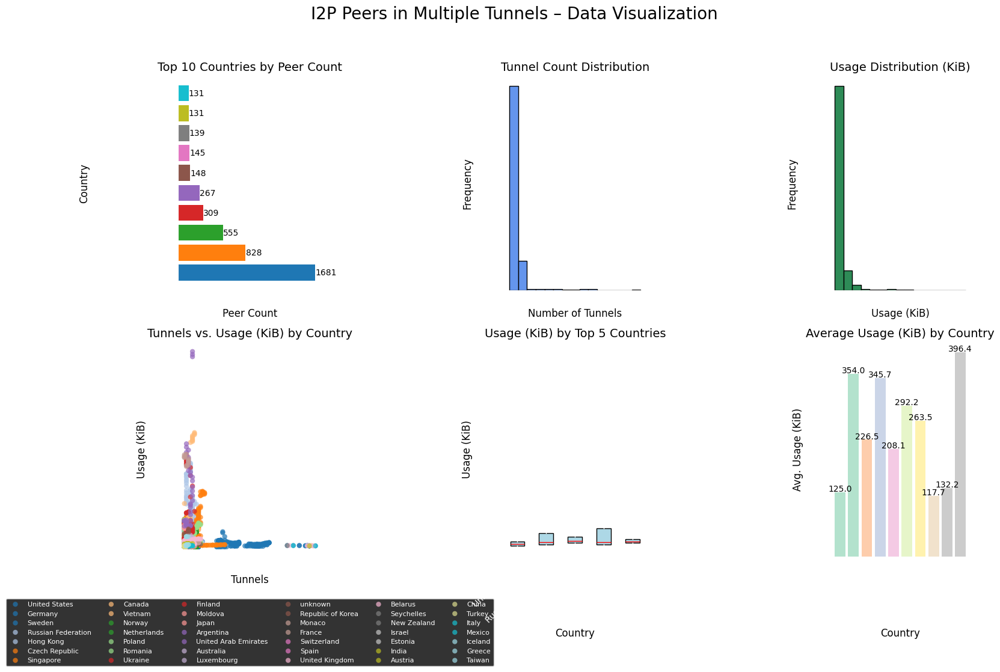

In [ ]:
# Step 1: Import packages and mount Google Drive
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import drive
drive.mount('/content/drive')

# Step 2: Load the dataset
file_path = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/18.i2p_Peers in Multiple Tunnels.csv"
df = pd.read_csv(file_path)

# Step 3: Preprocess the data
def convert_usage_to_kib(usage_str):
    usage_str = str(usage_str).strip()
    if usage_str.endswith("KiB"):
        return float(usage_str.replace("KiB", "").strip())
    elif usage_str.endswith("MiB"):
        return float(usage_str.replace("MiB", "").strip()) * 1024
    elif usage_str.endswith("GiB"):
        return float(usage_str.replace("GiB", "").strip()) * 1024 * 1024
    elif usage_str.endswith("B"):
        val = usage_str.replace("B", "").strip()
        try:
            return float(val) / 1024.0
        except:
            return np.nan
    else:
        try:
            return float(usage_str)
        except:
            return np.nan

df['Usage_KiB'] = df['Usage'].apply(convert_usage_to_kib)
df['Tunnels'] = pd.to_numeric(df['Tunnels'], errors='coerce')

# Step 4: Aggregate data for charts
top_countries = df['Country'].value_counts().head(10)
avg_usage_by_country = df.groupby('Country')['Usage_KiB'].mean().loc[top_countries.index]
top5_countries = df['Country'].value_counts().head(5).index.tolist()

# Step 5: Create consolidated figure (2x3 grid, A4 landscape, white background)
fig, axs = plt.subplots(2, 3, figsize=(16.5, 11.7), facecolor='white')
fig.suptitle("I2P Peers in Multiple Tunnels – Data Visualization", fontsize=20, color='black')

# Chart 1: Horizontal Bar Chart for Top 10 Countries by Peer Count
bars = axs[0, 0].barh(top_countries.index, top_countries.values, color=plt.cm.tab10(np.linspace(0, 1, len(top_countries))))
axs[0, 0].set_title("Top 10 Countries by Peer Count", fontsize=14, color='black')
axs[0, 0].set_xlabel("Peer Count", fontsize=12, color='black')
axs[0, 0].set_ylabel("Country", fontsize=12, color='black')
for bar in bars:
    width = bar.get_width()
    axs[0, 0].text(width + 2, bar.get_y() + bar.get_height()/2, f'{int(width)}',
                   va='center', fontsize=10, color='black')
axs[0, 0].set_facecolor('white')

# Chart 2: Histogram of Tunnel Counts
axs[0, 1].hist(df['Tunnels'].dropna(), bins=15, color='cornflowerblue', edgecolor='black')
axs[0, 1].set_title("Tunnel Count Distribution", fontsize=14, color='black')
axs[0, 1].set_xlabel("Number of Tunnels", fontsize=12, color='black')
axs[0, 1].set_ylabel("Frequency", fontsize=12, color='black')
axs[0, 1].set_facecolor('white')

# Chart 3: Histogram of Usage (KiB)
axs[0, 2].hist(df['Usage_KiB'].dropna(), bins=15, color='seagreen', edgecolor='black')
axs[0, 2].set_title("Usage Distribution (KiB)", fontsize=14, color='black')
axs[0, 2].set_xlabel("Usage (KiB)", fontsize=12, color='black')
axs[0, 2].set_ylabel("Frequency", fontsize=12, color='black')
axs[0, 2].set_facecolor('white')

# Chart 4: Scatter Plot (Tunnels vs. Usage) Colored by Country
unique_countries = df['Country'].dropna().unique()
cmap = plt.cm.get_cmap('tab20', len(unique_countries))
for i, country in enumerate(unique_countries):
    subset = df[df['Country'] == country]
    axs[1, 0].scatter(subset['Tunnels'], subset['Usage_KiB'], color=cmap(i),
                      label=country, alpha=0.7, edgecolor='none')
axs[1, 0].set_title("Tunnels vs. Usage (KiB) by Country", fontsize=14, color='black')
axs[1, 0].set_xlabel("Tunnels", fontsize=12, color='black')
axs[1, 0].set_ylabel("Usage (KiB)", fontsize=12, color='black')
axs[1, 0].set_facecolor('white')
# Legend arranged in 6 columns
handles, labels = axs[1, 0].get_legend_handles_labels()
axs[1, 0].legend(handles, labels, fontsize=8, ncol=6,
                 loc='upper center', bbox_to_anchor=(0.5, -0.18), frameon=True)

# Chart 5: Boxplot of Usage (KiB) for Top 5 Countries
data_box = [df[df['Country'] == country]['Usage_KiB'].dropna() for country in top5_countries]
axs[1, 1].boxplot(data_box, labels=top5_countries, patch_artist=True,
                  boxprops=dict(facecolor='lightblue', color='black'),
                  medianprops=dict(color='red'))
axs[1, 1].set_title("Usage (KiB) by Top 5 Countries", fontsize=14, color='black')
axs[1, 1].set_xlabel("Country", fontsize=12, color='black')
axs[1, 1].set_ylabel("Usage (KiB)", fontsize=12, color='black')
plt.setp(axs[1, 1].get_xticklabels(), rotation=45, ha='right', fontsize=10)
axs[1, 1].set_facecolor('white')

# Chart 6: Bar Chart of Average Usage (KiB) by Country for Top 10 Countries
bars2 = axs[1, 2].bar(top_countries.index, avg_usage_by_country.values,
                      color=plt.cm.Pastel2(np.linspace(0, 1, len(avg_usage_by_country))))
axs[1, 2].set_title("Average Usage (KiB) by Country", fontsize=14, color='black')
axs[1, 2].set_xlabel("Country", fontsize=12, color='black')
axs[1, 2].set_ylabel("Avg. Usage (KiB)", fontsize=12, color='black')
plt.setp(axs[1, 2].get_xticklabels(), rotation=45, ha='right', fontsize=10)
for bar in bars2:
    height = bar.get_height()
    axs[1, 2].text(bar.get_x() + bar.get_width()/2, height + 2, f'{height:.1f}',
                   ha='center', fontsize=10, color='black')
axs[1, 2].set_facecolor('white')

# Step 6: Final adjustments – minimize white space and save as an A4 landscape PDF
plt.tight_layout(rect=[0.02, 0.02, 0.98, 0.95])
fig.patch.set_facecolor('white')
fig.savefig("I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf", format="pdf", dpi=300, facecolor='white')
print("Figure saved as 'I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf' with 300 DPI.")
plt.show()


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<ipython-input-117-f187e32e321c>:72: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab20', len(unique_countries))
<ipython-input-117-f187e32e321c>:88: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axs[1, 1].boxplot(data_box, labels=top5_countries, patch_artist=True,


Figure saved as 'I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf' with 300 DPI.


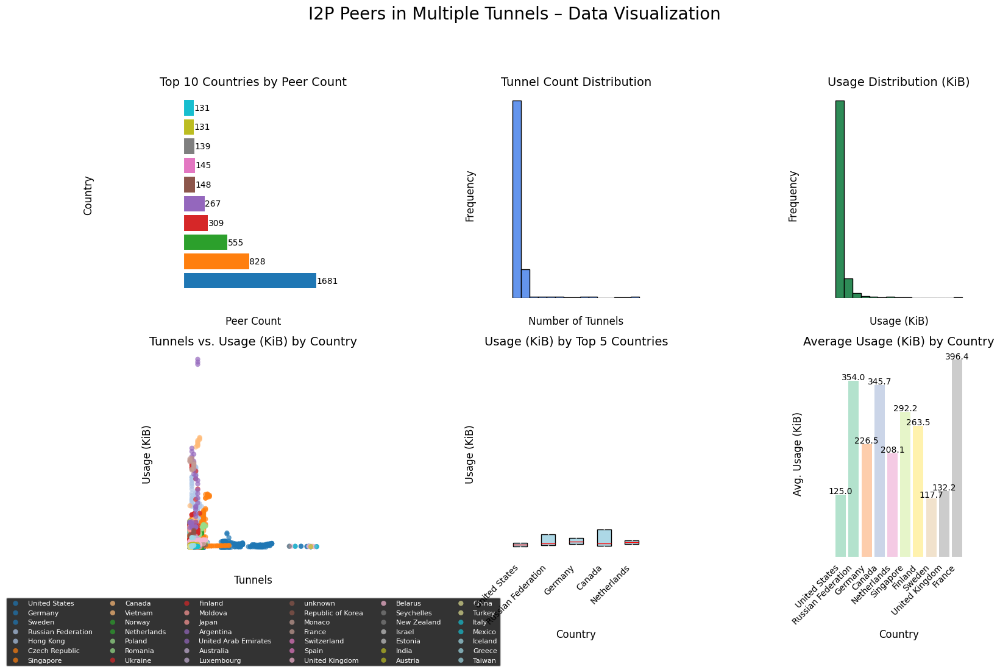

In [ ]:
# Step 1: Import packages and mount Google Drive
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import drive
drive.mount('/content/drive')

# Step 2: Load the dataset
file_path = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/18.i2p_Peers in Multiple Tunnels.csv"
df = pd.read_csv(file_path)

# Step 3: Preprocess the data
def convert_usage_to_kib(usage_str):
    usage_str = str(usage_str).strip()
    if usage_str.endswith("KiB"):
        return float(usage_str.replace("KiB", "").strip())
    elif usage_str.endswith("MiB"):
        return float(usage_str.replace("MiB", "").strip()) * 1024
    elif usage_str.endswith("GiB"):
        return float(usage_str.replace("GiB", "").strip()) * 1024 * 1024
    elif usage_str.endswith("B"):
        val = usage_str.replace("B", "").strip()
        try:
            return float(val) / 1024.0
        except:
            return np.nan
    else:
        try:
            return float(usage_str)
        except:
            return np.nan

df['Usage_KiB'] = df['Usage'].apply(convert_usage_to_kib)
df['Tunnels'] = pd.to_numeric(df['Tunnels'], errors='coerce')

# Step 4: Aggregate data for charts
top_countries = df['Country'].value_counts().head(10)
avg_usage_by_country = df.groupby('Country')['Usage_KiB'].mean().loc[top_countries.index]
top5_countries = df['Country'].value_counts().head(5).index.tolist()

# Step 5: Create consolidated figure (2x3 grid, A4 landscape, white background)
fig, axs = plt.subplots(2, 3, figsize=(16.5, 11.7), facecolor='white')
fig.suptitle("I2P Peers in Multiple Tunnels – Data Visualization", fontsize=20, color='black')

# Chart 1: Horizontal Bar Chart for Top 10 Countries by Peer Count
bars = axs[0, 0].barh(top_countries.index, top_countries.values, color=plt.cm.tab10(np.linspace(0, 1, len(top_countries))))
axs[0, 0].set_title("Top 10 Countries by Peer Count", fontsize=14, color='black')
axs[0, 0].set_xlabel("Peer Count", fontsize=12, color='black')
axs[0, 0].set_ylabel("Country", fontsize=12, color='black')
for bar in bars:
    width = bar.get_width()
    axs[0, 0].text(width + 2, bar.get_y() + bar.get_height()/2, f'{int(width)}',
                   va='center', fontsize=10, color='black')
axs[0, 0].set_facecolor('white')

# Chart 2: Histogram of Tunnel Counts
axs[0, 1].hist(df['Tunnels'].dropna(), bins=15, color='cornflowerblue', edgecolor='black')
axs[0, 1].set_title("Tunnel Count Distribution", fontsize=14, color='black')
axs[0, 1].set_xlabel("Number of Tunnels", fontsize=12, color='black')
axs[0, 1].set_ylabel("Frequency", fontsize=12, color='black')
axs[0, 1].set_facecolor('white')

# Chart 3: Histogram of Usage (KiB)
axs[0, 2].hist(df['Usage_KiB'].dropna(), bins=15, color='seagreen', edgecolor='black')
axs[0, 2].set_title("Usage Distribution (KiB)", fontsize=14, color='black')
axs[0, 2].set_xlabel("Usage (KiB)", fontsize=12, color='black')
axs[0, 2].set_ylabel("Frequency", fontsize=12, color='black')
axs[0, 2].set_facecolor('white')

# Chart 4: Scatter Plot (Tunnels vs. Usage) Colored by Country
unique_countries = df['Country'].dropna().unique()
cmap = plt.cm.get_cmap('tab20', len(unique_countries))
for i, country in enumerate(unique_countries):
    subset = df[df['Country'] == country]
    axs[1, 0].scatter(subset['Tunnels'], subset['Usage_KiB'], color=cmap(i),
                      label=country, alpha=0.7, edgecolor='none')
axs[1, 0].set_title("Tunnels vs. Usage (KiB) by Country", fontsize=14, color='black')
axs[1, 0].set_xlabel("Tunnels", fontsize=12, color='black')
axs[1, 0].set_ylabel("Usage (KiB)", fontsize=12, color='black')
axs[1, 0].set_facecolor('white')
# Arrange legend in 6 columns
handles, labels = axs[1, 0].get_legend_handles_labels()
axs[1, 0].legend(handles, labels, fontsize=8, ncol=6,
                 loc='upper center', bbox_to_anchor=(0.5, -0.18), frameon=True)

# Chart 5: Boxplot of Usage (KiB) for Top 5 Countries
data_box = [df[df['Country'] == country]['Usage_KiB'].dropna() for country in top5_countries]
axs[1, 1].boxplot(data_box, labels=top5_countries, patch_artist=True,
                  boxprops=dict(facecolor='lightblue', color='black'),
                  medianprops=dict(color='red'))
axs[1, 1].set_title("Usage (KiB) by Top 5 Countries", fontsize=14, color='black')
axs[1, 1].set_xlabel("Country", fontsize=12, color='black')
axs[1, 1].set_ylabel("Usage (KiB)", fontsize=12, color='black')
plt.setp(axs[1, 1].get_xticklabels(), rotation=45, ha='right', fontsize=10, color='black')
axs[1, 1].set_facecolor('white')

# Chart 6: Bar Chart of Average Usage (KiB) by Country for Top 10 Countries
bars2 = axs[1, 2].bar(top_countries.index, avg_usage_by_country.values,
                      color=plt.cm.Pastel2(np.linspace(0, 1, len(avg_usage_by_country))))
axs[1, 2].set_title("Average Usage (KiB) by Country", fontsize=14, color='black')
axs[1, 2].set_xlabel("Country", fontsize=12, color='black')
axs[1, 2].set_ylabel("Avg. Usage (KiB)", fontsize=12, color='black')
plt.setp(axs[1, 2].get_xticklabels(), rotation=45, ha='right', fontsize=10, color='black')
for bar in bars2:
    height = bar.get_height()
    axs[1, 2].text(bar.get_x() + bar.get_width()/2, height + 2, f'{height:.1f}',
                   ha='center', fontsize=10, color='black')
axs[1, 2].set_facecolor('white')

# Step 6: Final adjustments – reduce whitespace and fill the page
plt.tight_layout(rect=[0.03, 0.03, 0.97, 0.93])
fig.patch.set_facecolor('white')
fig.savefig("I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf", format="pdf", dpi=300, facecolor='white')
print("Figure saved as 'I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf' with 300 DPI.")
plt.show()


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


<ipython-input-118-f187e32e321c>:72: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab20', len(unique_countries))
<ipython-input-118-f187e32e321c>:88: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axs[1, 1].boxplot(data_box, labels=top5_countries, patch_artist=True,


Figure saved as 'I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf' with 300 DPI.


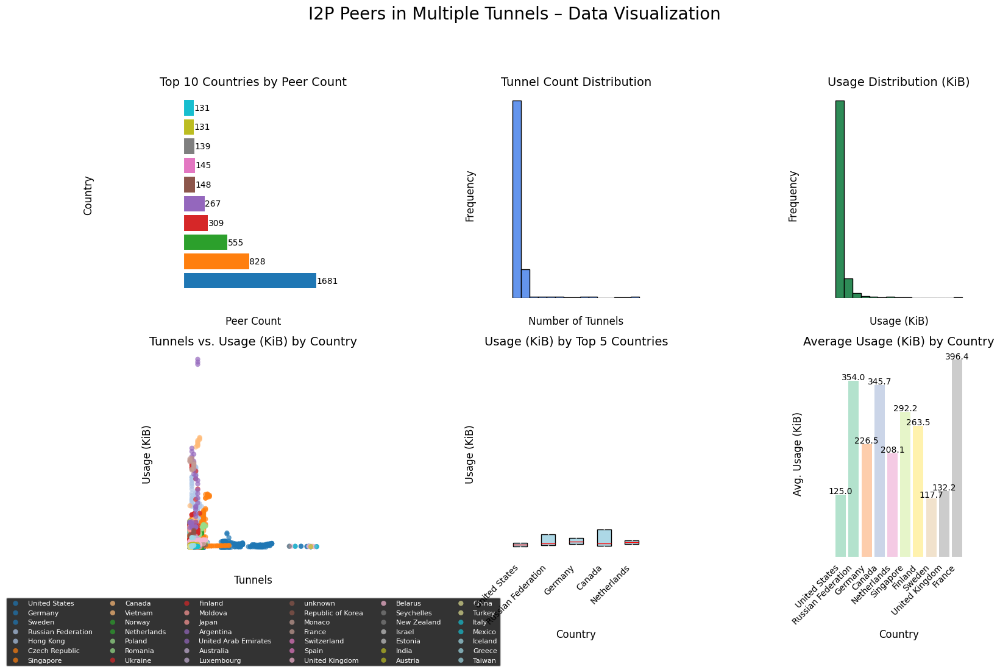

In [ ]:
# Step 1: Import packages and mount Google Drive
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import drive
drive.mount('/content/drive')

# Step 2: Load the dataset
file_path = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/18.i2p_Peers in Multiple Tunnels.csv"
df = pd.read_csv(file_path)

# Step 3: Preprocess the data
def convert_usage_to_kib(usage_str):
    usage_str = str(usage_str).strip()
    if usage_str.endswith("KiB"):
        return float(usage_str.replace("KiB", "").strip())
    elif usage_str.endswith("MiB"):
        return float(usage_str.replace("MiB", "").strip()) * 1024
    elif usage_str.endswith("GiB"):
        return float(usage_str.replace("GiB", "").strip()) * 1024 * 1024
    elif usage_str.endswith("B"):
        val = usage_str.replace("B", "").strip()
        try:
            return float(val) / 1024.0
        except:
            return np.nan
    else:
        try:
            return float(usage_str)
        except:
            return np.nan

df['Usage_KiB'] = df['Usage'].apply(convert_usage_to_kib)
df['Tunnels'] = pd.to_numeric(df['Tunnels'], errors='coerce')

# Step 4: Aggregate data for charts
top_countries = df['Country'].value_counts().head(10)
avg_usage_by_country = df.groupby('Country')['Usage_KiB'].mean().loc[top_countries.index]
top5_countries = df['Country'].value_counts().head(5).index.tolist()

# Step 5: Create consolidated figure (2x3 grid, A4 landscape, white background)
fig, axs = plt.subplots(2, 3, figsize=(16.5, 11.7), facecolor='white')
fig.suptitle("I2P Peers in Multiple Tunnels – Data Visualization", fontsize=20, color='black')

# Chart 1: Horizontal Bar Chart for Top 10 Countries by Peer Count
bars = axs[0, 0].barh(top_countries.index, top_countries.values, color=plt.cm.tab10(np.linspace(0, 1, len(top_countries))))
axs[0, 0].set_title("Top 10 Countries by Peer Count", fontsize=14, color='black')
axs[0, 0].set_xlabel("Peer Count", fontsize=12, color='black')
axs[0, 0].set_ylabel("Country", fontsize=12, color='black')
for bar in bars:
    width = bar.get_width()
    axs[0, 0].text(width + 2, bar.get_y() + bar.get_height()/2, f'{int(width)}',
                   va='center', fontsize=10, color='black')
axs[0, 0].set_facecolor('white')

# Chart 2: Histogram of Tunnel Counts
axs[0, 1].hist(df['Tunnels'].dropna(), bins=15, color='cornflowerblue', edgecolor='black')
axs[0, 1].set_title("Tunnel Count Distribution", fontsize=14, color='black')
axs[0, 1].set_xlabel("Number of Tunnels", fontsize=12, color='black')
axs[0, 1].set_ylabel("Frequency", fontsize=12, color='black')
axs[0, 1].set_facecolor('white')

# Chart 3: Histogram of Usage (KiB)
axs[0, 2].hist(df['Usage_KiB'].dropna(), bins=15, color='seagreen', edgecolor='black')
axs[0, 2].set_title("Usage Distribution (KiB)", fontsize=14, color='black')
axs[0, 2].set_xlabel("Usage (KiB)", fontsize=12, color='black')
axs[0, 2].set_ylabel("Frequency", fontsize=12, color='black')
axs[0, 2].set_facecolor('white')

# Chart 4: Scatter Plot (Tunnels vs. Usage) Colored by Country
unique_countries = df['Country'].dropna().unique()
cmap = plt.cm.get_cmap('tab20', len(unique_countries))
for i, country in enumerate(unique_countries):
    subset = df[df['Country'] == country]
    axs[1, 0].scatter(subset['Tunnels'], subset['Usage_KiB'], color=cmap(i),
                      label=country, alpha=0.7, edgecolor='none')
axs[1, 0].set_title("Tunnels vs. Usage (KiB) by Country", fontsize=14, color='black')
axs[1, 0].set_xlabel("Tunnels", fontsize=12, color='black')
axs[1, 0].set_ylabel("Usage (KiB)", fontsize=12, color='black')
axs[1, 0].set_facecolor('white')
# Arrange legend in 6 columns
handles, labels = axs[1, 0].get_legend_handles_labels()
axs[1, 0].legend(handles, labels, fontsize=8, ncol=6,
                 loc='upper center', bbox_to_anchor=(0.5, -0.18), frameon=True)

# Chart 5: Boxplot of Usage (KiB) for Top 5 Countries
data_box = [df[df['Country'] == country]['Usage_KiB'].dropna() for country in top5_countries]
axs[1, 1].boxplot(data_box, labels=top5_countries, patch_artist=True,
                  boxprops=dict(facecolor='lightblue', color='black'),
                  medianprops=dict(color='red'))
axs[1, 1].set_title("Usage (KiB) by Top 5 Countries", fontsize=14, color='black')
axs[1, 1].set_xlabel("Country", fontsize=12, color='black')
axs[1, 1].set_ylabel("Usage (KiB)", fontsize=12, color='black')
plt.setp(axs[1, 1].get_xticklabels(), rotation=45, ha='right', fontsize=10, color='black')
axs[1, 1].set_facecolor('white')

# Chart 6: Bar Chart of Average Usage (KiB) by Country for Top 10 Countries
bars2 = axs[1, 2].bar(top_countries.index, avg_usage_by_country.values,
                      color=plt.cm.Pastel2(np.linspace(0, 1, len(avg_usage_by_country))))
axs[1, 2].set_title("Average Usage (KiB) by Country", fontsize=14, color='black')
axs[1, 2].set_xlabel("Country", fontsize=12, color='black')
axs[1, 2].set_ylabel("Avg. Usage (KiB)", fontsize=12, color='black')
plt.setp(axs[1, 2].get_xticklabels(), rotation=45, ha='right', fontsize=10, color='black')
for bar in bars2:
    height = bar.get_height()
    axs[1, 2].text(bar.get_x() + bar.get_width()/2, height + 2, f'{height:.1f}',
                   ha='center', fontsize=10, color='black')
axs[1, 2].set_facecolor('white')

# Step 6: Final adjustments – reduce whitespace and fill the page
plt.tight_layout(rect=[0.03, 0.03, 0.97, 0.93])
fig.patch.set_facecolor('white')
fig.savefig("I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf", format="pdf", dpi=300, facecolor='white')
print("Figure saved as 'I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf' with 300 DPI.")
plt.show()


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import drive

# Mount your Google Drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Load the CSV file from your Google Drive
file_path = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/18.i2p_Peers in Multiple Tunnels.csv"
df = pd.read_csv(file_path)

# Define a function to convert usage strings (e.g., "31KiB", "1.96MiB") to KiB as float
def convert_usage_to_kib(usage_str):
    usage_str = str(usage_str).strip()
    if usage_str.endswith("KiB"):
        return float(usage_str.replace("KiB", "").strip())
    elif usage_str.endswith("MiB"):
        return float(usage_str.replace("MiB", "").strip()) * 1024
    elif usage_str.endswith("GiB"):
        return float(usage_str.replace("GiB", "").strip()) * 1024 * 1024
    elif usage_str.endswith("B"):
        try:
            return float(usage_str.replace("B", "").strip()) / 1024.0
        except:
            return np.nan
    else:
        try:
            return float(usage_str)
        except:
            return np.nan

df['Usage_KiB'] = df['Usage'].apply(convert_usage_to_kib)
df['Tunnels'] = pd.to_numeric(df['Tunnels'], errors='coerce')


In [ ]:
# Determine the top 10 countries by peer count
top_countries = df['Country'].value_counts().head(10)

# Calculate the average usage (in KiB) for these top 10 countries
avg_usage_by_country = df.groupby('Country')['Usage_KiB'].mean().loc[top_countries.index]

# Also, get the top 5 countries for the boxplot
top5_countries = df['Country'].value_counts().head(5).index.tolist()


<ipython-input-122-5e0edc907322>:32: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab20', len(unique_countries))
<ipython-input-122-5e0edc907322>:48: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axs[1, 1].boxplot(data_box, labels=top5_countries, patch_artist=True,


Figure saved as 'I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf' with 300 DPI.


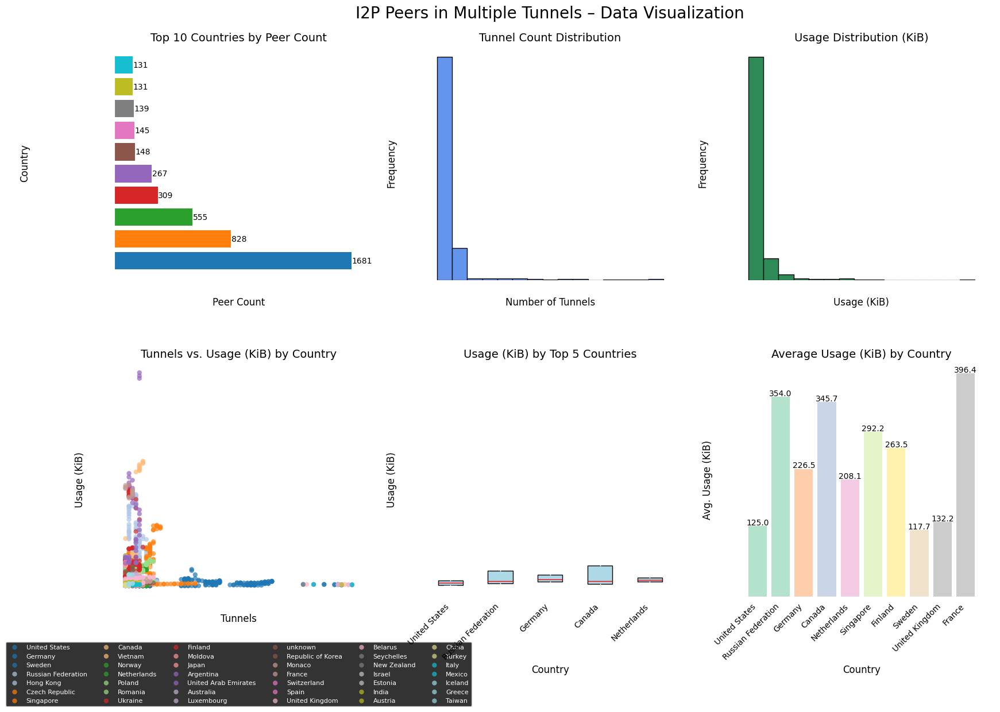

In [ ]:
# Create a 2x3 grid on an A4 landscape page (16.5 x 11.7 inches)
fig, axs = plt.subplots(2, 3, figsize=(16.5, 11.7), facecolor='white')
fig.suptitle("I2P Peers in Multiple Tunnels – Data Visualization", fontsize=20, color='black')

# Chart 1: Horizontal Bar Chart for Top 10 Countries by Peer Count
bars = axs[0, 0].barh(top_countries.index, top_countries.values, color=plt.cm.tab10(np.linspace(0, 1, len(top_countries))))
axs[0, 0].set_title("Top 10 Countries by Peer Count", fontsize=14, color='black')
axs[0, 0].set_xlabel("Peer Count", fontsize=12, color='black')
axs[0, 0].set_ylabel("Country", fontsize=12, color='black')
for bar in bars:
    width = bar.get_width()
    axs[0, 0].text(width + 2, bar.get_y() + bar.get_height()/2, f'{int(width)}',
                   va='center', fontsize=10, color='black')
axs[0, 0].set_facecolor('white')

# Chart 2: Histogram of Tunnel Counts
axs[0, 1].hist(df['Tunnels'].dropna(), bins=15, color='cornflowerblue', edgecolor='black')
axs[0, 1].set_title("Tunnel Count Distribution", fontsize=14, color='black')
axs[0, 1].set_xlabel("Number of Tunnels", fontsize=12, color='black')
axs[0, 1].set_ylabel("Frequency", fontsize=12, color='black')
axs[0, 1].set_facecolor('white')

# Chart 3: Histogram of Usage (KiB)
axs[0, 2].hist(df['Usage_KiB'].dropna(), bins=15, color='seagreen', edgecolor='black')
axs[0, 2].set_title("Usage Distribution (KiB)", fontsize=14, color='black')
axs[0, 2].set_xlabel("Usage (KiB)", fontsize=12, color='black')
axs[0, 2].set_ylabel("Frequency", fontsize=12, color='black')
axs[0, 2].set_facecolor('white')

# Chart 4: Scatter Plot (Tunnels vs. Usage) Colored by Country
unique_countries = df['Country'].dropna().unique()
cmap = plt.cm.get_cmap('tab20', len(unique_countries))
for i, country in enumerate(unique_countries):
    subset = df[df['Country'] == country]
    axs[1, 0].scatter(subset['Tunnels'], subset['Usage_KiB'], color=cmap(i),
                      label=country, alpha=0.7, edgecolor='none')
axs[1, 0].set_title("Tunnels vs. Usage (KiB) by Country", fontsize=14, color='black')
axs[1, 0].set_xlabel("Tunnels", fontsize=12, color='black')
axs[1, 0].set_ylabel("Usage (KiB)", fontsize=12, color='black')
axs[1, 0].set_facecolor('white')
# Arrange legend in 6 columns at the bottom of the subplot
handles, labels = axs[1, 0].get_legend_handles_labels()
axs[1, 0].legend(handles, labels, fontsize=8, ncol=6,
                 loc='upper center', bbox_to_anchor=(0.5, -0.18), frameon=True)

# Chart 5: Boxplot of Usage (KiB) for Top 5 Countries
data_box = [df[df['Country'] == country]['Usage_KiB'].dropna() for country in top5_countries]
axs[1, 1].boxplot(data_box, labels=top5_countries, patch_artist=True,
                  boxprops=dict(facecolor='lightblue', color='black'),
                  medianprops=dict(color='red'))
axs[1, 1].set_title("Usage (KiB) by Top 5 Countries", fontsize=14, color='black')
axs[1, 1].set_xlabel("Country", fontsize=12, color='black')
axs[1, 1].set_ylabel("Usage (KiB)", fontsize=12, color='black')
plt.setp(axs[1, 1].get_xticklabels(), rotation=45, ha='right', fontsize=10, color='black')
axs[1, 1].set_facecolor('white')

# Chart 6: Bar Chart of Average Usage (KiB) by Country for Top 10 Countries
bars2 = axs[1, 2].bar(top_countries.index, avg_usage_by_country.values,
                      color=plt.cm.Pastel2(np.linspace(0, 1, len(avg_usage_by_country))))
axs[1, 2].set_title("Average Usage (KiB) by Country", fontsize=14, color='black')
axs[1, 2].set_xlabel("Country", fontsize=12, color='black')
axs[1, 2].set_ylabel("Avg. Usage (KiB)", fontsize=12, color='black')
plt.setp(axs[1, 2].get_xticklabels(), rotation=45, ha='right', fontsize=10, color='black')
for bar in bars2:
    height = bar.get_height()
    axs[1, 2].text(bar.get_x() + bar.get_width()/2, height + 2, f'{height:.1f}',
                   ha='center', fontsize=10, color='black')
axs[1, 2].set_facecolor('white')

# Final adjustments: Reduce white space and ensure charts fill the A4 page in landscape
plt.subplots_adjust(left=0.04, right=0.96, top=0.92, bottom=0.10, wspace=0.25, hspace=0.35)
fig.patch.set_facecolor('white')

# Save the figure as a high-quality PDF
output_file = "I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf"
fig.savefig(output_file, format="pdf", dpi=300, facecolor='white')
print(f"Figure saved as '{output_file}' with 300 DPI.")

plt.show()


In [ ]:
# Step 1: Import packages and mount Google Drive
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Step 2: Load the dataset
file_path = "/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/18.i2p_Peers in Multiple Tunnels.csv"
df = pd.read_csv(file_path)


In [ ]:
# Step 3: Preprocess the data
def convert_usage_to_kib(usage_str):
    usage_str = str(usage_str).strip()
    if usage_str.endswith("KiB"):
        return float(usage_str.replace("KiB", "").strip())
    elif usage_str.endswith("MiB"):
        return float(usage_str.replace("MiB", "").strip()) * 1024
    elif usage_str.endswith("GiB"):
        return float(usage_str.replace("GiB", "").strip()) * 1024 * 1024
    elif usage_str.endswith("B"):
        val = usage_str.replace("B", "").strip()
        try:
            return float(val) / 1024.0
        except:
            return np.nan
    else:
        try:
            return float(usage_str)
        except:
            return np.nan

df['Usage_KiB'] = df['Usage'].apply(convert_usage_to_kib)
df['Tunnels'] = pd.to_numeric(df['Tunnels'], errors='coerce')


In [ ]:
# Step 4: Aggregate data for visualization
# Top 10 countries by peer count
top_countries = df['Country'].value_counts().head(10)
# Average usage (KiB) by country for top 10 countries
avg_usage_by_country = df.groupby('Country')['Usage_KiB'].mean().loc[top_countries.index]
# For the boxplot, select the top 5 countries by peer count
top5_countries = df['Country'].value_counts().head(5).index.tolist()


<ipython-input-127-f4b4a479ba9c>:35: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('tab20', len(unique_countries))
<ipython-input-127-f4b4a479ba9c>:52: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axs[1, 1].boxplot(data_box, labels=top5_countries, patch_artist=True,


Figure saved as 'I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf' with 300 DPI.


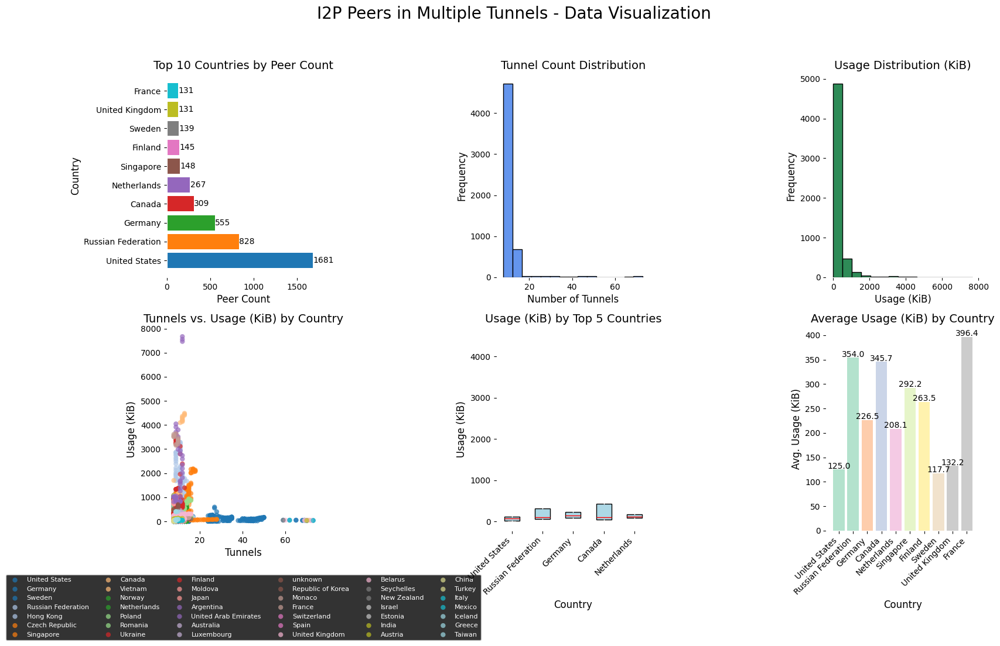

In [ ]:
# Step 5: Create consolidated figure (2x3 grid, landscape, white background)
fig, axs = plt.subplots(2, 3, figsize=(16.5, 11.7), facecolor='white')
fig.suptitle("I2P Peers in Multiple Tunnels - Data Visualization", fontsize=20, color='black')

# Chart 1: Horizontal Bar Chart for Top 10 Countries by Peer Count
bars = axs[0, 0].barh(top_countries.index, top_countries.values, color=plt.cm.tab10(np.linspace(0, 1, len(top_countries))))
axs[0, 0].set_title("Top 10 Countries by Peer Count", fontsize=14, color='black')
axs[0, 0].set_xlabel("Peer Count", fontsize=12, color='black')
axs[0, 0].set_ylabel("Country", fontsize=12, color='black')
axs[0, 0].tick_params(axis='both', labelsize=10, colors='black')
axs[0, 0].set_facecolor('white')
for bar in bars:
    width = bar.get_width()
    axs[0, 0].text(width + 2, bar.get_y() + bar.get_height()/2, f'{int(width)}',
                   va='center', fontsize=10, color='black')

# Chart 2: Histogram of Tunnel Counts
axs[0, 1].hist(df['Tunnels'].dropna(), bins=15, color='cornflowerblue', edgecolor='black')
axs[0, 1].set_title("Tunnel Count Distribution", fontsize=14, color='black')
axs[0, 1].set_xlabel("Number of Tunnels", fontsize=12, color='black')
axs[0, 1].set_ylabel("Frequency", fontsize=12, color='black')
axs[0, 1].tick_params(axis='both', labelsize=10, colors='black')
axs[0, 1].set_facecolor('white')

# Chart 3: Histogram of Usage (KiB)
axs[0, 2].hist(df['Usage_KiB'].dropna(), bins=15, color='seagreen', edgecolor='black')
axs[0, 2].set_title("Usage Distribution (KiB)", fontsize=14, color='black')
axs[0, 2].set_xlabel("Usage (KiB)", fontsize=12, color='black')
axs[0, 2].set_ylabel("Frequency", fontsize=12, color='black')
axs[0, 2].tick_params(axis='both', labelsize=10, colors='black')
axs[0, 2].set_facecolor('white')

# Chart 4: Scatter Plot (Tunnels vs. Usage) Colored by Country
unique_countries = df['Country'].dropna().unique()
cmap = plt.cm.get_cmap('tab20', len(unique_countries))
for i, country in enumerate(unique_countries):
    subset = df[df['Country'] == country]
    axs[1, 0].scatter(subset['Tunnels'], subset['Usage_KiB'], color=cmap(i),
                      label=country, alpha=0.7, edgecolor='none')
axs[1, 0].set_title("Tunnels vs. Usage (KiB) by Country", fontsize=14, color='black')
axs[1, 0].set_xlabel("Tunnels", fontsize=12, color='black')
axs[1, 0].set_ylabel("Usage (KiB)", fontsize=12, color='black')
axs[1, 0].tick_params(axis='both', labelsize=10, colors='black')
axs[1, 0].set_facecolor('white')
# Arrange legend with 6 columns at the bottom of the subplot
handles, labels = axs[1, 0].get_legend_handles_labels()
axs[1, 0].legend(handles, labels, fontsize=8, ncol=6,
                 loc='upper center', bbox_to_anchor=(0.5, -0.2), frameon=True)

# Chart 5: Boxplot of Usage (KiB) for Top 5 Countries
data_box = [df[df['Country'] == country]['Usage_KiB'].dropna() for country in top5_countries]
axs[1, 1].boxplot(data_box, labels=top5_countries, patch_artist=True,
                  boxprops=dict(facecolor='lightblue', color='black'),
                  medianprops=dict(color='red'))
axs[1, 1].set_title("Usage (KiB) by Top 5 Countries", fontsize=14, color='black')
axs[1, 1].set_xlabel("Country", fontsize=12, color='black')
axs[1, 1].set_ylabel("Usage (KiB)", fontsize=12, color='black')
axs[1, 1].tick_params(axis='both', labelsize=10, colors='black')
axs[1, 1].set_facecolor('white')
plt.setp(axs[1, 1].get_xticklabels(), rotation=45, ha='right', fontsize=10, color='black')

# Chart 6: Bar Chart of Average Usage (KiB) by Country for Top 10 Countries
bars2 = axs[1, 2].bar(top_countries.index, avg_usage_by_country.values,
                      color=plt.cm.Pastel2(np.linspace(0, 1, len(avg_usage_by_country))))
axs[1, 2].set_title("Average Usage (KiB) by Country", fontsize=14, color='black')
axs[1, 2].set_xlabel("Country", fontsize=12, color='black')
axs[1, 2].set_ylabel("Avg. Usage (KiB)", fontsize=12, color='black')
axs[1, 2].tick_params(axis='both', labelsize=10, colors='black')
axs[1, 2].set_facecolor('white')
plt.setp(axs[1, 2].get_xticklabels(), rotation=45, ha='right', fontsize=10, color='black')
for bar in bars2:
    height = bar.get_height()
    axs[1, 2].text(bar.get_x() + bar.get_width()/2, height + 2, f'{height:.1f}',
                   ha='center', fontsize=10, color='black')

# Step 6: Final adjustments: ensure all elements are neat and export the figure in landscape (A4)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
fig.patch.set_facecolor('white')
fig.savefig("I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf", format="pdf", dpi=300, facecolor='white')
print("Figure saved as 'I2P_Peers_MultiTunnel_Consolidated_Landscape.pdf' with 300 DPI.")
plt.show()


Network Graph

In [ ]:
# Step 1: Install dependencies
!pip install pandas networkx plotly scikit-learn tqdm

# Step 2: Load data
import pandas as pd
import networkx as nx
import plotly.graph_objects as go
from sklearn.preprocessing import LabelEncoder
from tqdm import tqdm

# Load your file (adjust path to your file)
file_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/network_data.csv'
df = pd.read_csv(file_path)

# Step 3: Build graph
G = nx.DiGraph()
for _, row in tqdm(df.iterrows(), total=len(df)):
    src = row['Src IP']
    dst = row['Dst IP']
    proto = row['Proto']
    size = row['PacketSize(Bytes)']

    if G.has_edge(src, dst):
        G[src][dst]['weight'] += size
        G[src][dst]['count'] += 1
    else:
        G.add_edge(src, dst, protocol=proto, weight=size, count=1)

# Step 4: Visualize using Plotly
pos = nx.spring_layout(G, k=0.15, iterations=20)

edge_x, edge_y, weights = [], [], []
for edge in G.edges():
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_x += [x0, x1, None]
    edge_y += [y0, y1, None]
    weights.append(G[edge[0]][edge[1]]['weight'])

edge_trace = go.Scatter(
    x=edge_x, y=edge_y,
    line=dict(width=0.5, color='#888'),
    hoverinfo='none',
    mode='lines')

node_x, node_y, node_text = [], [], []
for node in G.nodes():
    x, y = pos[node]
    node_x.append(x)
    node_y.append(y)
    node_text.append(node)

node_trace = go.Scatter(
    x=node_x, y=node_y,
    mode='markers+text',
    textposition="top center",
    hoverinfo='text',
    marker=dict(
        showscale=True,
        colorscale='YlGnBu',
        color=[G.degree(n) for n in G.nodes()],
        size=10,
        colorbar=dict(
            thickness=15,
            title='Node Degree',
            xanchor='left',
            titleside='right'
        ),
        line_width=2),
    text=node_text
)

fig = go.Figure(data=[edge_trace, node_trace],
             layout=go.Layout(
                title='<br>Traffic Network Graph',
                titlefont_size=16,
                showlegend=False,
                hovermode='closest',
                margin=dict(b=20,l=5,r=5,t=40),
                xaxis=dict(showgrid=False, zeroline=False),
                yaxis=dict(showgrid=False, zeroline=False))
)

fig.show()


100%|██████████| 49/49 [00:00<00:00, 3602.85it/s]


In [ ]:
# Step 1: Install dependencies
!pip install pandas networkx plotly scikit-learn tqdm

# Step 2: Load data
import pandas as pd
import networkx as nx
import plotly.graph_objects as go
from sklearn.preprocessing import LabelEncoder
from tqdm import tqdm

# Load your file (adjust path to your file)
file_path = '/content/drive/MyDrive/SAWRMi2p - data in Brief - Elsevier/7-i2pmetadata-4-17-25-final-cleaned.csv'
df = pd.read_csv(file_path)

# Step 3: Build graph
G = nx.DiGraph()
for _, row in tqdm(df.iterrows(), total=len(df)):
    src = row['Src IP']
    dst = row['Dst IP']
    proto = row['Proto']
    size = row['PacketSize(Bytes)']

    if G.has_edge(src, dst):
        G[src][dst]['weight'] += size
        G[src][dst]['count'] += 1
    else:
        G.add_edge(src, dst, protocol=proto, weight=size, count=1)

# Step 4: Visualize using Plotly
pos = nx.spring_layout(G, k=0.15, iterations=20)

edge_x, edge_y, weights = [], [], []
for edge in G.edges():
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_x += [x0, x1, None]
    edge_y += [y0, y1, None]
    weights.append(G[edge[0]][edge[1]]['weight'])

edge_trace = go.Scatter(
    x=edge_x, y=edge_y,
    line=dict(width=0.5, color='#888'),
    hoverinfo='none',
    mode='lines')

node_x, node_y = [], []
for node in G.nodes():
    x, y = pos[node]
    node_x.append(x)
    node_y.append(y)

node_trace = go.Scatter(
    x=node_x, y=node_y,
    mode='markers',
    hoverinfo='skip',
    marker=dict(
        showscale=True,
        colorscale='YlGnBu',
        color=[G.degree(n) for n in G.nodes()],
        size=10,
        colorbar=dict(
            thickness=15,
            title='Node Degree',
            xanchor='left',
            titleside='right'
        ),
        line_width=2),
)

fig = go.Figure(data=[edge_trace, node_trace],
             layout=go.Layout(
                title='<br>Traffic Network Graph (No Labels)',
                titlefont_size=16,
                showlegend=False,
                hovermode='closest',
                margin=dict(b=20, l=5, r=5, t=40),
                xaxis=dict(showgrid=False, zeroline=False),
                yaxis=dict(showgrid=False, zeroline=False))
)

fig.show()


<ipython-input-3-554a66541325>:13: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

100%|██████████| 4222793/4222793 [04:13<00:00, 16667.44it/s]
